In [1]:
# Import all the necessary Library 
import torchvision
import torch.utils.data as utils
from torchvision import datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader,Dataset
from torch.autograd import Variable
import matplotlib.pyplot as plt
import torchvision.utils
import numpy as np
import time
import copy
from torch.optim import lr_scheduler
import os
from PIL import Image
import torch
from torch.autograd import Variable
import PIL.ImageOps    
import torch.nn as nn
from torch import optim
import torch.nn.functional as F
import pandas as pd 

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
def imshow(img,text=None,should_save=False):
    npimg = img.numpy()
    plt.axis("off")
    if text:
        plt.text(75, 8, text, style='italic',fontweight='bold',
            bbox={'facecolor':'white', 'alpha':0.8, 'pad':10})
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()    

def show_plot(iteration,loss):
    plt.plot(iteration,loss)
    plt.show()

In [5]:
# First, look at everything.
from subprocess import check_output
print(check_output(["ls", "/content/drive/MyDrive/bu_son_olsun"]).decode("utf8"))

test
test_data.csv
train
train_data.csv



In [6]:
class Config():
    training_dir = "/content/drive/MyDrive/bu_son_olsun/train"
    testing_dir = "/content/drive/MyDrive/bu_son_olsun/test"
    train_batch_size = 32
    train_number_epochs = 20

In [7]:
training_dir="/content/drive/MyDrive/bu_son_olsun/train"
training_csv="/content/drive/MyDrive/bu_son_olsun/train_data.csv"
testing_csv="/content/drive/MyDrive/bu_son_olsun/test_data.csv"
testing_dir="/content/drive/MyDrive/bu_son_olsun/test"

In [8]:
class SiameseNetworkDataset():
    
    def __init__(self,training_csv=None,training_dir=None,transform=None):
        # used to prepare the labels and images path
        self.training_df=pd.read_csv(training_csv)
        self.training_df.columns =["image1","image2","label"]
        self.training_dir = training_dir    
        self.transform = transform

    def __getitem__(self,index):
        
        # getting the image path
        image1_path=os.path.join(self.training_dir,self.training_df.iat[index,0])
        image2_path=os.path.join(self.training_dir,self.training_df.iat[index,1])
        
        image_list= [image1_path,image2_path]
        
        # Loading the image
        img0 = Image.open(image1_path)
        img1 = Image.open(image2_path)
        img0 = img0.convert("L")
        img1 = img1.convert("L")
        
        # Apply image transformations
        if self.transform is not None:
            img0 = self.transform(img0)
            img1 = self.transform(img1)
        
        return img0, img1 , torch.from_numpy(np.array([int(self.training_df.iat[index,2])],dtype=np.float32)),image_list
    
    def __len__(self):
        return len(self.training_df)

In [9]:
# Load the the dataset from raw image folders
siamese_dataset = SiameseNetworkDataset(training_csv,training_dir,
                                        transform=transforms.Compose([transforms.Resize((105,105)),
                                                                      transforms.ToTensor()
                                                                      ])
                                       )

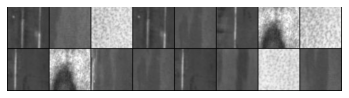

[[0.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]
 [1.]]


In [10]:
# Viewing the sample of images and to check whether its loading properly
vis_dataloader = DataLoader(siamese_dataset,
                        shuffle=True,
                        batch_size=8)
dataiter = iter(vis_dataloader)


example_batch = next(dataiter)
concatenated = torch.cat((example_batch[0],example_batch[1]),0)
imshow(torchvision.utils.make_grid(concatenated))
print(example_batch[2].numpy())

In [11]:
class SiameseNetwork(nn.Module):
    def __init__(self):
        super(SiameseNetwork, self).__init__()
        
        # Setting up the Sequential of CNN Layers
        self.cnn1 = nn.Sequential(
            
            nn.Conv2d(1, 96, kernel_size=11,stride=1),
            nn.ReLU(inplace=True),
            nn.LocalResponseNorm(5,alpha=0.0001,beta=0.75,k=2),
            nn.MaxPool2d(3, stride=2),
            
            nn.Conv2d(96, 256, kernel_size=5,stride=1,padding=2),
            nn.ReLU(inplace=True),
            nn.LocalResponseNorm(5,alpha=0.0001,beta=0.75,k=2),
            nn.MaxPool2d(3, stride=2),
            nn.Dropout2d(p=0.3),

            nn.Conv2d(256,384 , kernel_size=3,stride=1,padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(384,256 , kernel_size=3,stride=1,padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(3, stride=2),
            nn.Dropout2d(p=0.3),

        )
        
        # Defining the fully connected layers
        self.fc1 = nn.Sequential(
            nn.Linear(30976, 1024),
            nn.ReLU(inplace=True),
            nn.Dropout2d(p=0.5),
            
            nn.Linear(1024, 128),
            nn.ReLU(inplace=True),
            
            nn.Linear(128,2))
        
  
  
    def forward_once(self, x):
        # Forward pass 
        output = self.cnn1(x)
        output = output.view(output.size()[0], -1)
        output = self.fc1(output)
        return output

    def forward(self, input1, input2):
        # forward pass of input 1
        output1 = self.forward_once(input1)
        # forward pass of input 2
        output2 = self.forward_once(input2)
        return output1, output2 

In [12]:
class ContrastiveLoss(torch.nn.Module):
    """
    Contrastive loss function.
    Based on: http://yann.lecun.com/exdb/publis/pdf/hadsell-chopra-lecun-06.pdf
    """

    def __init__(self, margin=2.0):
        super(ContrastiveLoss, self).__init__()
        self.margin = margin

    def forward(self, output1, output2, label):
        euclidean_distance = F.pairwise_distance(output1, output2)
        loss_contrastive = torch.mean((1-label) * torch.pow(euclidean_distance, 2) +
                                      (label) * torch.pow(torch.clamp(self.margin - euclidean_distance, min=0.0), 2))


        return loss_contrastive

In [13]:
# Load the dataset as pytorch tensors using dataloader
train_dataloader = DataLoader(siamese_dataset,
                        shuffle=True,
                        num_workers=8,
                        batch_size=Config.train_batch_size)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [14]:
# Check whether you have GPU is loaded or not
if torch.cuda.is_available():
    print('Yes')

Yes


In [15]:
# Declare Siamese Network
net = SiameseNetwork()
# Decalre Loss Function
criterion = ContrastiveLoss()
# Declare Optimizer
optimizer = optim.RMSprop(net.parameters(), lr=1e-4, alpha=0.99, eps=1e-8, weight_decay=0.0005, momentum=0.9)

In [16]:
# Declare Siamese Network
net = SiameseNetwork().cuda()
# Decalre Loss Function
criterion = ContrastiveLoss()
# Declare Optimizer
optimizer = optim.RMSprop(net.parameters(), lr=1e-4, alpha=0.99, eps=1e-8, weight_decay=0.0005, momentum=0.9)

In [17]:
def train():
    counter = []
    loss_history = [] 
    iteration_number= 0
    
    for epoch in range(0,Config.train_number_epochs):
        for i, data in enumerate(train_dataloader,0):
            img0, img1 , label, _ = data
            img0, img1 , label = img0.cuda(), img1.cuda() , label.cuda()
            optimizer.zero_grad()
            output1,output2 = net(img0,img1)
            loss_contrastive = criterion(output1,output2,label)
            loss_contrastive.backward()
            optimizer.step()
            if i %50 == 0 :
                print("Epoch number {}\n Current loss {}\n".format(epoch,loss_contrastive.item()))
                iteration_number +=10
                counter.append(iteration_number)
                loss_history.append(loss_contrastive.item())
    return net

In [18]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [19]:
# Train the model
model = train()
torch.save(model.state_dict(), "model.pt")
print("Model Saved Successfully")

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch number 0
 Current loss 3.240839719772339

Epoch number 0
 Current loss 1.9798582792282104

Epoch number 0
 Current loss 1.521730661392212

Epoch number 0
 Current loss 2.130591630935669

Epoch number 1
 Current loss 1.373194932937622

Epoch number 1
 Current loss 1.2114871740341187

Epoch number 1
 Current loss 1.0424249172210693

Epoch number 1
 Current loss 1.316473126411438

Epoch number 2
 Current loss 1.0694031715393066

Epoch number 2
 Current loss 1.119600534439087

Epoch number 2
 Current loss 1.2831671237945557

Epoch number 2
 Current loss 1.5758681297302246

Epoch number 3
 Current loss 1.2909249067306519

Epoch number 3
 Current loss 0.9859744906425476

Epoch number 3
 Current loss 1.1889755725860596

Epoch number 3
 Current loss 1.3921186923980713

Epoch number 4
 Current loss 1.104720115661621

Epoch number 4
 Current loss 1.669095516204834

Epoch number 4
 Current loss 1.290585994720459

Epoch number 4
 Current loss 1.4248454570770264

Epoch number 5
 Current loss 

In [20]:
# Load the saved model
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = SiameseNetwork().to(device)
model.load_state_dict(torch.load("model.pt"))

<All keys matched successfully>

In [21]:
# Load the test dataset
test_dataset = SiameseNetworkDataset(training_csv=testing_csv,training_dir=testing_dir,
                                        transform=transforms.Compose([transforms.Resize((105,105)),
                                                                      transforms.ToTensor()
                                                                      ])
                                       )

test_dataloader = DataLoader(test_dataset,num_workers=6,batch_size=1,shuffle=True)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [22]:
import os
def fn():     
    file_list=os.listdir(r"/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png")
    print (file_list)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 6 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_1.png',)]
/
_


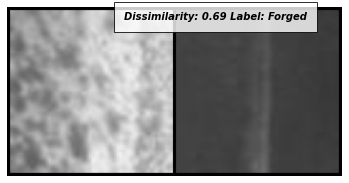

1 / 1
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_1.png',)]
/
_


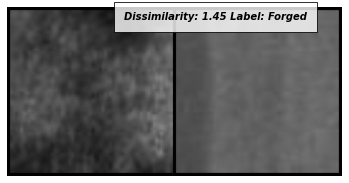

2 / 2
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_2.png',)]
/
_


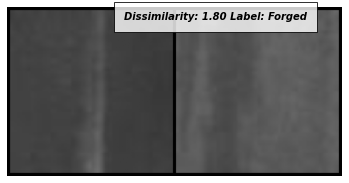

3 / 3
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_5.png',)]
/
_


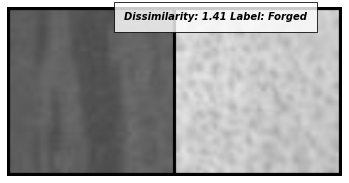

4 / 4
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_3.png',)]
/
_


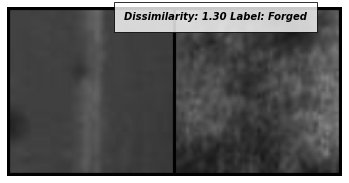

5 / 5
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',)]
/
/


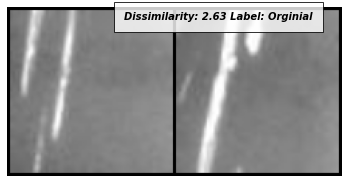

6 / 6
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_3.png',)]
/
_


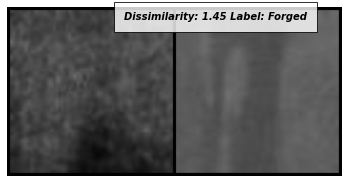

7 / 7
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_1.png',)]
/
_


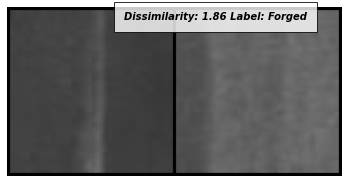

8 / 8
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_3.png',)]
/
_


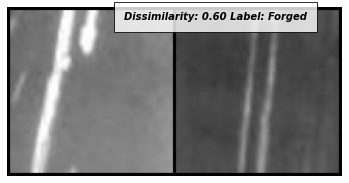

9 / 9
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',)]
/
/


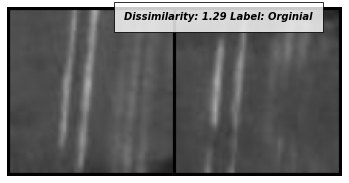

10 / 10
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_2.png',)]
/
_


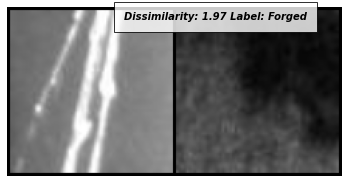

11 / 11
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_4.png',)]
/
_


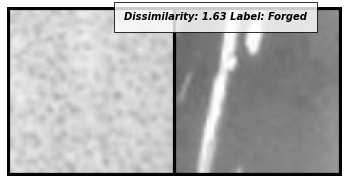

12 / 12
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_5.png',)]
/
_


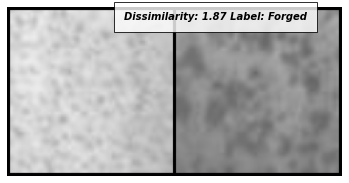

13 / 13
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_3.png',)]
/
_


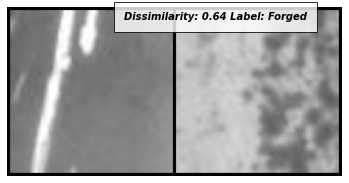

14 / 14
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_2.png',)]
/
_


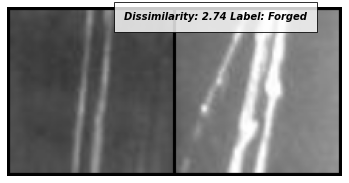

15 / 15
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',)]
/
/


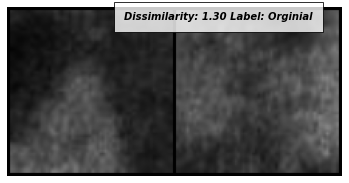

16 / 16
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_4.png',)]
/
_


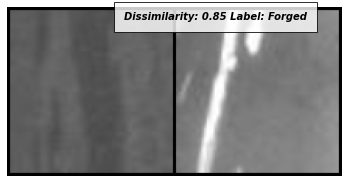

17 / 17
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_3.png',)]
/
_


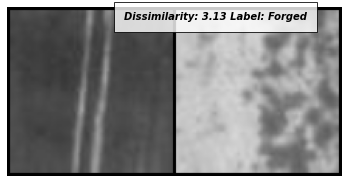

18 / 18
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_3.png',)]
/
_


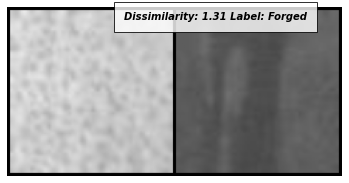

19 / 19
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_3.png',)]
/
_


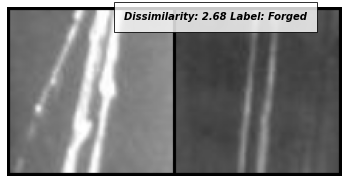

20 / 20
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_4.png',)]
/
_


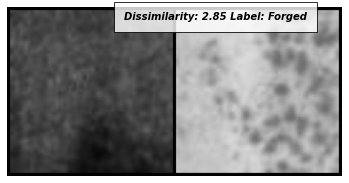

21 / 21
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_4.png',)]
/
_


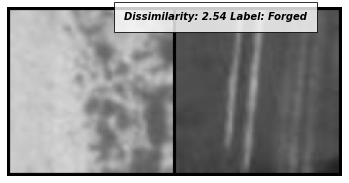

22 / 22
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_1.png',)]
/
_


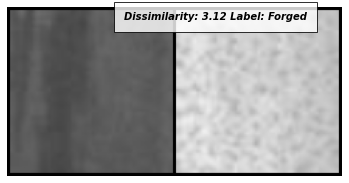

23 / 23
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_4.png',)]
/
_


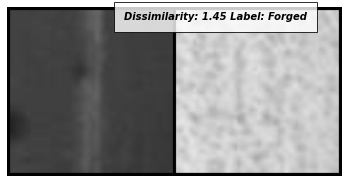

24 / 24
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_4.png',)]
/
_


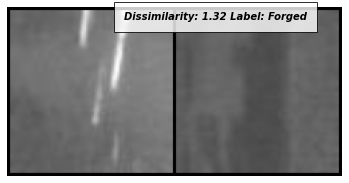

25 / 25
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_2.png',)]
/
_


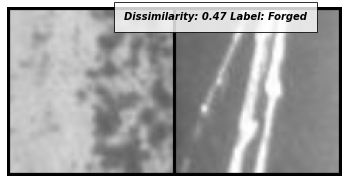

26 / 26
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_5.png',)]
/
_


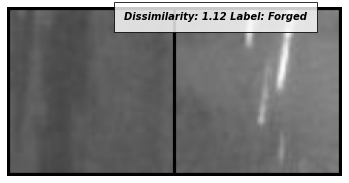

27 / 27
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_3.png',)]
/
_


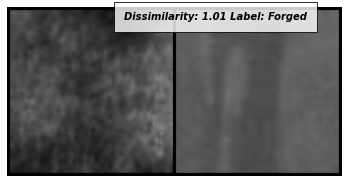

28 / 28
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_1.png',)]
/
_


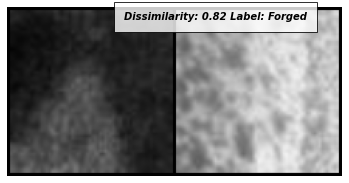

29 / 29
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_3.png',)]
/
_


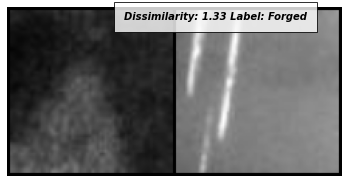

30 / 30
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_5.png',)]
/
_


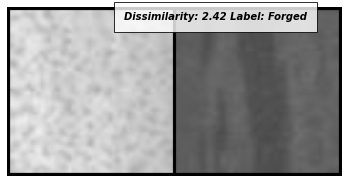

31 / 31
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_3.png',)]
/
_


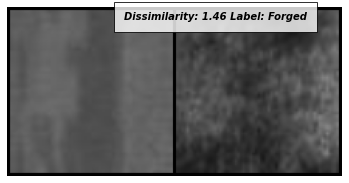

32 / 32
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_3.png',)]
/
_


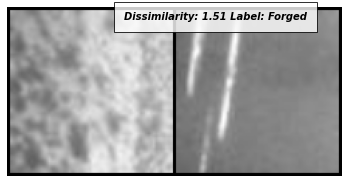

33 / 33
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_1.png',)]
/
_


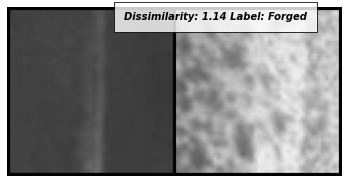

34 / 34
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_4.png',)]
/
_


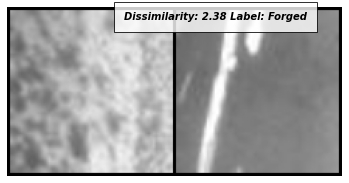

35 / 35
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',)]
/
/


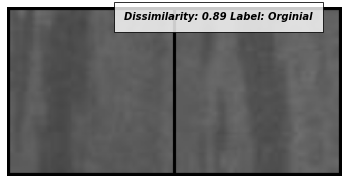

36 / 36
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',)]
/
/


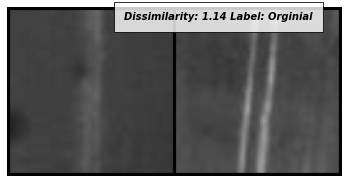

37 / 37
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_3.png',)]
/
_


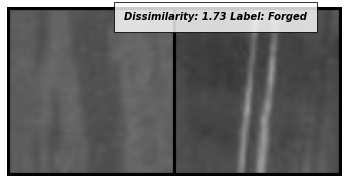

38 / 38
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_4.png',)]
/
_


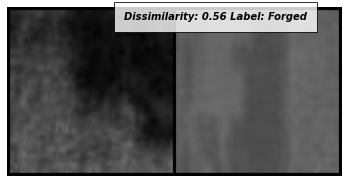

39 / 39
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_2.png',)]
/
_


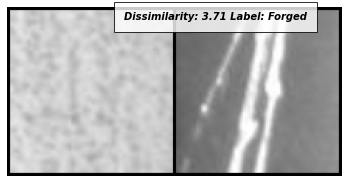

40 / 40
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_4.png',)]
/
_


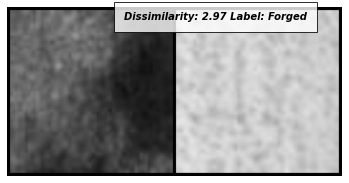

41 / 41
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',)]
/
/


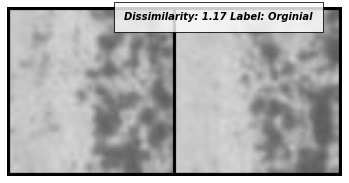

42 / 42
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_1.png',)]
/
_


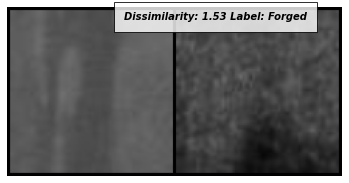

43 / 43
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_4.png',)]
/
_


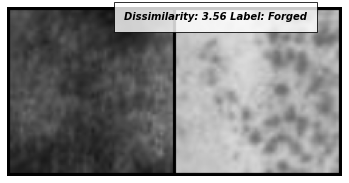

44 / 44
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_5.png',)]
/
_


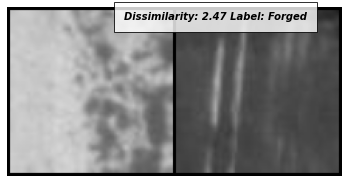

45 / 45
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',)]
/
/


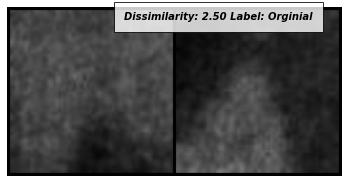

46 / 46
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_1.png',)]
/
_


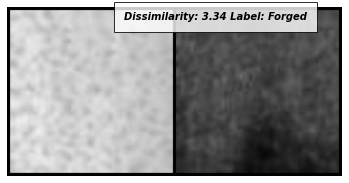

47 / 47
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_5.png',)]
/
_


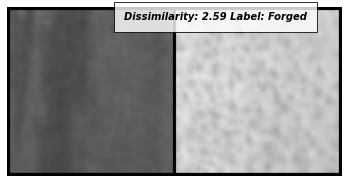

48 / 48
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_5.png',)]
/
_


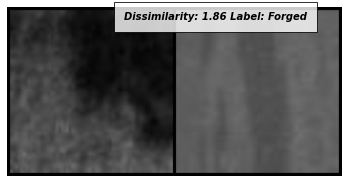

49 / 49
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_2.png',)]
/
_


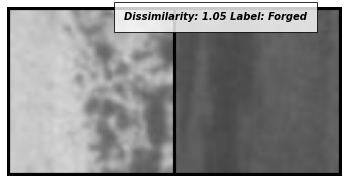

50 / 50
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_3.png',)]
/
_


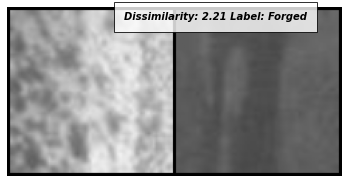

51 / 51
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',)]
/
/


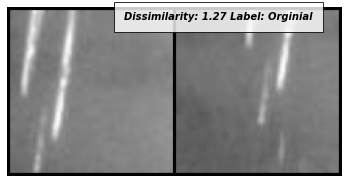

52 / 52
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_1.png',)]
/
_


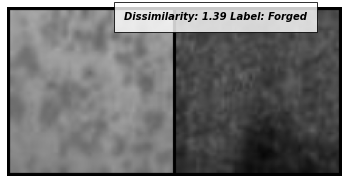

53 / 53
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_2.png',)]
/
_


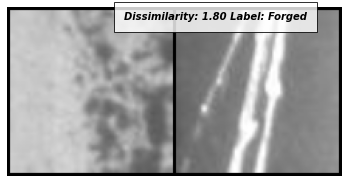

54 / 54
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_5.png',)]
/
_


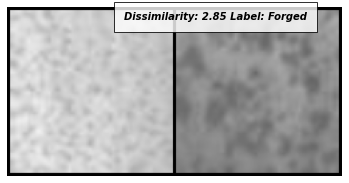

55 / 55
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_5.png',)]
/
_


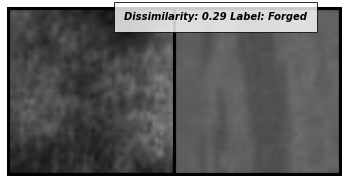

56 / 56
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_4.png',)]
/
_


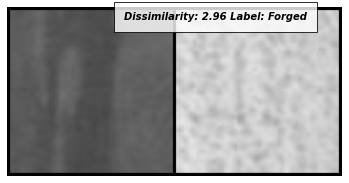

57 / 57
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',)]
/
/


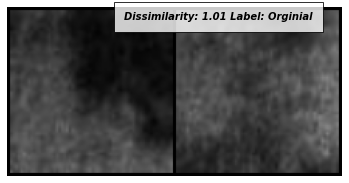

58 / 58
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_2.png',)]
/
_


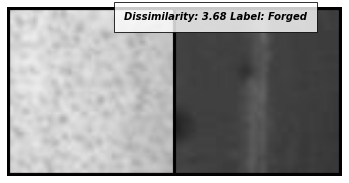

59 / 59
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_1.png',)]
/
_


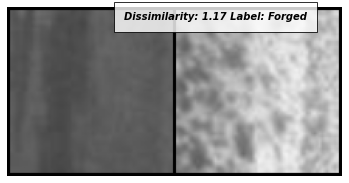

60 / 60
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_3.png',)]
/
_


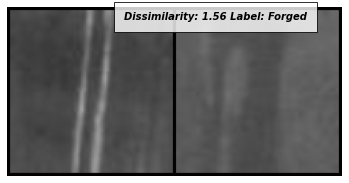

61 / 61
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_2.png',)]
/
_


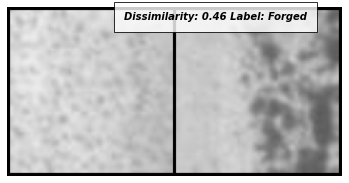

62 / 62
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_5.png',)]
/
_


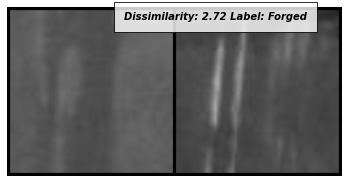

63 / 63
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_3.png',)]
/
_


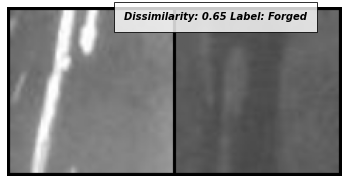

64 / 64
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_1.png',)]
/
_


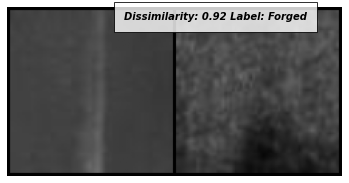

65 / 65
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_1.png',)]
/
_


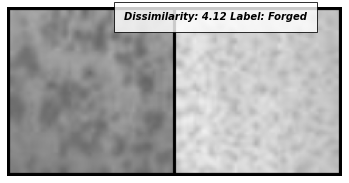

66 / 66
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_5.png',)]
/
_


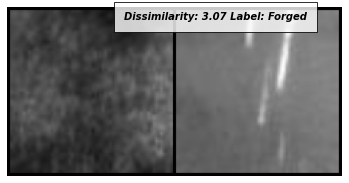

67 / 67
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_4.png',)]
/
_


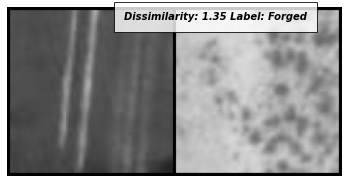

68 / 68
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_1.png',)]
/
_


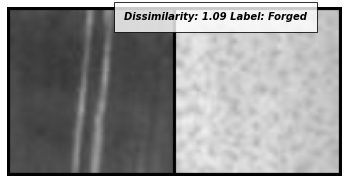

69 / 69
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_4.png',)]
/
_


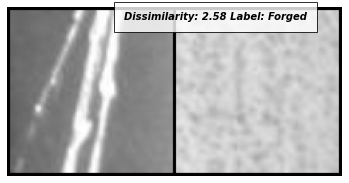

70 / 70
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_1.png',)]
/
_


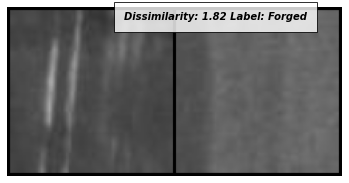

71 / 71
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_4.png',)]
/
_


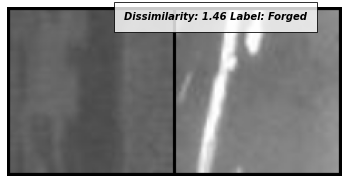

72 / 72
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',)]
/
/


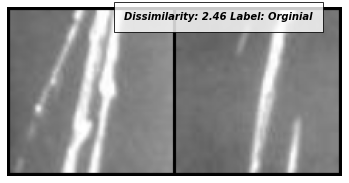

73 / 73
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',)]
/
/


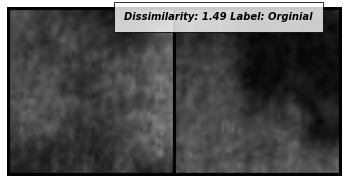

74 / 74
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_2.png',)]
/
_


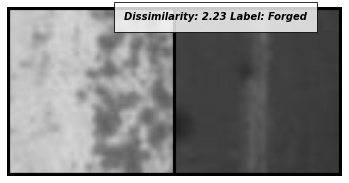

75 / 75
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_1.png',)]
/
_


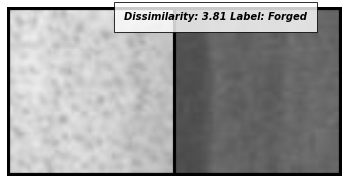

76 / 76
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_4.png',)]
/
_


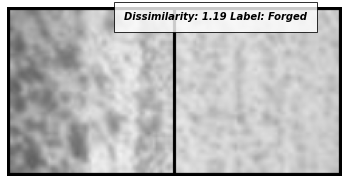

77 / 77
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_5.png',)]
/
_


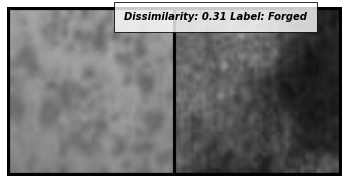

78 / 78
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_3.png',)]
/
_


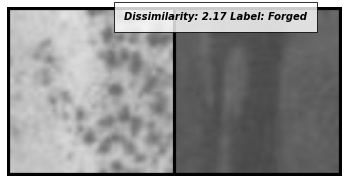

79 / 79
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_1.png',)]
/
_


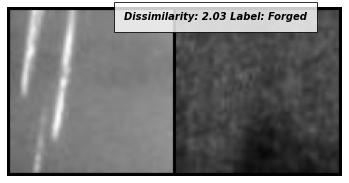

80 / 80
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',)]
/
/


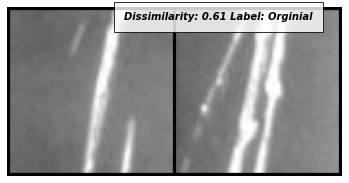

81 / 81
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_3.png',)]
/
_


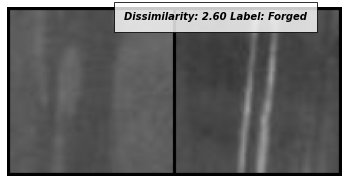

82 / 82
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_2.png',)]
/
_


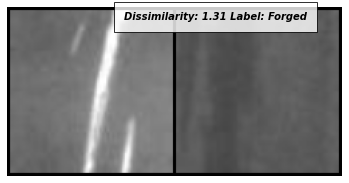

83 / 83
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_5.png',)]
/
_


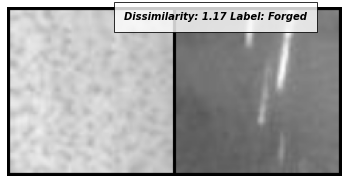

84 / 84
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_3.png',)]
/
_


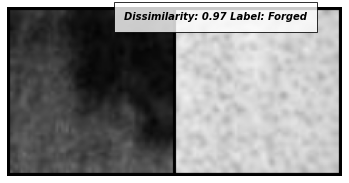

85 / 85
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_2.png',)]
/
_


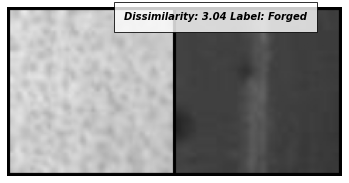

86 / 86
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_4.png',)]
/
_


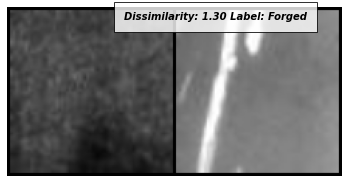

87 / 87
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_1.png',)]
/
_


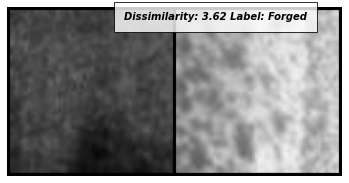

88 / 88
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_5.png',)]
/
_


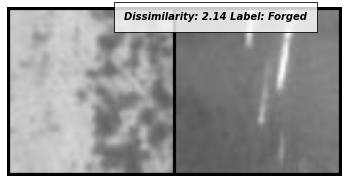

89 / 89
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_5.png',)]
/
_


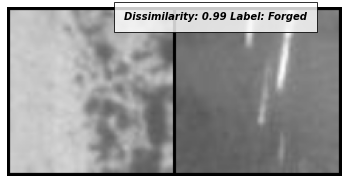

90 / 90
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_1.png',)]
/
_


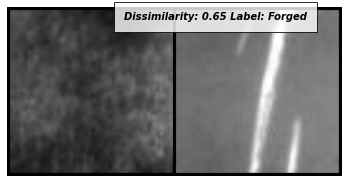

91 / 91
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',)]
/
/


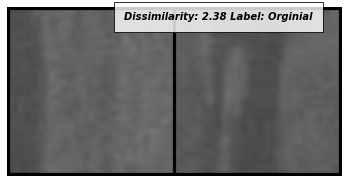

92 / 92
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_2.png',)]
/
_


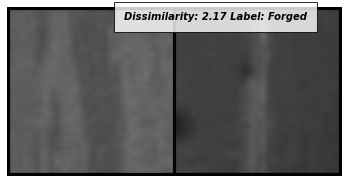

93 / 93
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_2.png',)]
/
_


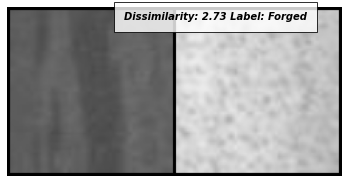

94 / 94
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_4.png',)]
/
_


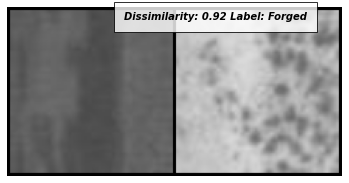

95 / 95
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_2.png',)]
/
_


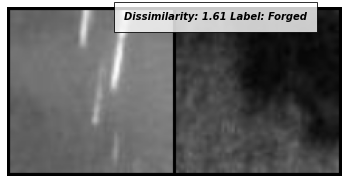

96 / 96
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_4.png',)]
/
_


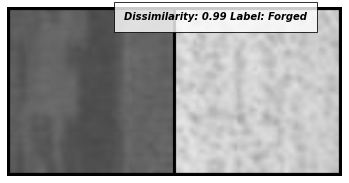

97 / 97
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_3.png',)]
/
_


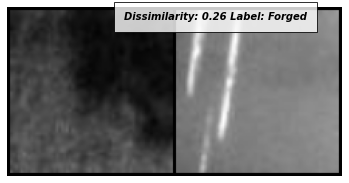

98 / 98
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_1.png',)]
/
_


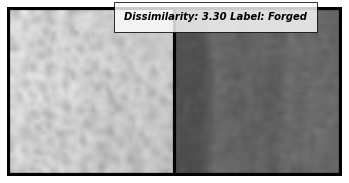

99 / 99
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',)]
/
/


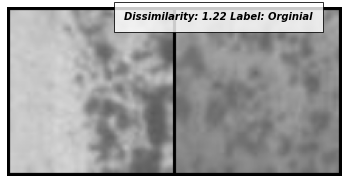

100 / 100
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_3.png',)]
/
_


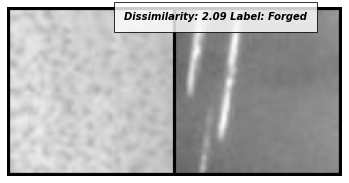

101 / 101
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_4.png',)]
/
_


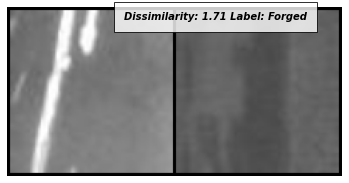

102 / 102
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_5.png',)]
/
_


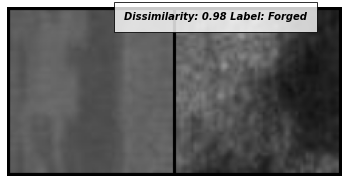

103 / 103
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',)]
/
/


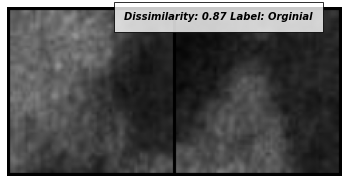

104 / 104
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_3.png',)]
/
_


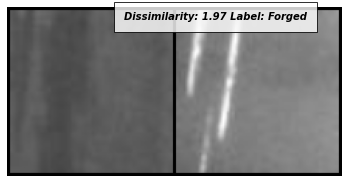

105 / 105
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_1.png',)]
/
_


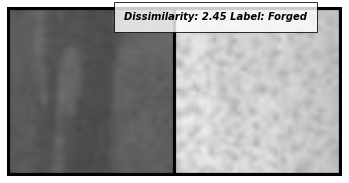

106 / 106
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',)]
/
/


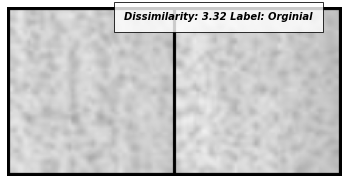

107 / 107
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',)]
/
/


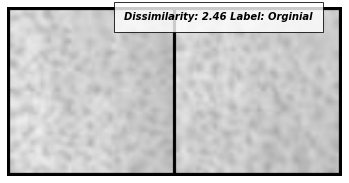

108 / 108
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_4.png',)]
/
_


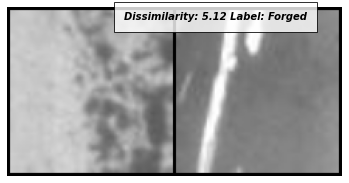

109 / 109
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_1.png',)]
/
_


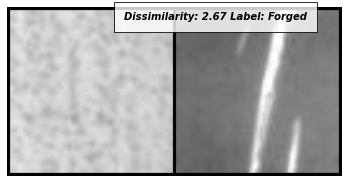

110 / 110
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',)]
/
/


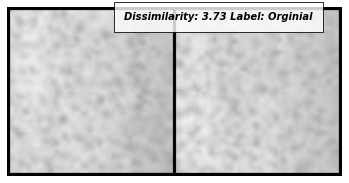

111 / 111
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_4.png',)]
/
_


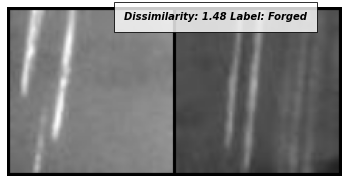

112 / 112
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_3.png',)]
/
_


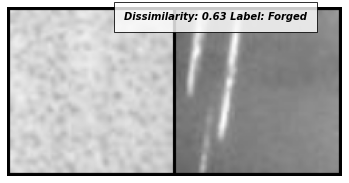

113 / 113
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_4.png',)]
/
_


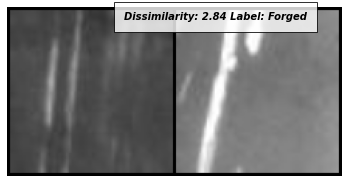

114 / 114
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_5.png',)]
/
_


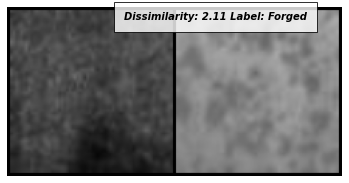

115 / 115
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_3.png',)]
/
_


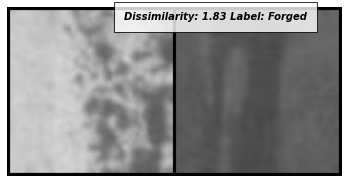

116 / 116
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_3.png',)]
/
_


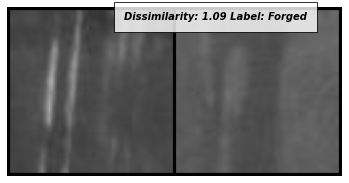

117 / 117
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_3.png',)]
/
_


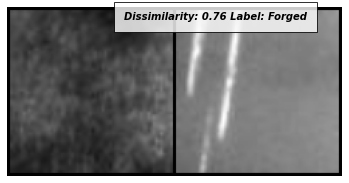

118 / 118
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_2.png',)]
/
_


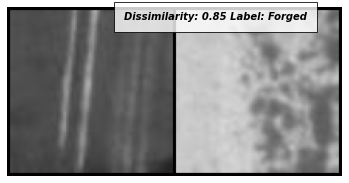

119 / 119
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_5.png',)]
/
_


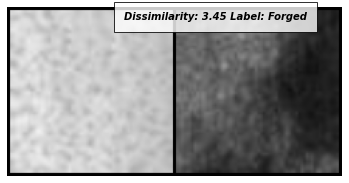

120 / 120
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_5.png',)]
/
_


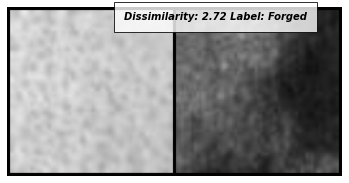

121 / 121
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_1.png',)]
/
_


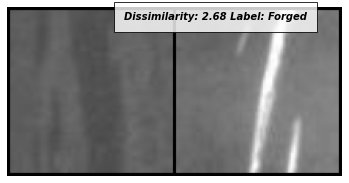

122 / 122
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_5.png',)]
/
_


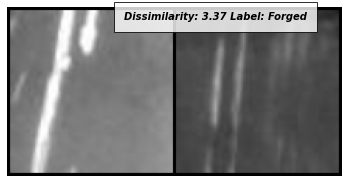

123 / 123
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_3.png',)]
/
_


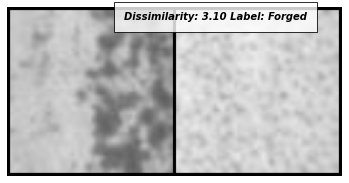

124 / 124
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_2.png',)]
/
_


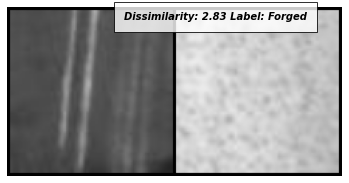

125 / 125
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',)]
/
/


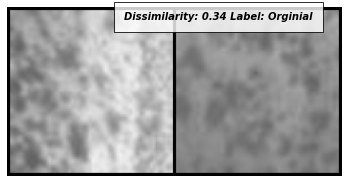

126 / 126
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_5.png',)]
/
_


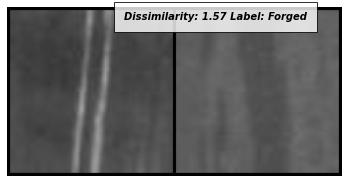

127 / 127
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_3.png',)]
/
_


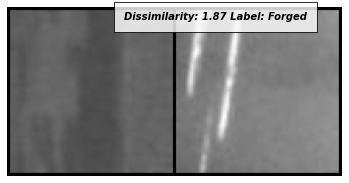

128 / 128
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_1.png',)]
/
_


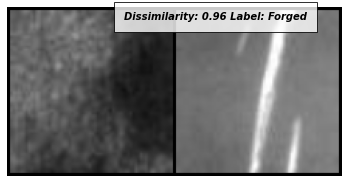

129 / 129
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_3.png',)]
/
_


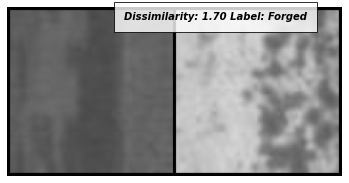

130 / 130
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_2.png',)]
/
_


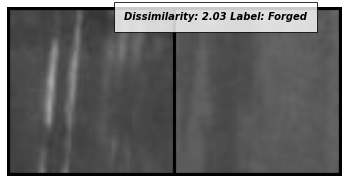

131 / 131
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_3.png',)]
/
_


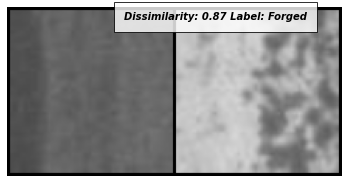

132 / 132
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_3.png',)]
/
_


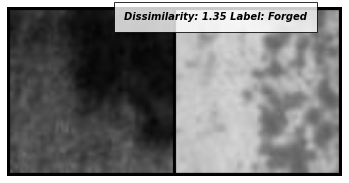

133 / 133
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_1.png',)]
/
_


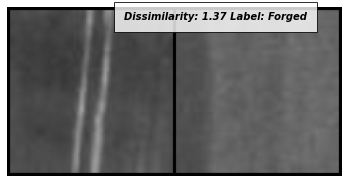

134 / 134
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',)]
/
/


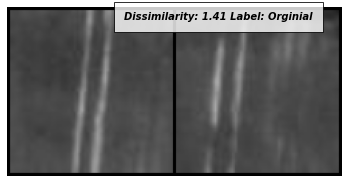

135 / 135
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_4.png',)]
/
_


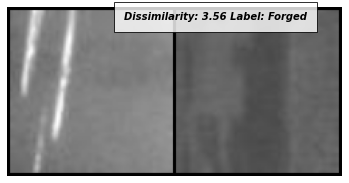

136 / 136
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_1.png',)]
/
_


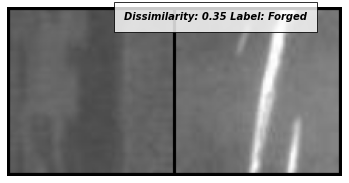

137 / 137
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_5.png',)]
/
_


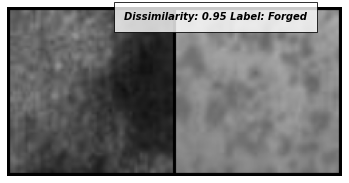

138 / 138
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_1.png',)]
/
_


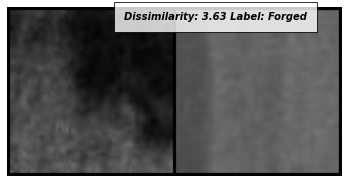

139 / 139
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_1.png',)]
/
_


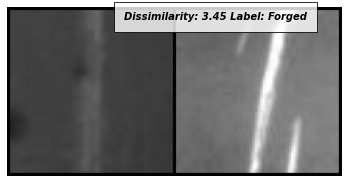

140 / 140
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_1.png',)]
/
_


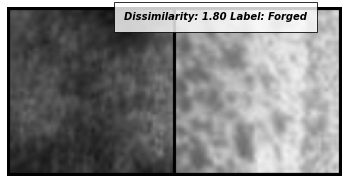

141 / 141
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_2.png',)]
/
_


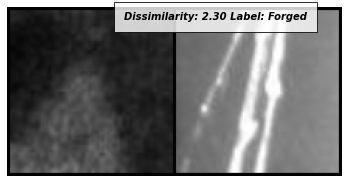

142 / 142
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_3.png',)]
/
_


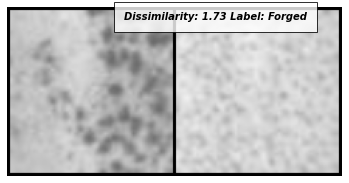

143 / 143
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_5.png',)]
/
_


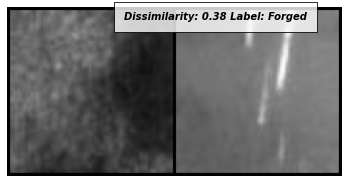

144 / 144
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_3.png',)]
/
_


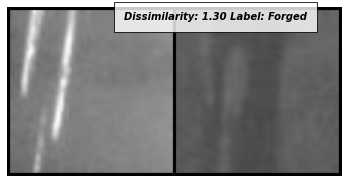

145 / 145
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',)]
/
/


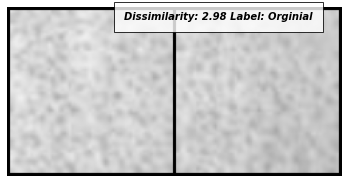

146 / 146
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_5.png',)]
/
_


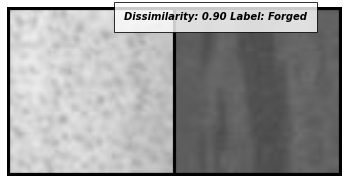

147 / 147
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_2.png',)]
/
_


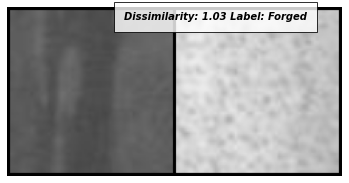

148 / 148
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_2.png',)]
/
_


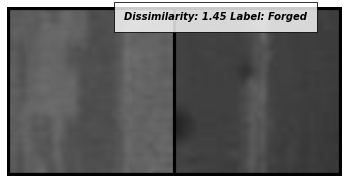

149 / 149
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_1.png',)]
/
_


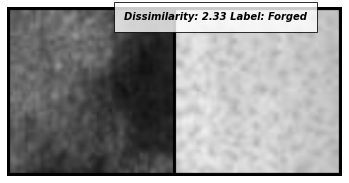

150 / 150
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_4.png',)]
/
_


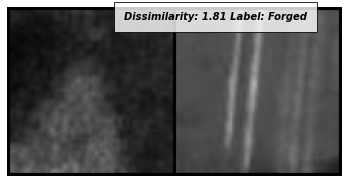

151 / 151
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',)]
/
/


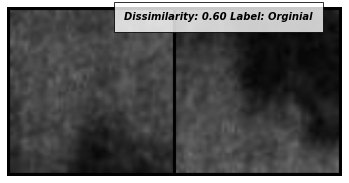

152 / 152
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_5.png',)]
/
_


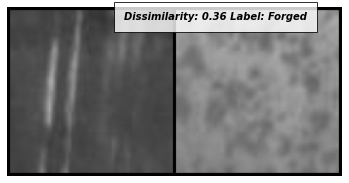

153 / 153
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_5.png',)]
/
_


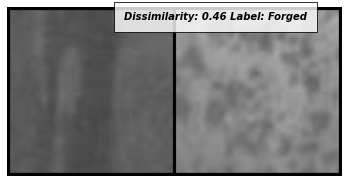

154 / 154
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_1.png',)]
/
_


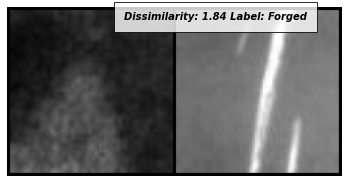

155 / 155
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_5.png',)]
/
_


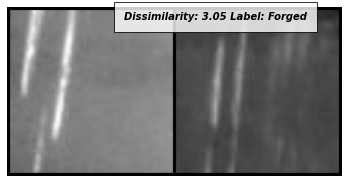

156 / 156
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_3.png',)]
/
_


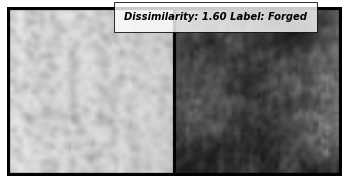

157 / 157
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',)]
/
/


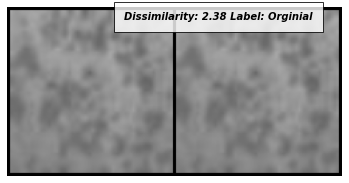

158 / 158
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',)]
/
/


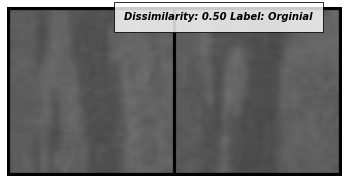

159 / 159
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_1.png',)]
/
_


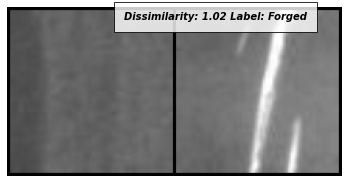

160 / 160
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_1.png',)]
/
_


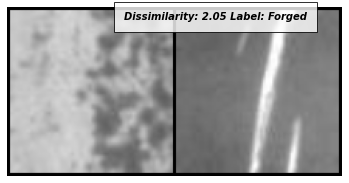

161 / 161
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_2.png',)]
/
_


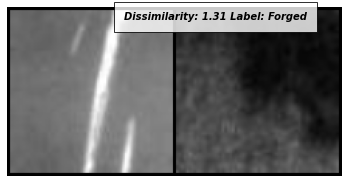

162 / 162
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_2.png',)]
/
_


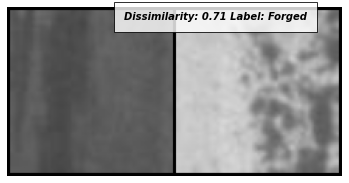

163 / 163
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_3.png',)]
/
_


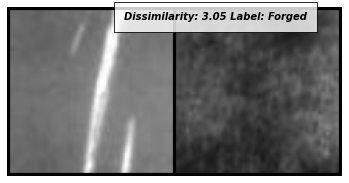

164 / 164
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_1.png',)]
/
_


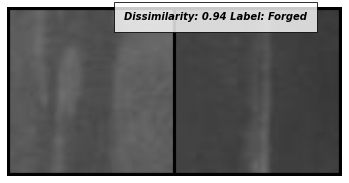

165 / 165
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_4.png',)]
/
_


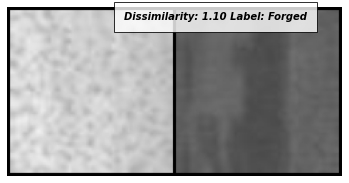

166 / 166
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_1.png',)]
/
_


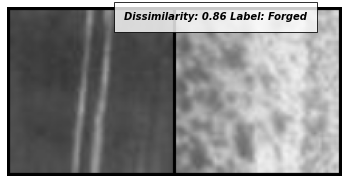

167 / 167
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_2.png',)]
/
_


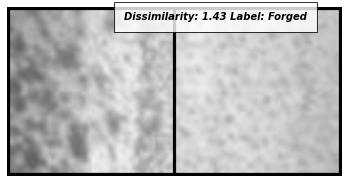

168 / 168
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_1.png',)]
/
_


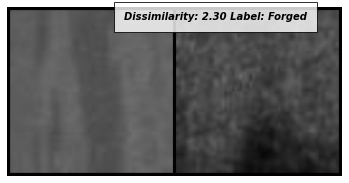

169 / 169
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_2.png',)]
/
_


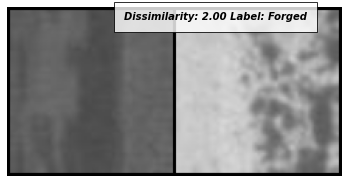

170 / 170
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_1.png',)]
/
_


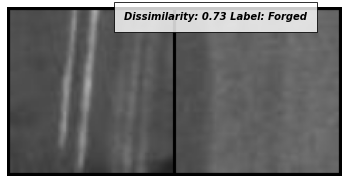

171 / 171
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_1.png',)]
/
_


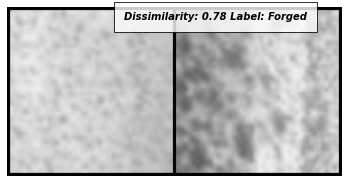

172 / 172
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_5.png',)]
/
_


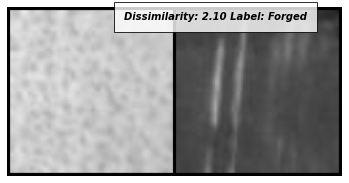

173 / 173
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_1.png',)]
/
_


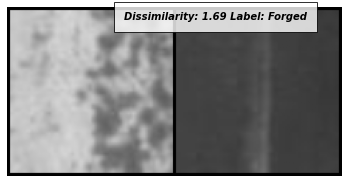

174 / 174
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',)]
/
/


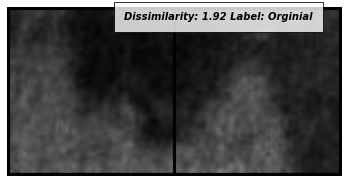

175 / 175
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_1.png',)]
/
_


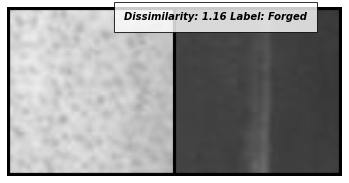

176 / 176
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_1.png',)]
/
_


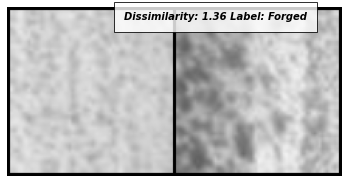

177 / 177
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_1.png',)]
/
_


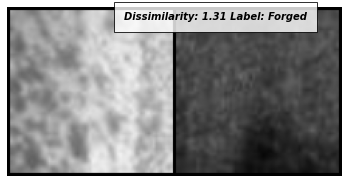

178 / 178
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_3.png',)]
/
_


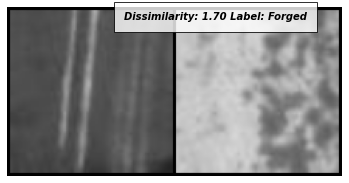

179 / 179
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',)]
/
/


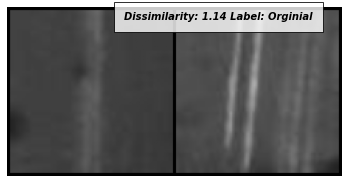

180 / 180
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_4.png',)]
/
_


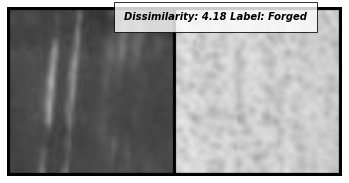

181 / 181
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_3.png',)]
/
_


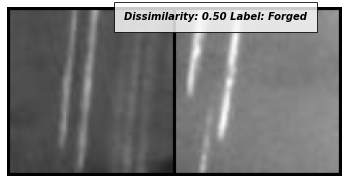

182 / 182
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_3.png',)]
/
_


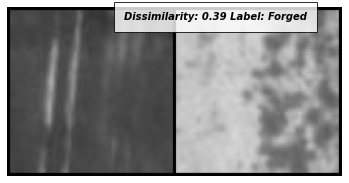

183 / 183
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_2.png',)]
/
_


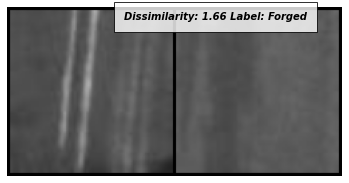

184 / 184
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_2.png',)]
/
_


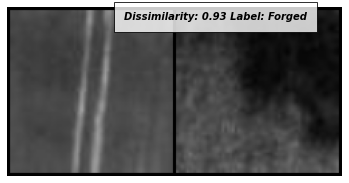

185 / 185
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_3.png',)]
/
_


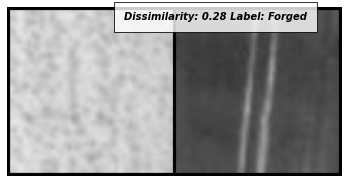

186 / 186
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_4.png',)]
/
_


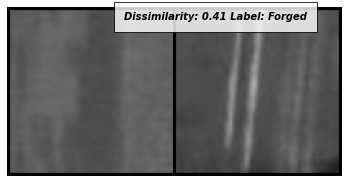

187 / 187
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',)]
/
/


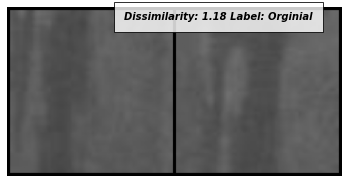

188 / 188
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_1.png',)]
/
_


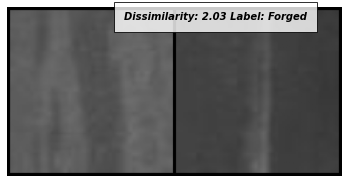

189 / 189
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_2.png',)]
/
_


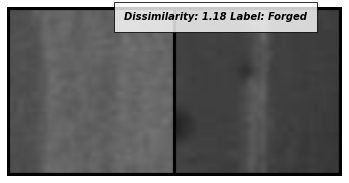

190 / 190
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_1.png',)]
/
_


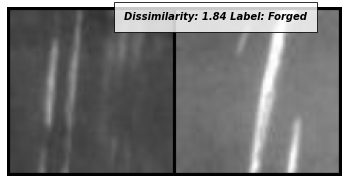

191 / 191
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',)]
/
/


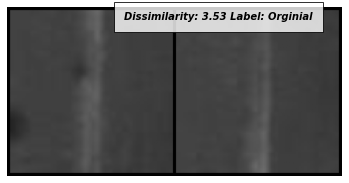

192 / 192
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',)]
/
/


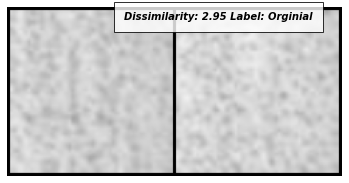

193 / 193
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_5.png',)]
/
_


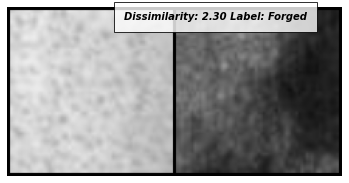

194 / 194
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_2.png',)]
/
_


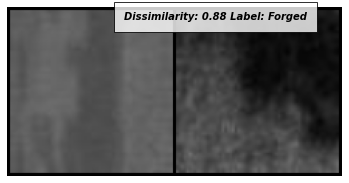

195 / 195
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',)]
/
/


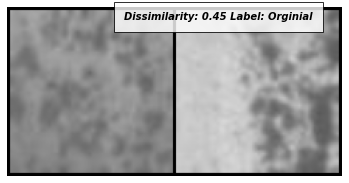

196 / 196
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',)]
/
/


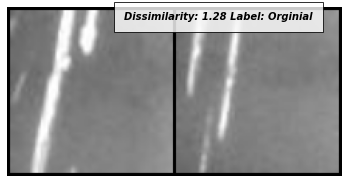

197 / 197
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_4.png',)]
/
_


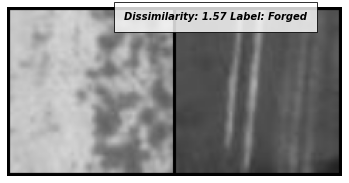

198 / 198
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',)]
/
/


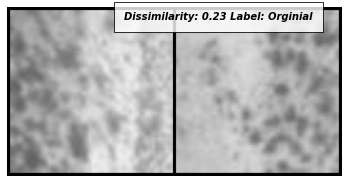

199 / 199
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_1.png',)]
/
_


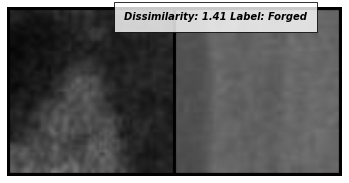

200 / 200
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_3.png',)]
/
_


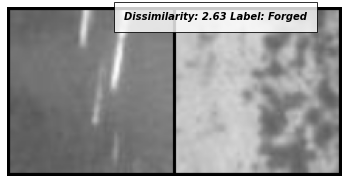

201 / 201
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_1.png',)]
/
_


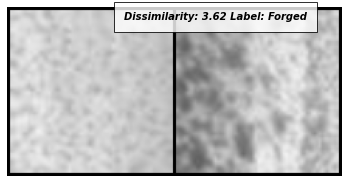

202 / 202
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_4.png',)]
/
_


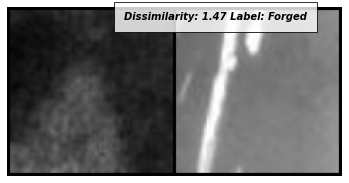

203 / 203
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_5.png',)]
/
_


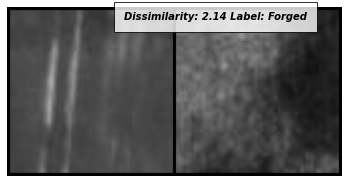

204 / 204
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_5.png',)]
/
_


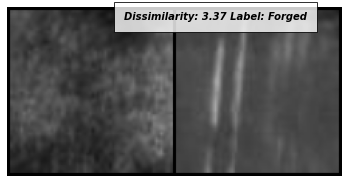

205 / 205
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_4.png',)]
/
_


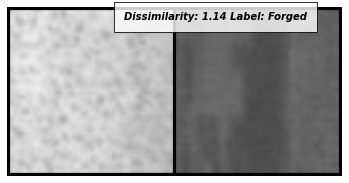

206 / 206
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_4.png',)]
/
_


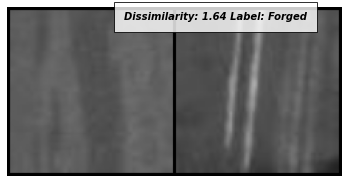

207 / 207
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_1.png',)]
/
_


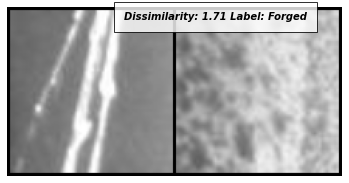

208 / 208
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_3.png',)]
/
_


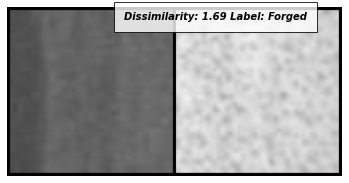

209 / 209
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',)]
/
/


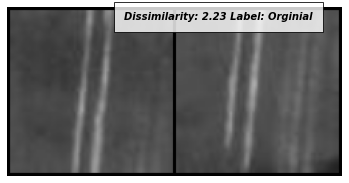

210 / 210
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',)]
/
/


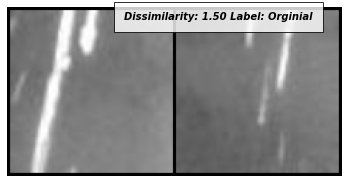

211 / 211
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_1.png',)]
/
_


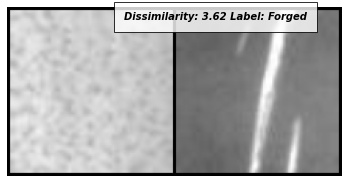

212 / 212
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',)]
/
/


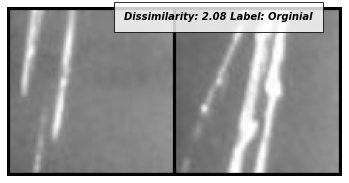

213 / 213
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',)]
/
/


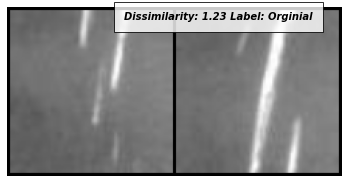

214 / 214
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_5.png',)]
/
_


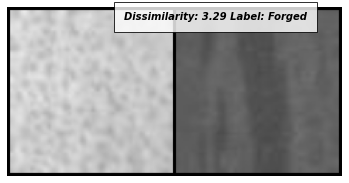

215 / 215
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_2.png',)]
/
_


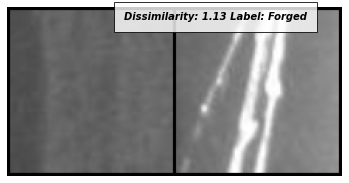

216 / 216
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',)]
/
/


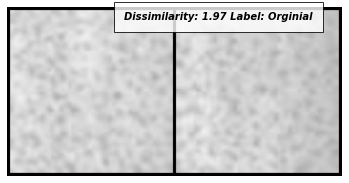

217 / 217
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_2.png',)]
/
_


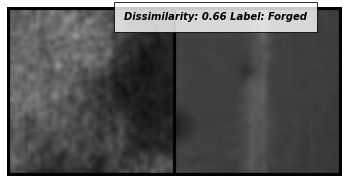

218 / 218
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_1.png',)]
/
_


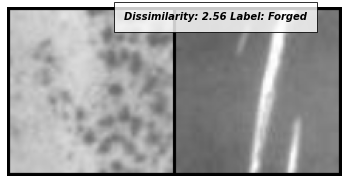

219 / 219
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_3.png',)]
/
_


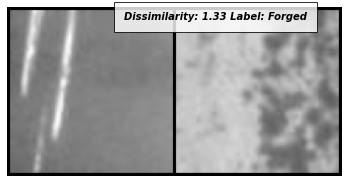

220 / 220
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_2.png',)]
/
_


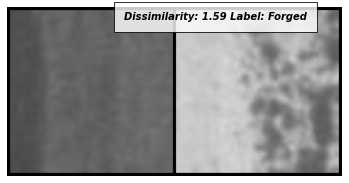

221 / 221
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_1.png',)]
/
_


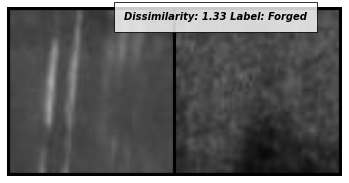

222 / 222
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',)]
/
/


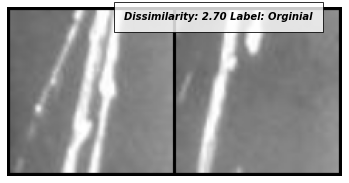

223 / 223
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_1.png',)]
/
_


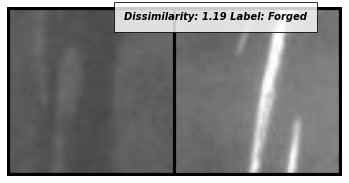

224 / 224
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_5.png',)]
/
_


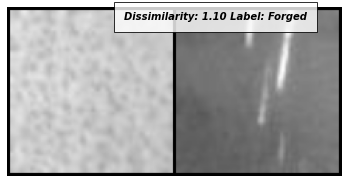

225 / 225
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_1.png',)]
/
_


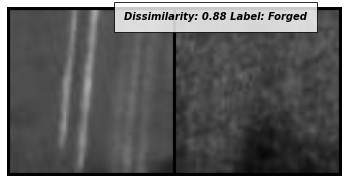

226 / 226
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_4.png',)]
/
_


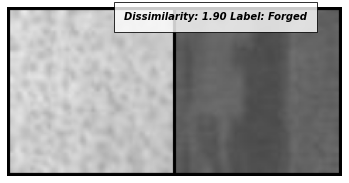

227 / 227
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_1.png',)]
/
_


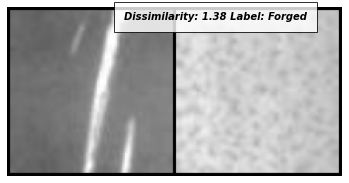

228 / 228
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_2.png',)]
/
_


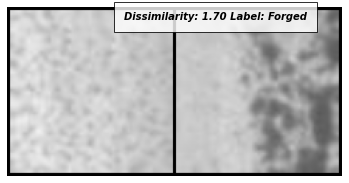

229 / 229
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_4.png',)]
/
_


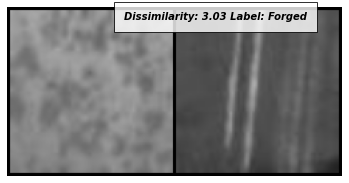

230 / 230
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_3.png',)]
/
_


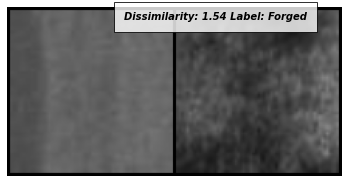

231 / 231
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_1.png',)]
/
_


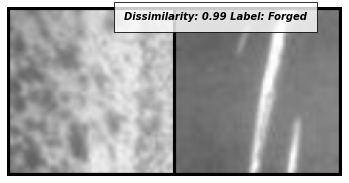

232 / 232
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_1.png',)]
/
_


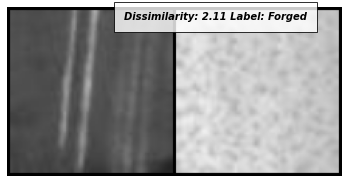

233 / 233
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_5.png',)]
/
_


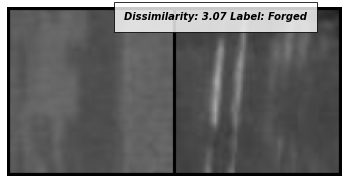

234 / 234
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_5.png',)]
/
_


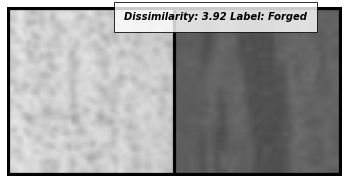

235 / 235
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_5.png',)]
/
_


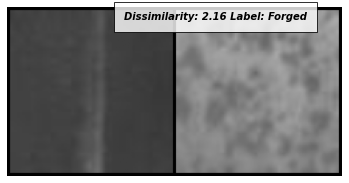

236 / 236
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_4.png',)]
/
_


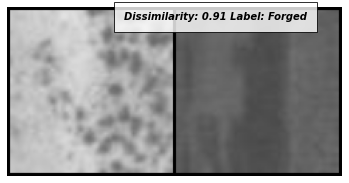

237 / 237
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',)]
/
/


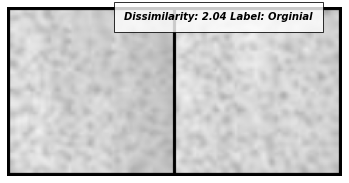

238 / 238
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',)]
/
/


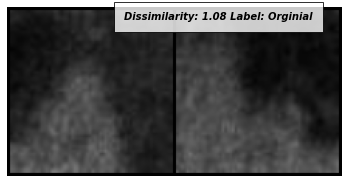

239 / 239
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',)]
/
/


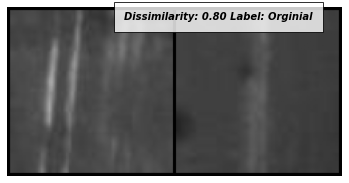

240 / 240
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',)]
/
/


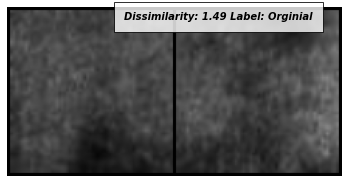

241 / 241
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_5.png',)]
/
_


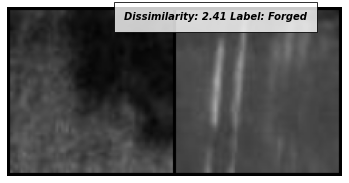

242 / 242
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_5.png',)]
/
_


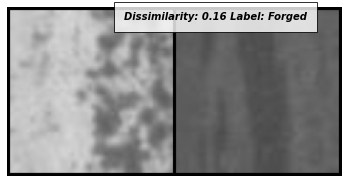

243 / 243
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_4.png',)]
/
_


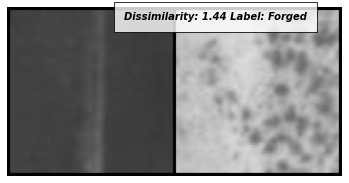

244 / 244
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_3.png',)]
/
_


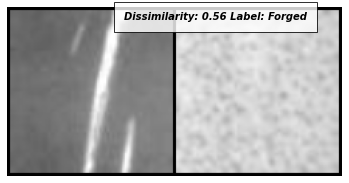

245 / 245
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_2.png',)]
/
_


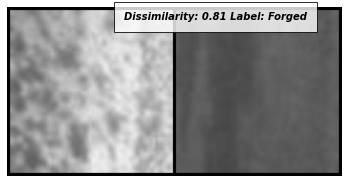

246 / 246
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_3.png',)]
/
_


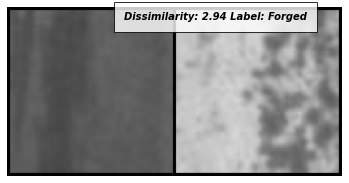

247 / 247
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_4.png',)]
/
_


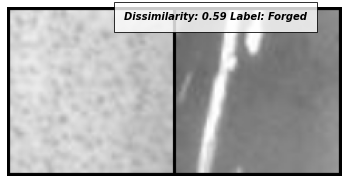

248 / 248
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_3.png',)]
/
_


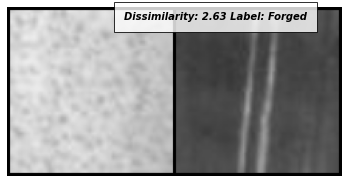

249 / 249
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_2.png',)]
/
_


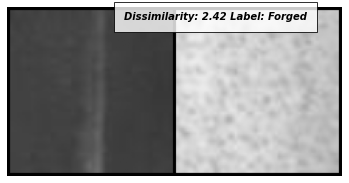

250 / 250
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_1.png',)]
/
_


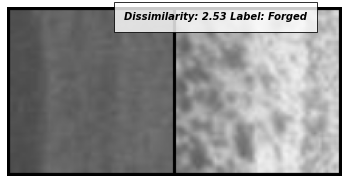

251 / 251
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_1.png',)]
/
_


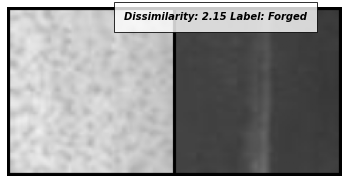

252 / 252
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_2.png',)]
/
_


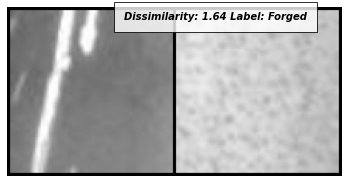

253 / 253
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_1.png',)]
/
_


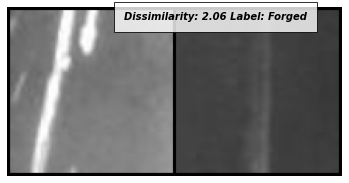

254 / 254
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_1.png',)]
/
_


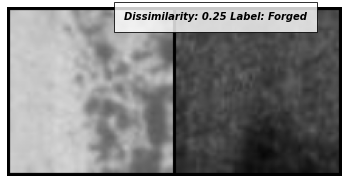

255 / 255
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_4.png',)]
/
_


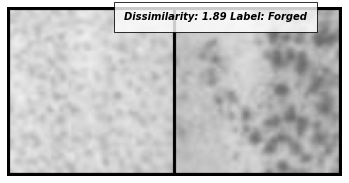

256 / 256
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_1.png',)]
/
_


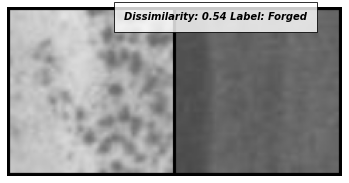

257 / 257
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_3.png',)]
/
_


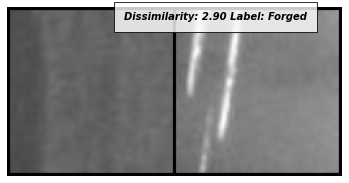

258 / 258
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_1.png',)]
/
_


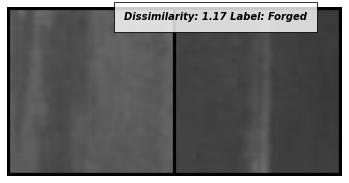

259 / 259
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_4.png',)]
/
_


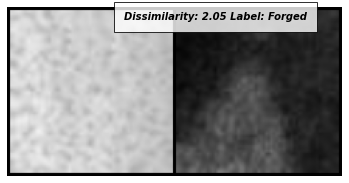

260 / 260
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',)]
/
/


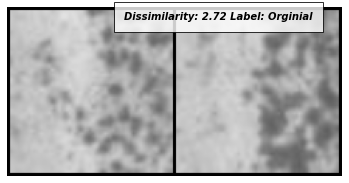

261 / 261
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_2.png',)]
/
_


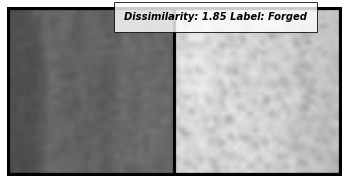

262 / 262
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_4.png',)]
/
_


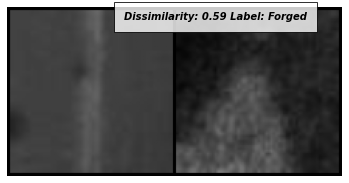

263 / 263
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_4.png',)]
/
_


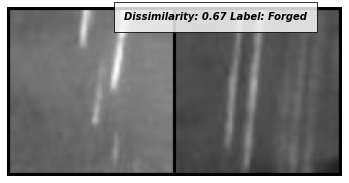

264 / 264
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_5.png',)]
/
_


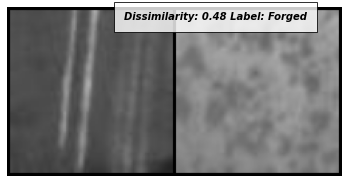

265 / 265
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_5.png',)]
/
_


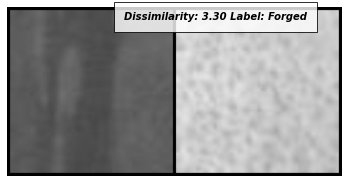

266 / 266
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',)]
/
/


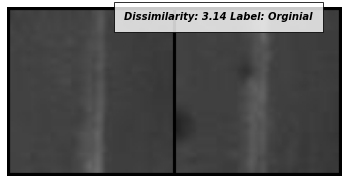

267 / 267
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',)]
/
/


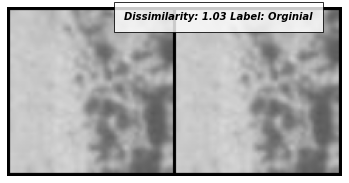

268 / 268
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_5.png',)]
/
_


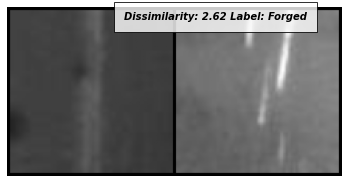

269 / 269
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_5.png',)]
/
_


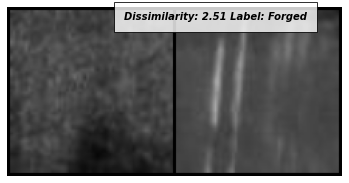

270 / 270
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_5.png',)]
/
_


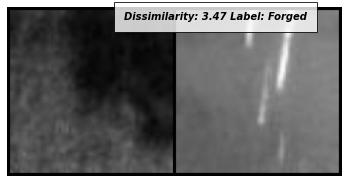

271 / 271
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',)]
/
/


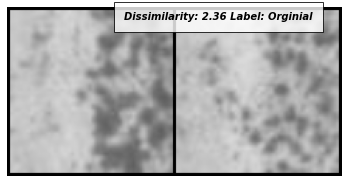

272 / 272
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_4.png',)]
/
_


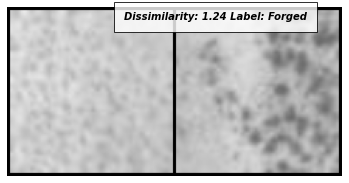

273 / 273
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_2.png',)]
/
_


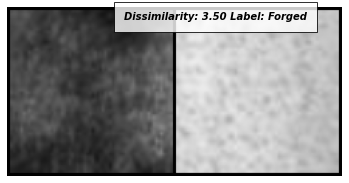

274 / 274
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_2.png',)]
/
_


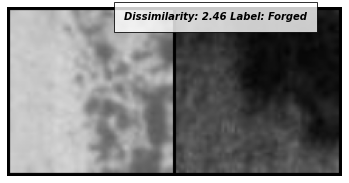

275 / 275
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_1.png',)]
/
_


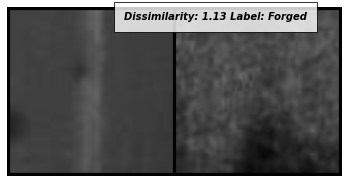

276 / 276
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_1.png',)]
/
_


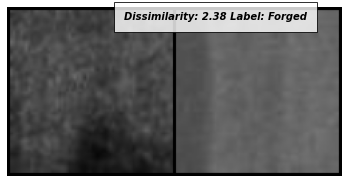

277 / 277
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_2.png',)]
/
_


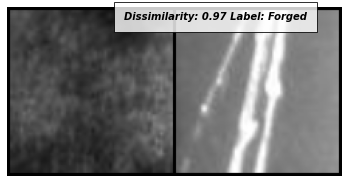

278 / 278
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_5.png',)]
/
_


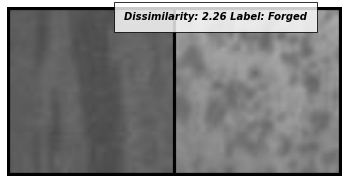

279 / 279
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_1.png',)]
/
_


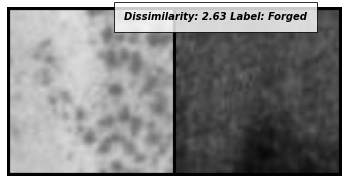

280 / 280
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_5.png',)]
/
_


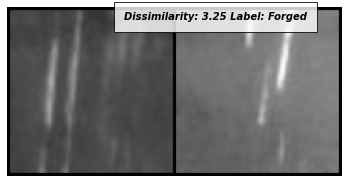

281 / 281
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_3.png',)]
/
_


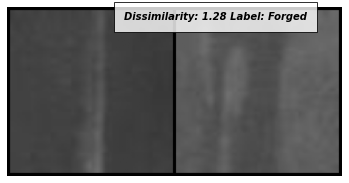

282 / 282
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_4.png',)]
/
_


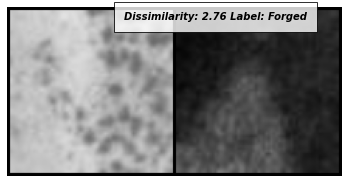

283 / 283
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',)]
/
/


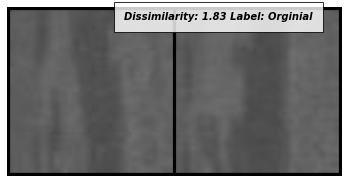

284 / 284
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_4.png',)]
/
_


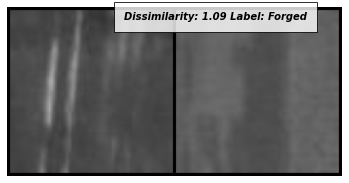

285 / 285
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_4.png',)]
/
_


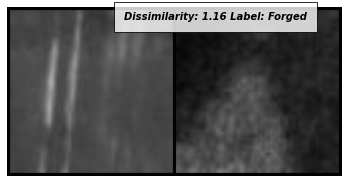

286 / 286
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_5.png',)]
/
_


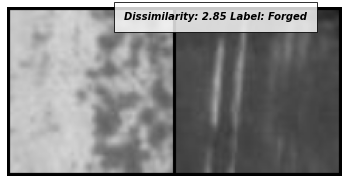

287 / 287
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_4.png',)]
/
_


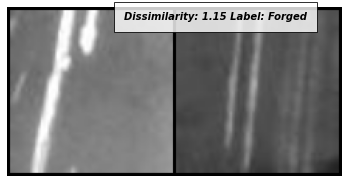

288 / 288
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_3.png',)]
/
_


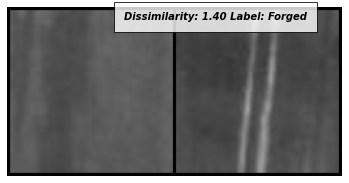

289 / 289
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_2.png',)]
/
_


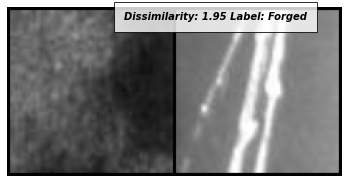

290 / 290
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_1.png',)]
/
_


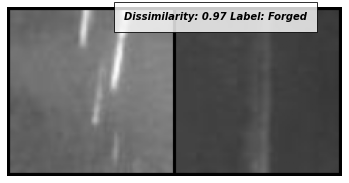

291 / 291
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_5.png',)]
/
_


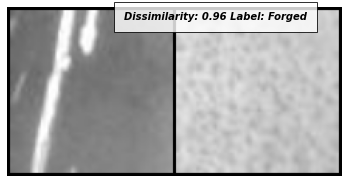

292 / 292
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_2.png',)]
/
_


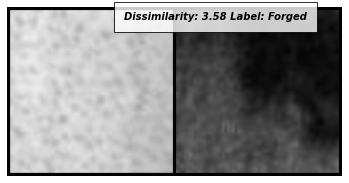

293 / 293
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_1.png',)]
/
_


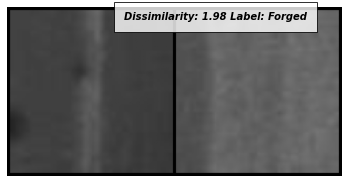

294 / 294
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',)]
/
/


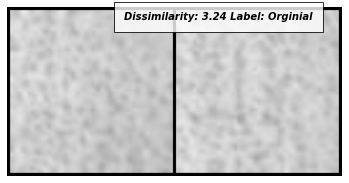

295 / 295
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',)]
/
/


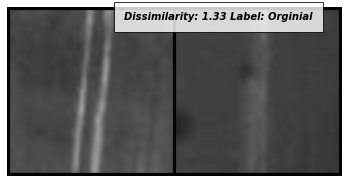

296 / 296
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_5.png',)]
/
_


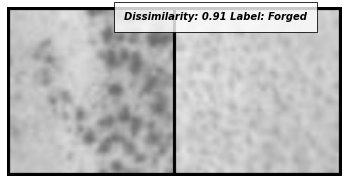

297 / 297
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_2.png',)]
/
_


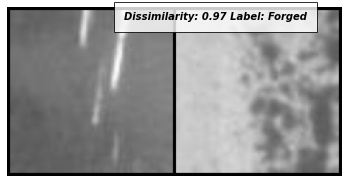

298 / 298
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_5.png',)]
/
_


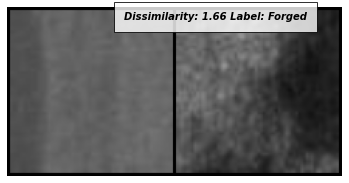

299 / 299
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_4.png',)]
/
_


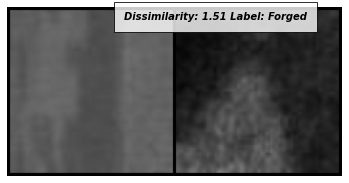

300 / 300
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_5.png',)]
/
_


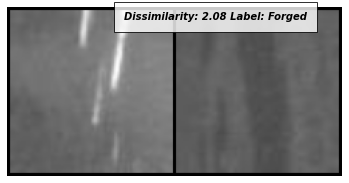

301 / 301
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_4.png',)]
/
_


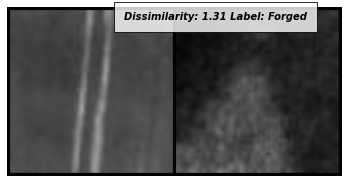

302 / 302
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_5.png',)]
/
_


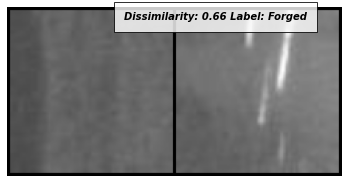

303 / 303
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_5.png',)]
/
_


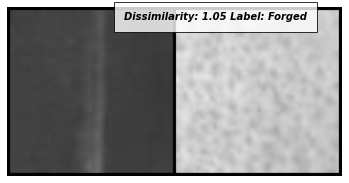

304 / 304
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_4.png',)]
/
_


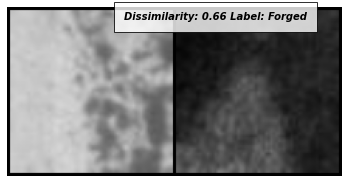

305 / 305
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_5.png',)]
/
_


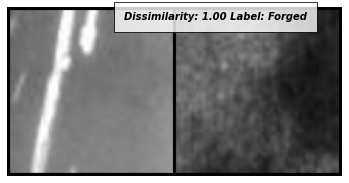

306 / 306
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',)]
/
/


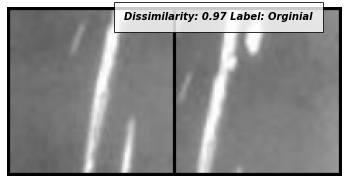

307 / 307
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',)]
/
/


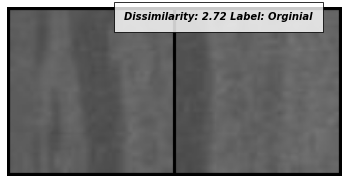

308 / 308
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_4.png',)]
/
_


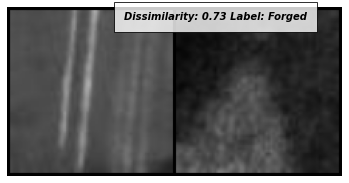

309 / 309
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_5.png',)]
/
_


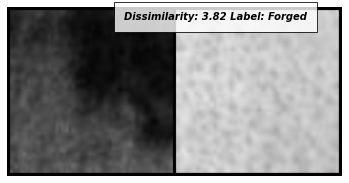

310 / 310
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_5.png',)]
/
_


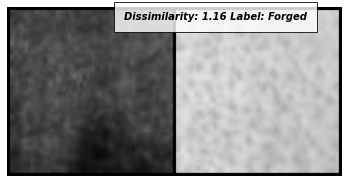

311 / 311
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',)]
/
/


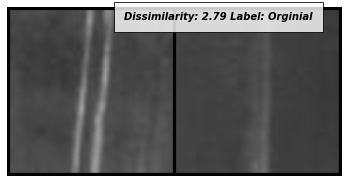

312 / 312
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_2.png',)]
/
_


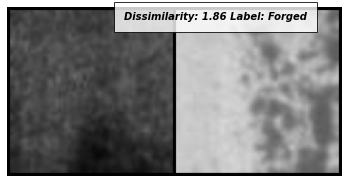

313 / 313
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_5.png',)]
/
_


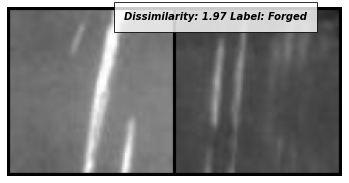

314 / 314
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_4.png',)]
/
_


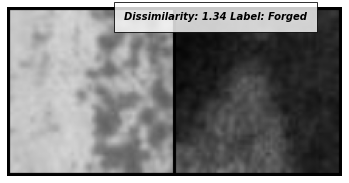

315 / 315
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_4.png',)]
/
_


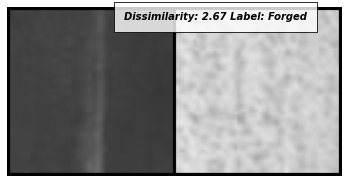

316 / 316
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_4.png',)]
/
_


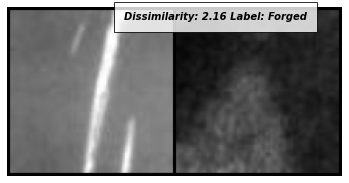

317 / 317
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_3.png',)]
/
_


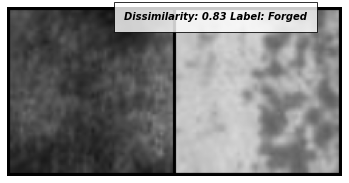

318 / 318
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_2.png',)]
/
_


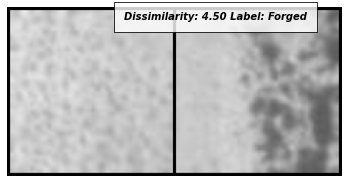

319 / 319
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_2.png',)]
/
_


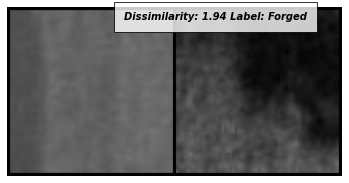

320 / 320
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_1.png',)]
/
_


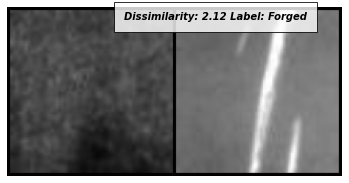

321 / 321
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',)]
/
/


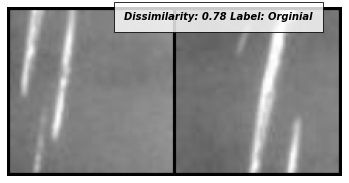

322 / 322
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',)]
/
/


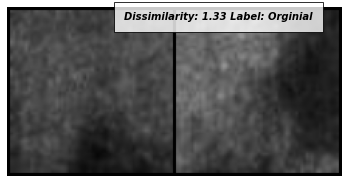

323 / 323
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_4.png',)]
/
_


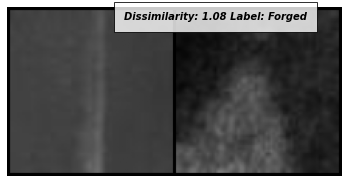

324 / 324
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_1.png',)]
/
_


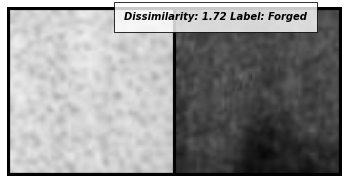

325 / 325
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_2.png',)]
/
_


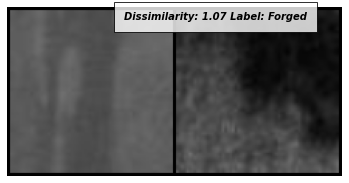

326 / 326
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_1.png',)]
/
_


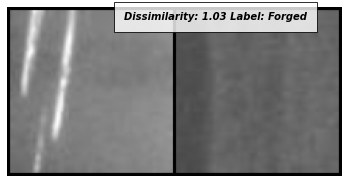

327 / 327
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_4.png',)]
/
_


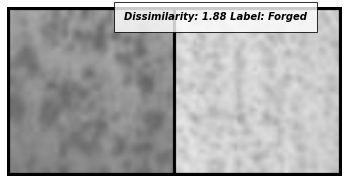

328 / 328
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_1.png',)]
/
_


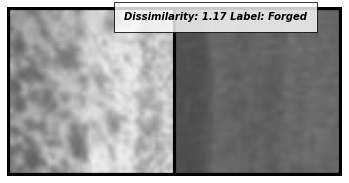

329 / 329
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_4.png',)]
/
_


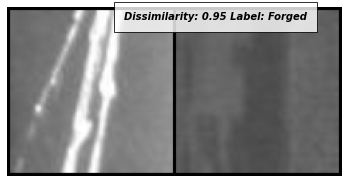

330 / 330
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_2.png',)]
/
_


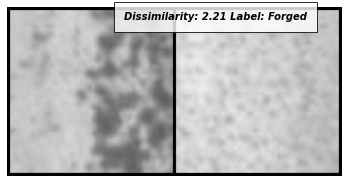

331 / 331
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_4.png',)]
/
_


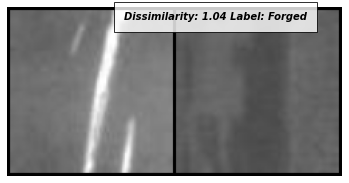

332 / 332
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_3.png',)]
/
_


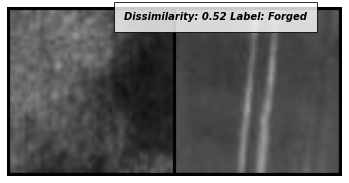

333 / 333
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_4.png',)]
/
_


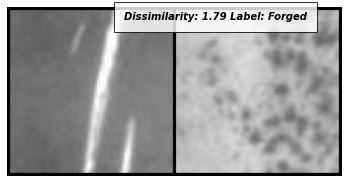

334 / 334
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_4.png',)]
/
_


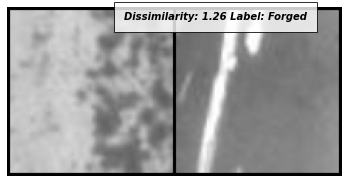

335 / 335
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_4.png',)]
/
_


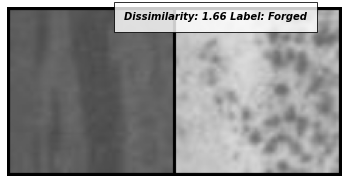

336 / 336
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_3.png',)]
/
_


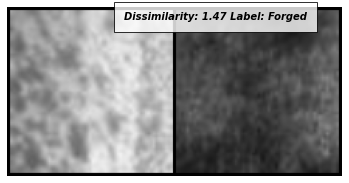

337 / 337
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_4.png',)]
/
_


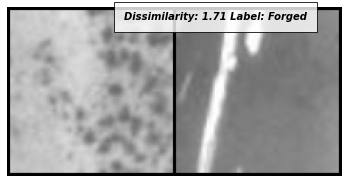

338 / 338
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_3.png',)]
/
_


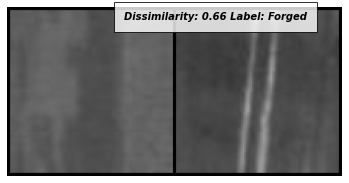

339 / 339
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_5.png',)]
/
_


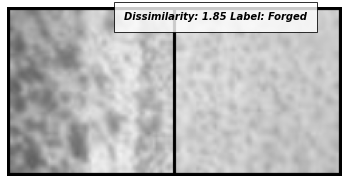

340 / 340
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_3.png',)]
/
_


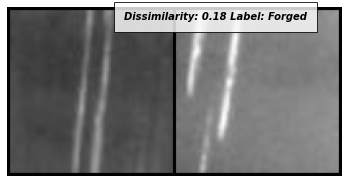

341 / 341
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_3.png',)]
/
_


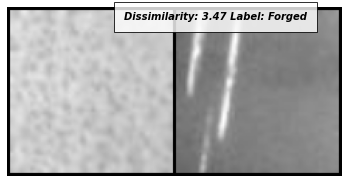

342 / 342
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_4.png',)]
/
_


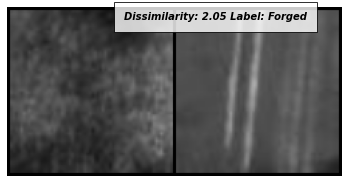

343 / 343
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_3.png',)]
/
_


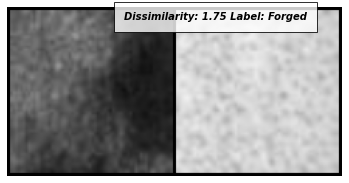

344 / 344
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_3.png',)]
/
_


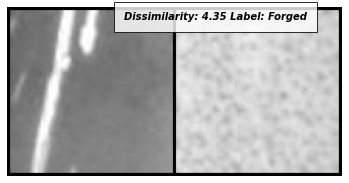

345 / 345
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_2.png',)]
/
_


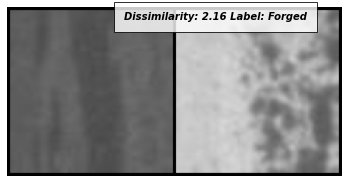

346 / 346
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_1.png',)]
/
_


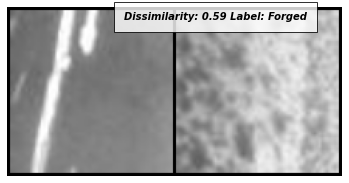

347 / 347
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_1.png',)]
/
_


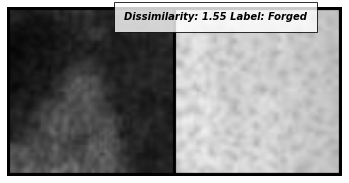

348 / 348
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',)]
/
/


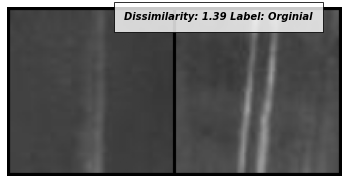

349 / 349
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_2.png',)]
/
_


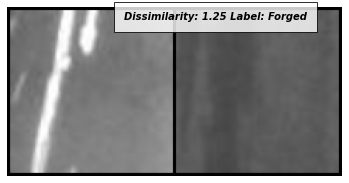

350 / 350
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_1.png',)]
/
_


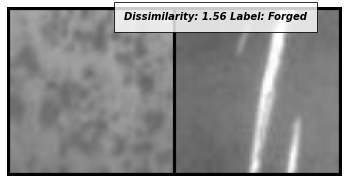

351 / 351
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',)]
/
/


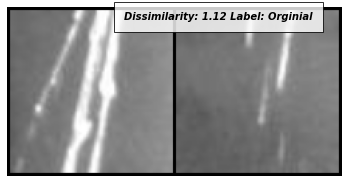

352 / 352
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_5.png',)]
/
_


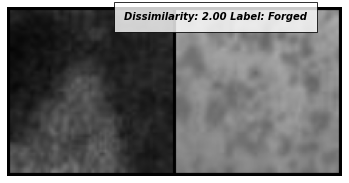

353 / 353
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',)]
/
/


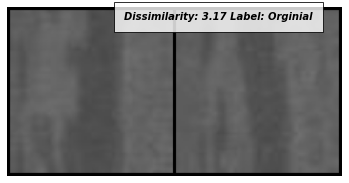

354 / 354
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_4.png',)]
/
_


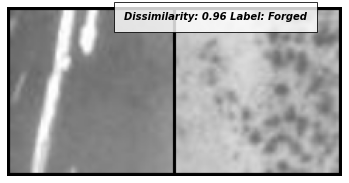

355 / 355
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_3.png',)]
/
_


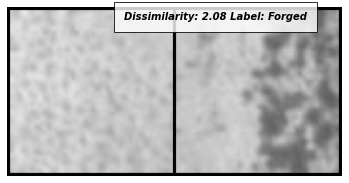

356 / 356
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_4.png',)]
/
_


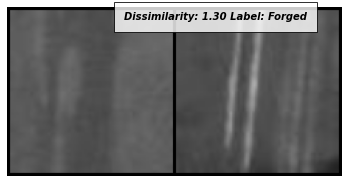

357 / 357
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_5.png',)]
/
_


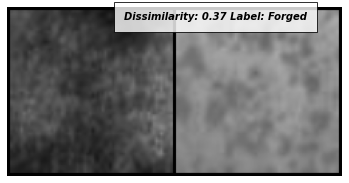

358 / 358
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_3.png',)]
/
_


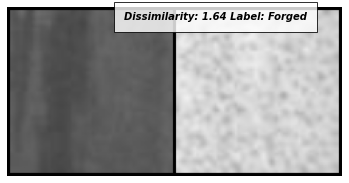

359 / 359
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_1.png',)]
/
_


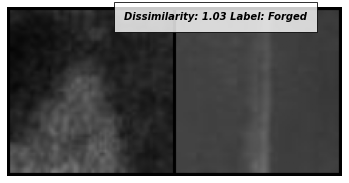

360 / 360
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_2.png',)]
/
_


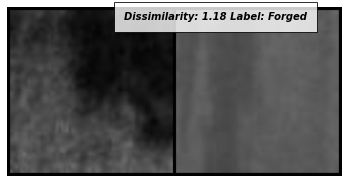

361 / 361
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_3.png',)]
/
_


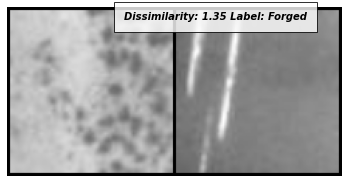

362 / 362
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_4.png',)]
/
_


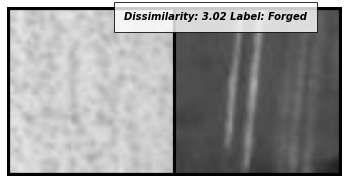

363 / 363
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',)]
/
/


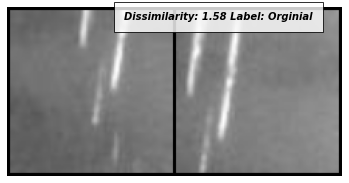

364 / 364
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',)]
/
/


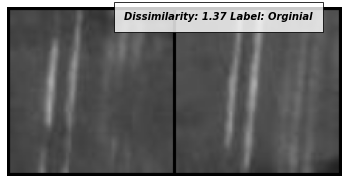

365 / 365
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_1.png',)]
/
_


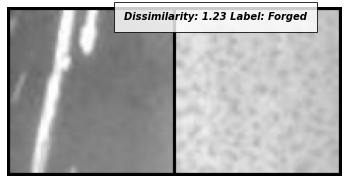

366 / 366
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_2.png',)]
/
_


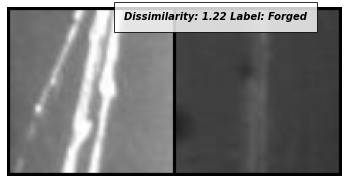

367 / 367
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_4.png',)]
/
_


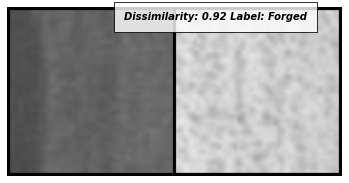

368 / 368
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_2.png',)]
/
_


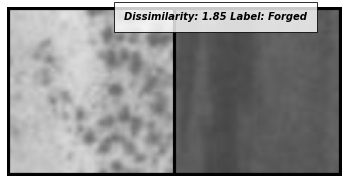

369 / 369
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_5.png',)]
/
_


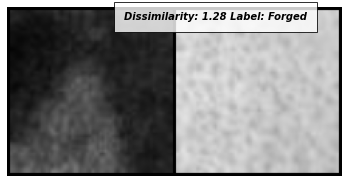

370 / 370
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_2.png',)]
/
_


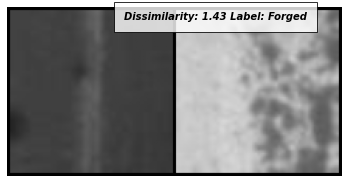

371 / 371
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_5.png',)]
/
_


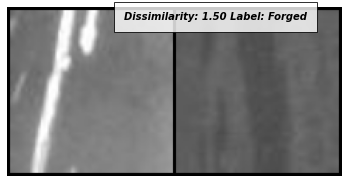

372 / 372
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_5.png',)]
/
_


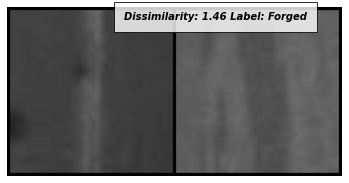

373 / 373
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_4.png',)]
/
_


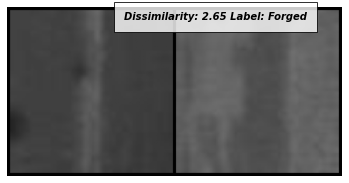

374 / 374
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_4.png',)]
/
_


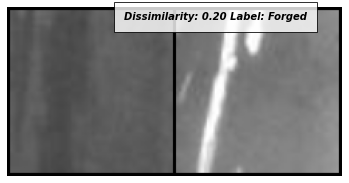

375 / 375
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_3.png',)]
/
_


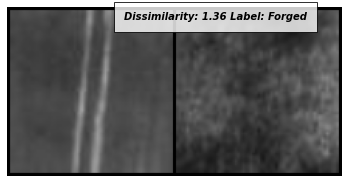

376 / 376
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',)]
/
/


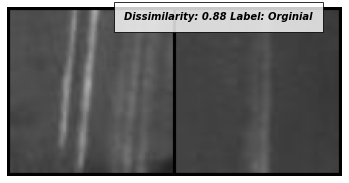

377 / 377
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_1.png',)]
/
_


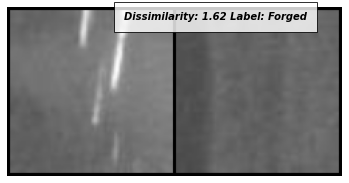

378 / 378
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_2.png',)]
/
_


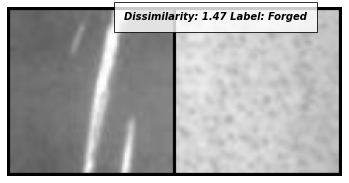

379 / 379
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_4.png',)]
/
_


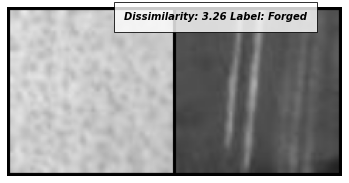

380 / 380
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_2.png',)]
/
_


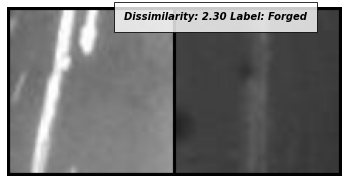

381 / 381
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_3.png',)]
/
_


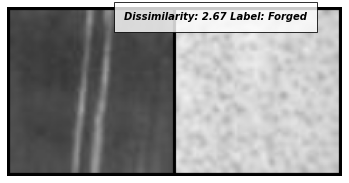

382 / 382
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_2.png',)]
/
_


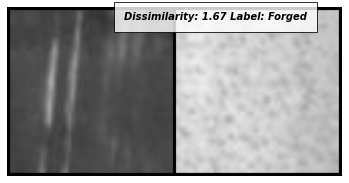

383 / 383
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_1.png',)]
/
_


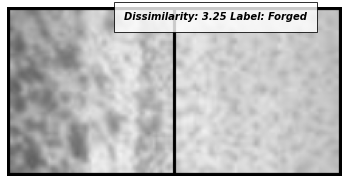

384 / 384
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',)]
/
/


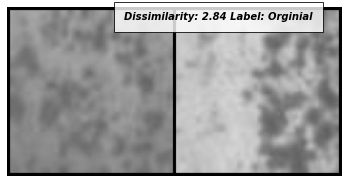

385 / 385
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_2.png',)]
/
_


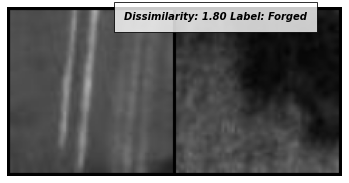

386 / 386
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_2.png',)]
/
_


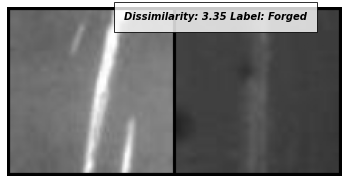

387 / 387
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',)]
/
/


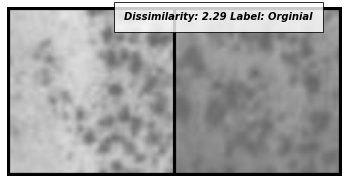

388 / 388
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_2.png',)]
/
_


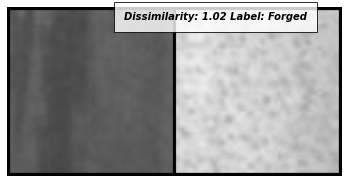

389 / 389
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_4.png',)]
/
_


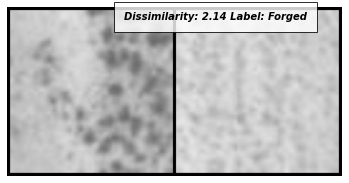

390 / 390
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_1.png',)]
/
_


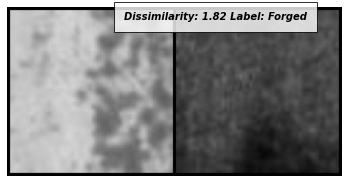

391 / 391
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_1.png',)]
/
_


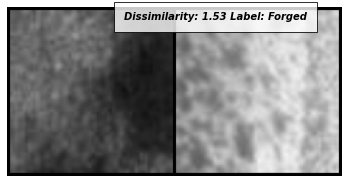

392 / 392
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_1.png',)]
/
_


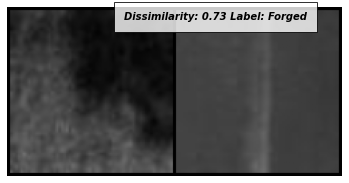

393 / 393
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_1.png',)]
/
_


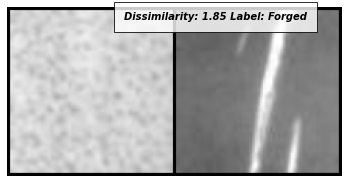

394 / 394
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_3.png',)]
/
_


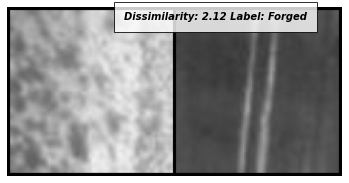

395 / 395
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',)]
/
/


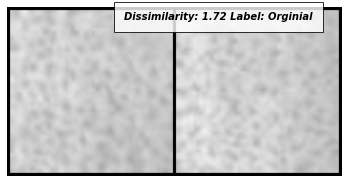

396 / 396
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_1.png',)]
/
_


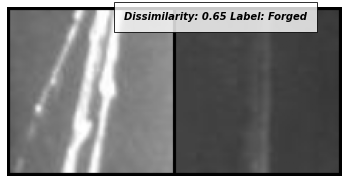

397 / 397
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_5.png',)]
/
_


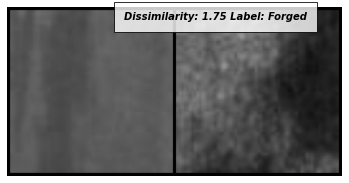

398 / 398
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_4.png',)]
/
_


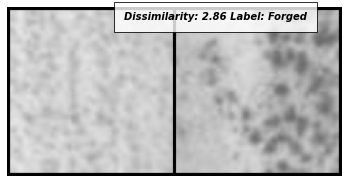

399 / 399
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_1.png',)]
/
_


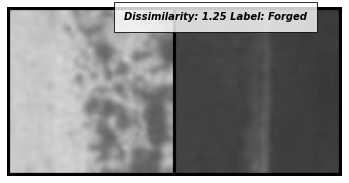

400 / 400
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_4.png',)]
/
_


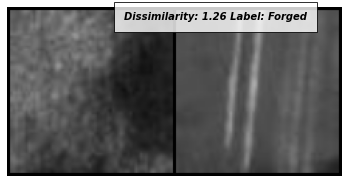

401 / 401
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_3.png',)]
/
_


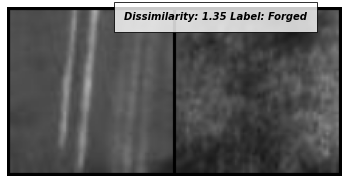

402 / 402
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_5.png',)]
/
_


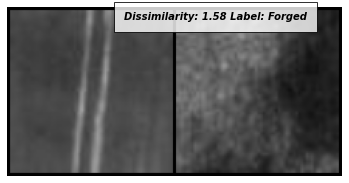

403 / 403
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_4.png',)]
/
_


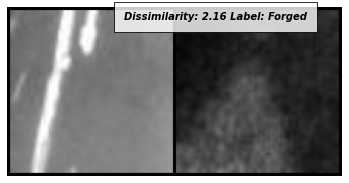

404 / 404
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_2.png',)]
/
_


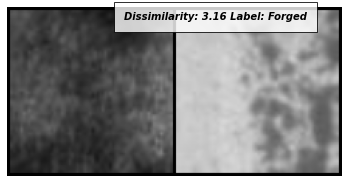

405 / 405
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_4.png',)]
/
_


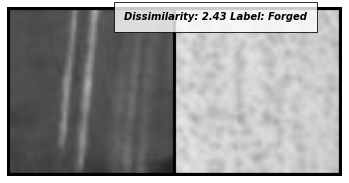

406 / 406
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_4.png',)]
/
_


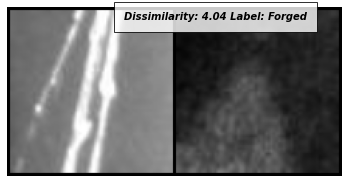

407 / 407
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_3.png',)]
/
_


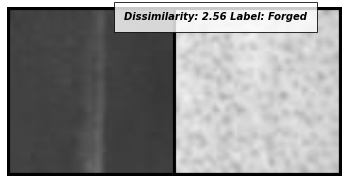

408 / 408
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_5.png',)]
/
_


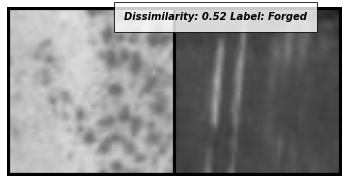

409 / 409
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_1.png',)]
/
_


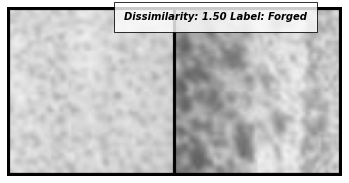

410 / 410
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_1.png',)]
/
_


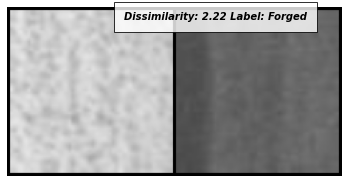

411 / 411
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_2.png',)]
/
_


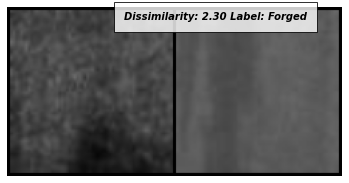

412 / 412
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_1.png',)]
/
_


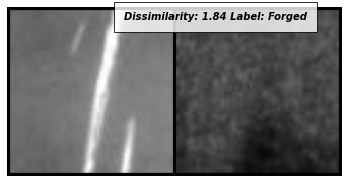

413 / 413
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_5.png',)]
/
_


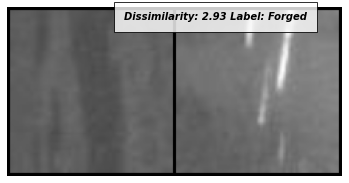

414 / 414
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_1.png',)]
/
_


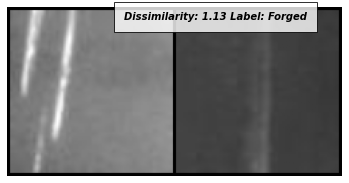

415 / 415
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_4.png',)]
/
_


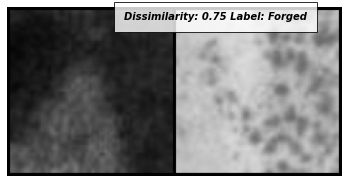

416 / 416
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_1.png',)]
/
_


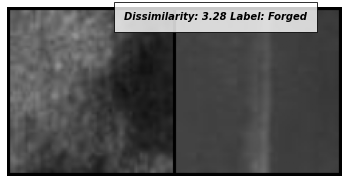

417 / 417
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_3.png',)]
/
_


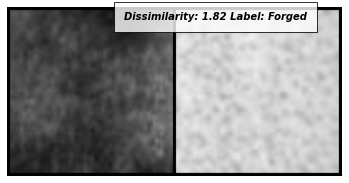

418 / 418
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_1.png',)]
/
_


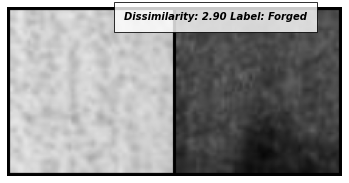

419 / 419
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_3.png',)]
/
_


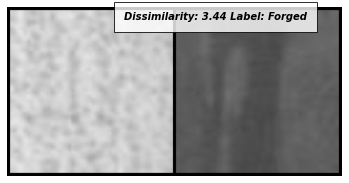

420 / 420
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',)]
/
/


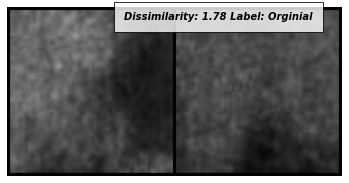

421 / 421
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',)]
/
/


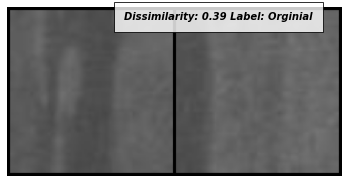

422 / 422
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_3.png',)]
/
_


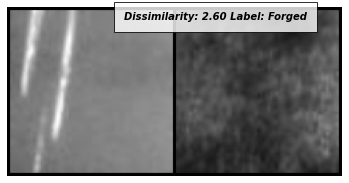

423 / 423
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_3.png',)]
/
_


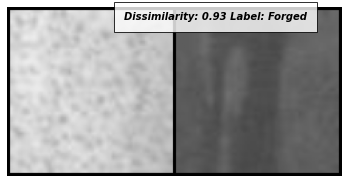

424 / 424
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_3.png',)]
/
_


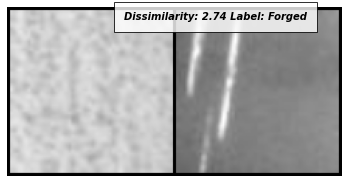

425 / 425
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_5.png',)]
/
_


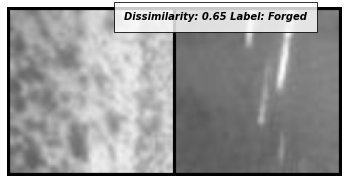

426 / 426
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_3.png',)]
/
_


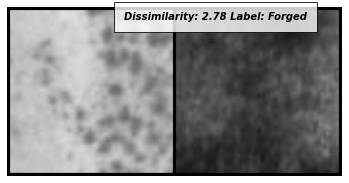

427 / 427
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_5.png',)]
/
_


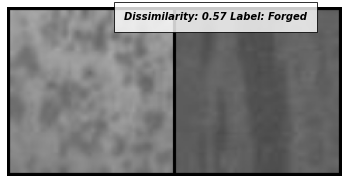

428 / 428
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_4.png',)]
/
_


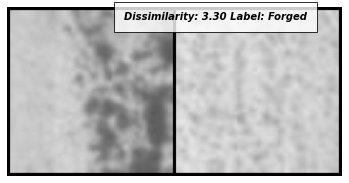

429 / 429
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_3.png',)]
/
_


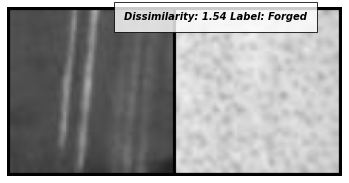

430 / 430
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_5.png',)]
/
_


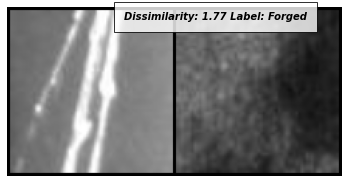

431 / 431
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_5.png',)]
/
_


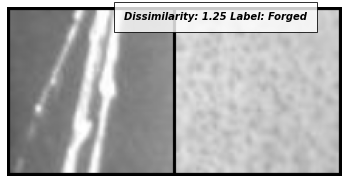

432 / 432
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_5.png',)]
/
_


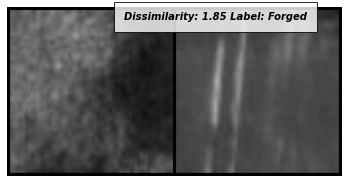

433 / 433
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_3.png',)]
/
_


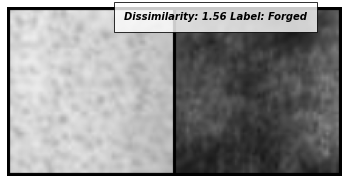

434 / 434
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_1.png',)]
/
_


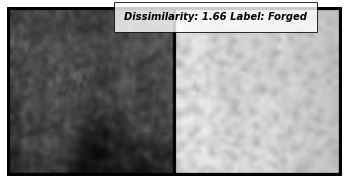

435 / 435
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',)]
/
/


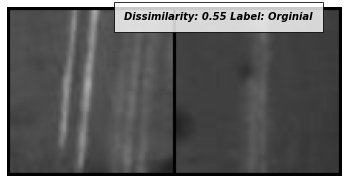

436 / 436
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_3.png',)]
/
_


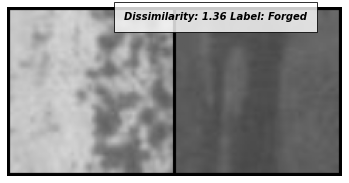

437 / 437
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_3.png',)]
/
_


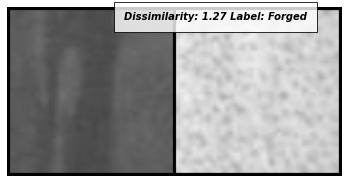

438 / 438
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_2.png',)]
/
_


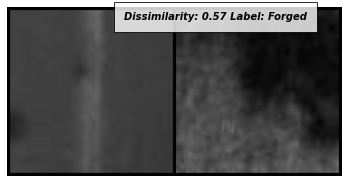

439 / 439
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_2.png',)]
/
_


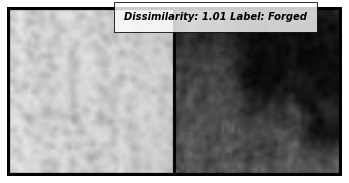

440 / 440
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',)]
/
/


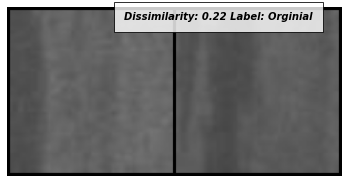

441 / 441
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_5.png',)]
/
_


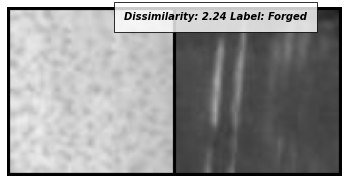

442 / 442
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_3.png',)]
/
_


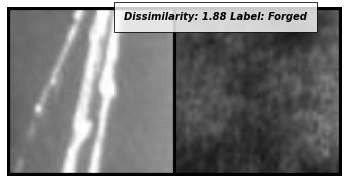

443 / 443
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_2.png',)]
/
_


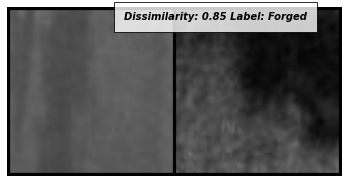

444 / 444
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_2.png',)]
/
_


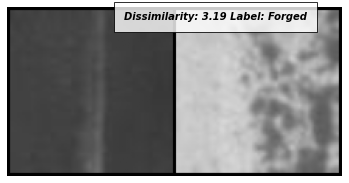

445 / 445
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_4.png',)]
/
_


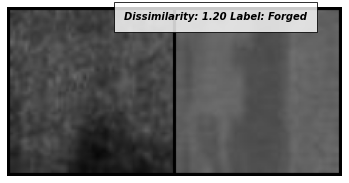

446 / 446
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_1.png',)]
/
_


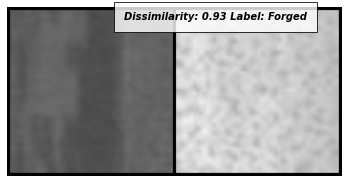

447 / 447
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_5.png',)]
/
_


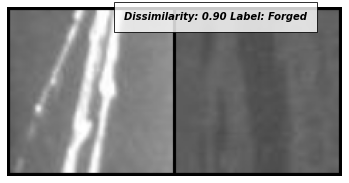

448 / 448
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_3.png',)]
/
_


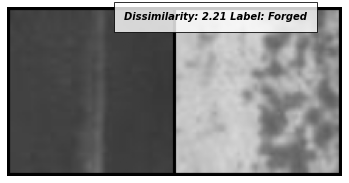

449 / 449
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_2.png',)]
/
_


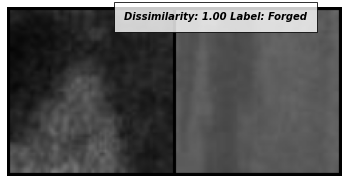

450 / 450
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_2.png',)]
/
_


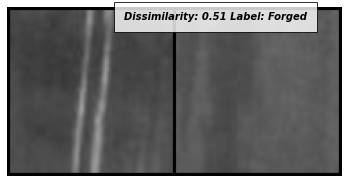

451 / 451
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_2.png',)]
/
_


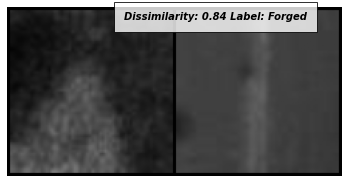

452 / 452
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_1.png',)]
/
_


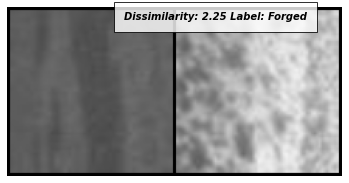

453 / 453
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_1.png',)]
/
_


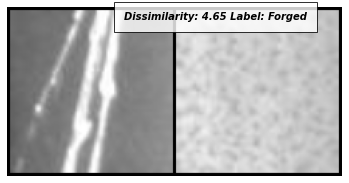

454 / 454
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_4.png',)]
/
_


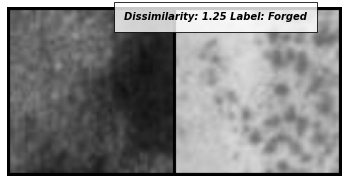

455 / 455
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',)]
/
/


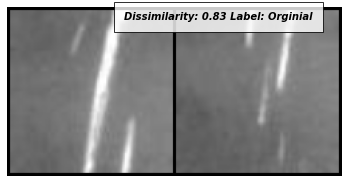

456 / 456
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_2.png',)]
/
_


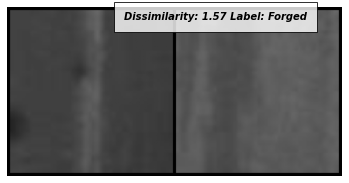

457 / 457
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_5.png',)]
/
_


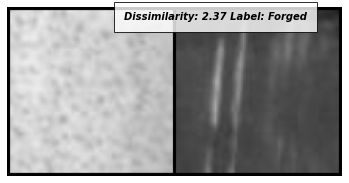

458 / 458
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_3.png',)]
/
_


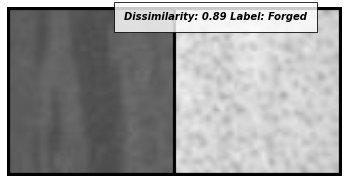

459 / 459
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_5.png',)]
/
_


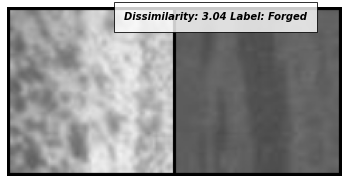

460 / 460
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_1.png',)]
/
_


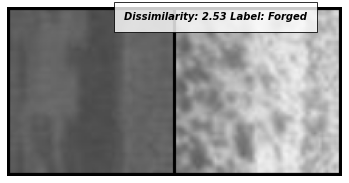

461 / 461
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_1.png',)]
/
_


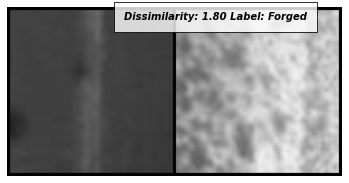

462 / 462
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_3.png',)]
/
_


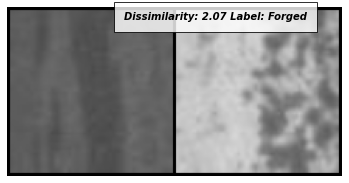

463 / 463
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_4.png',)]
/
_


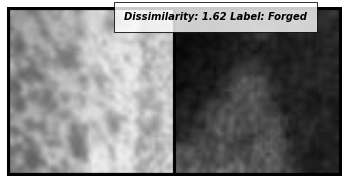

464 / 464
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_4.png',)]
/
_


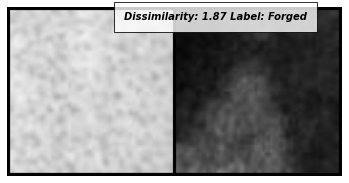

465 / 465
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_1.png',)]
/
_


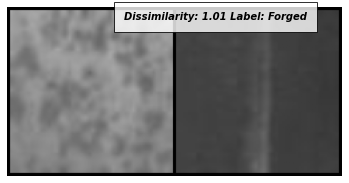

466 / 466
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',)]
/
/


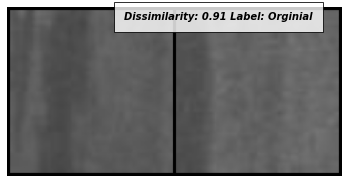

467 / 467
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_1.png',)]
/
_


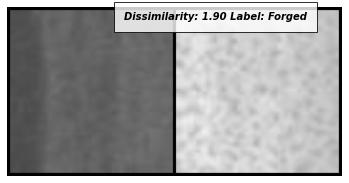

468 / 468
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_5.png',)]
/
_


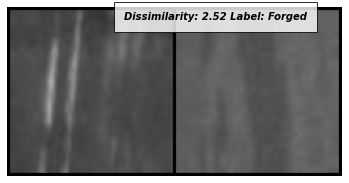

469 / 469
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',)]
/
/


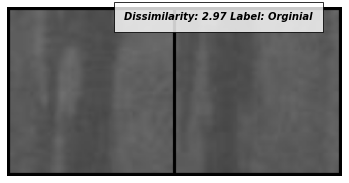

470 / 470
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_3.png',)]
/
_


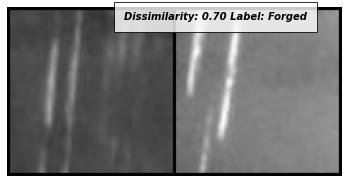

471 / 471
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',)]
/
/


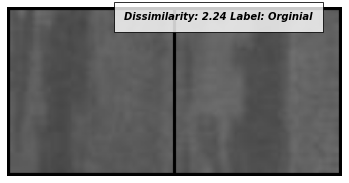

472 / 472
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_5.png',)]
/
_


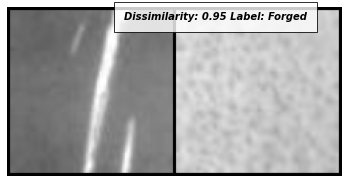

473 / 473
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_2.png',)]
/
_


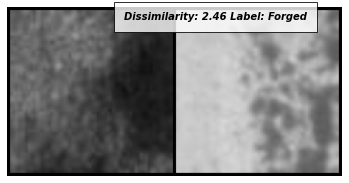

474 / 474
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_3.png',)]
/
_


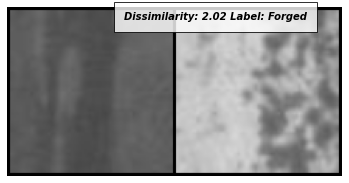

475 / 475
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_3.png',)]
/
_


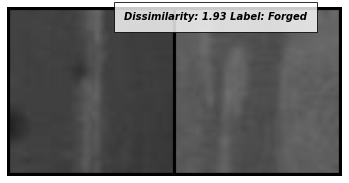

476 / 476
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_4.png',)]
/
_


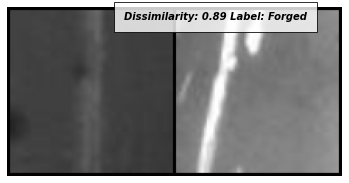

477 / 477
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_2.png',)]
/
_


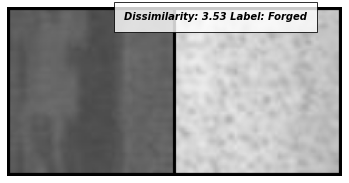

478 / 478
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_1.png',)]
/
_


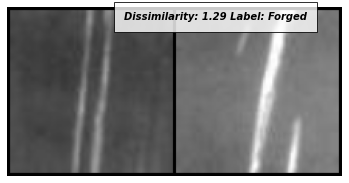

479 / 479
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_3.png',)]
/
_


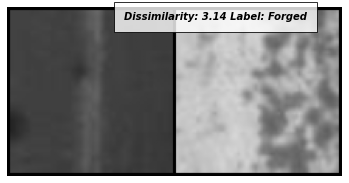

480 / 480
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_5.png',)]
/
_


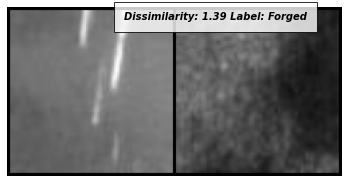

481 / 481
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_3.png',)]
/
_


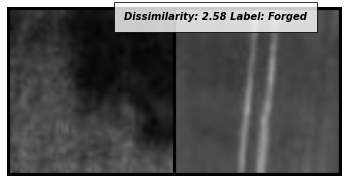

482 / 482
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_1.png',)]
/
_


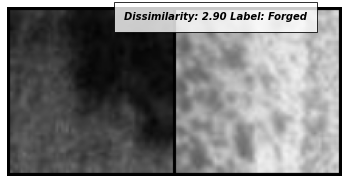

483 / 483
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_2.png',)]
/
_


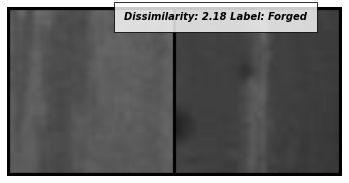

484 / 484
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_2.png',)]
/
_


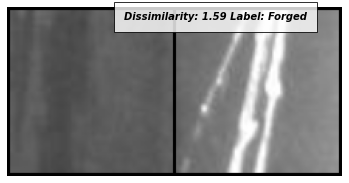

485 / 485
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_4.png',)]
/
_


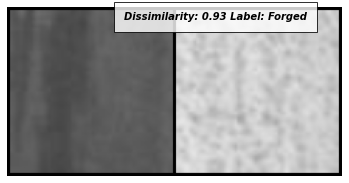

486 / 486
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_1.png',)]
/
_


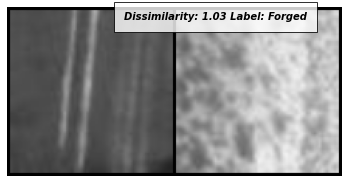

487 / 487
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_1.png',)]
/
_


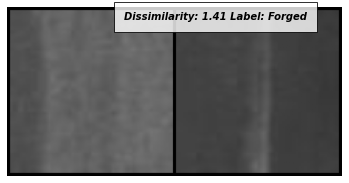

488 / 488
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_4.png',)]
/
_


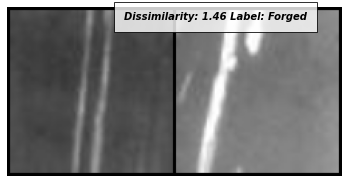

489 / 489
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_3.png',)]
/
_


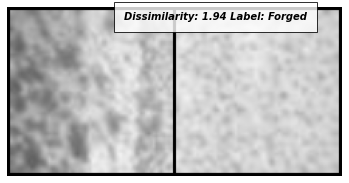

490 / 490
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_1.png',)]
/
_


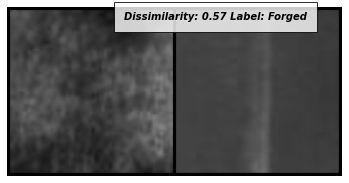

491 / 491
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_5.png',)]
/
_


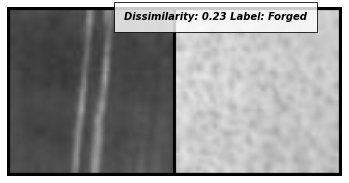

492 / 492
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_1.png',)]
/
_


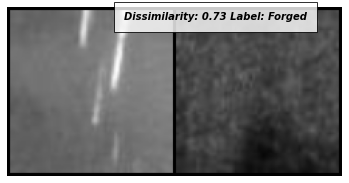

493 / 493
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_4.png',)]
/
_


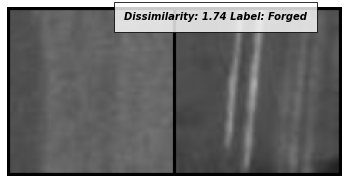

494 / 494
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_1.png',)]
/
_


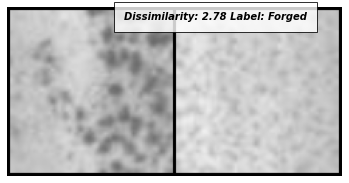

495 / 495
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',)]
/
/


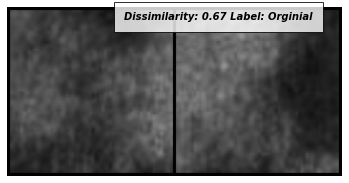

496 / 496
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_1.png',)]
/
_


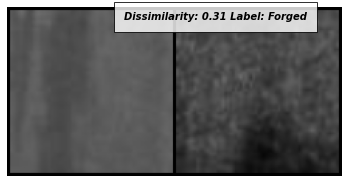

497 / 497
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_1.png',)]
/
_


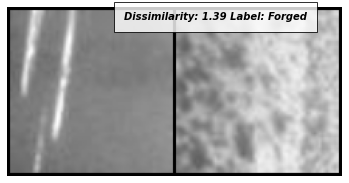

498 / 498
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_2.png',)]
/
_


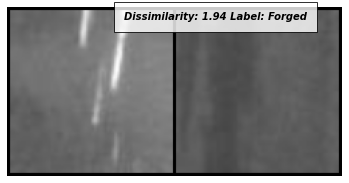

499 / 499
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',)]
/
/


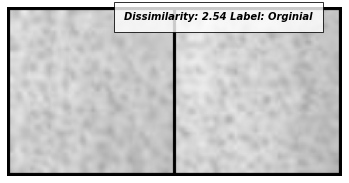

500 / 500
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_5.png',)]
/
_


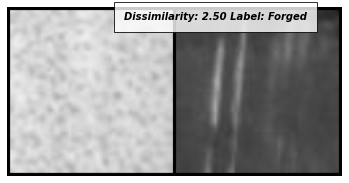

501 / 501
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_3.png',)]
/
_


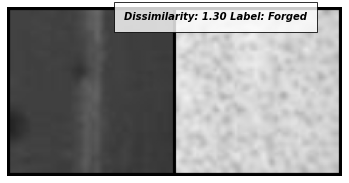

502 / 502
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_2.png',)]
/
_


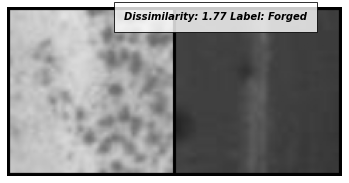

503 / 503
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_4.png',)]
/
_


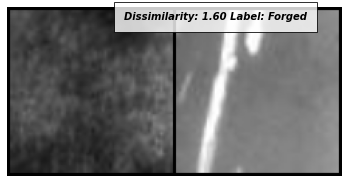

504 / 504
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_1.png',)]
/
_


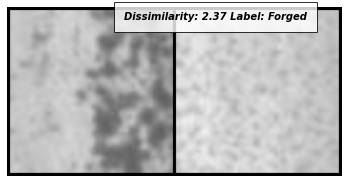

505 / 505
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_5.png',)]
/
_


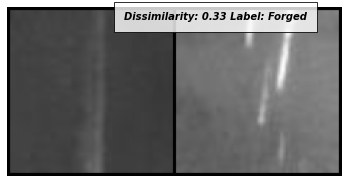

506 / 506
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_4.png',)]
/
_


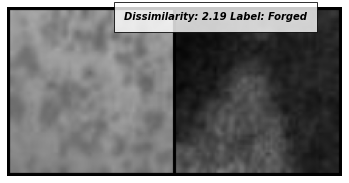

507 / 507
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_2.png',)]
/
_


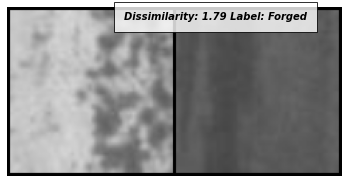

508 / 508
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_2.png',)]
/
_


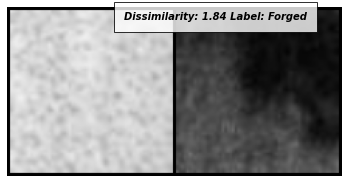

509 / 509
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_1.png',)]
/
_


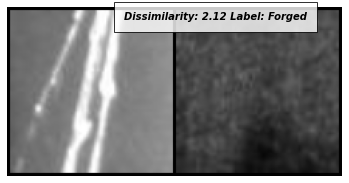

510 / 510
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_2.png',)]
/
_


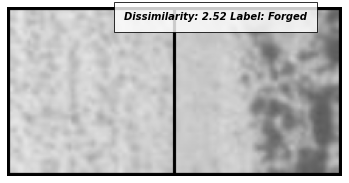

511 / 511
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_5.png',)]
/
_


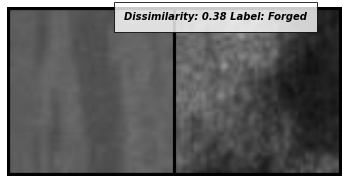

512 / 512
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_4.png',)]
/
_


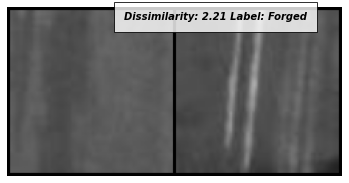

513 / 513
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_5.png',)]
/
_


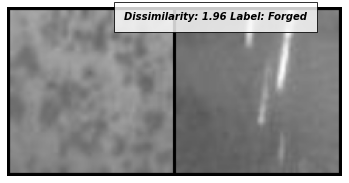

514 / 514
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_4.png',)]
/
_


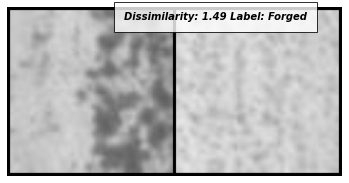

515 / 515
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_2.png',)]
/
_


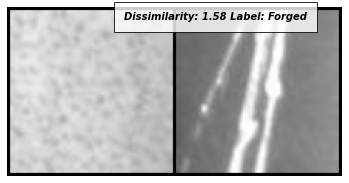

516 / 516
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_5.png',)]
/
_


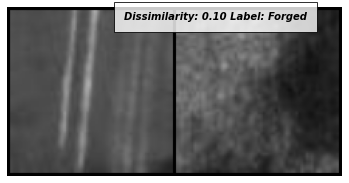

517 / 517
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_5.png',)]
/
_


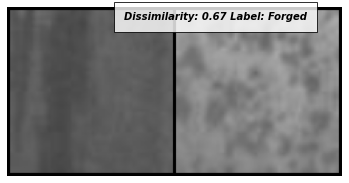

518 / 518
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_3.png',)]
/
_


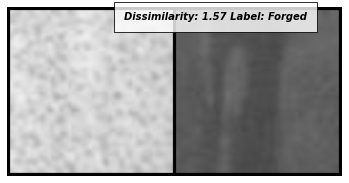

519 / 519
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_3.png',)]
/
_


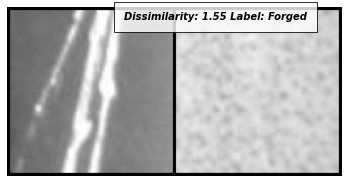

520 / 520
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',)]
/
/


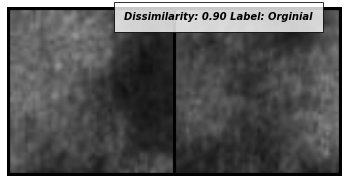

521 / 521
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_4.png',)]
/
_


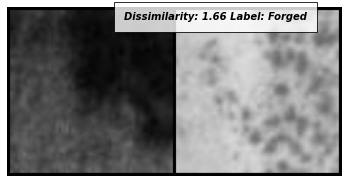

522 / 522
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_5.png',)]
/
_


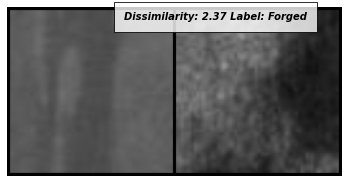

523 / 523
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_3.png',)]
/
_


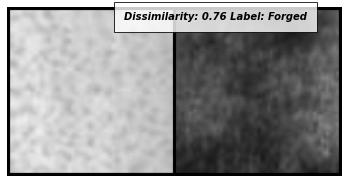

524 / 524
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_1.png',)]
/
_


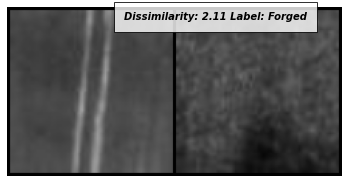

525 / 525
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_3.png',)]
/
_


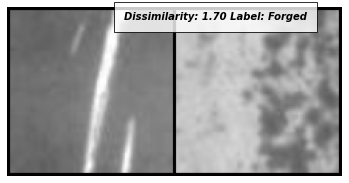

526 / 526
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',)]
/
/


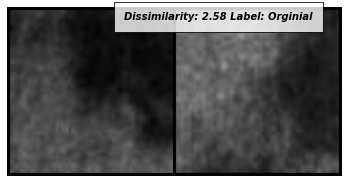

527 / 527
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_5.png',)]
/
_


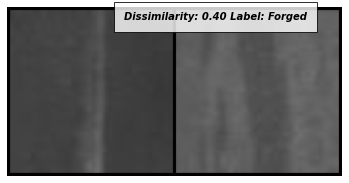

528 / 528
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_1.png',)]
/
_


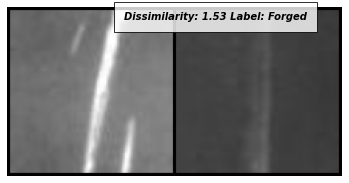

529 / 529
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_3.png',)]
/
_


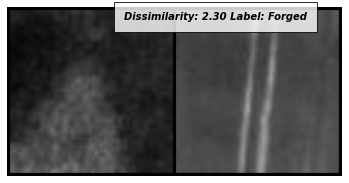

530 / 530
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_2.png',)]
/
_


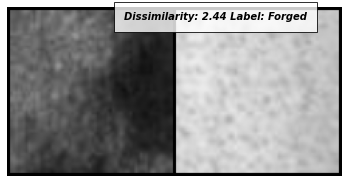

531 / 531
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_2.png',)]
/
_


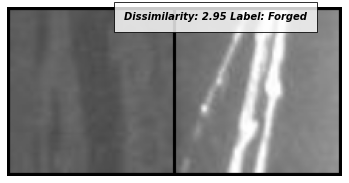

532 / 532
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_3.png',)]
/
_


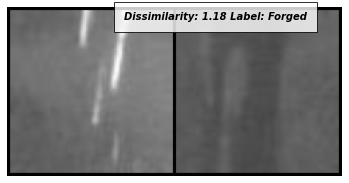

533 / 533
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_2.png',)]
/
_


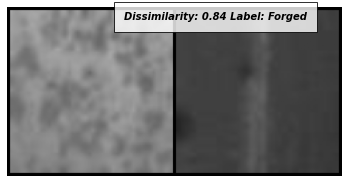

534 / 534
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_3.png',)]
/
_


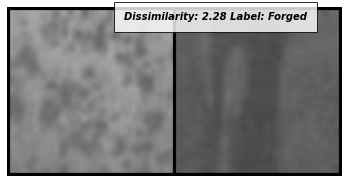

535 / 535
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_3.png',)]
/
_


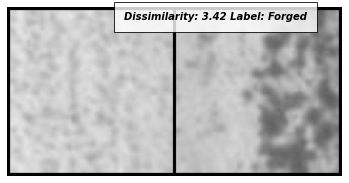

536 / 536
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_4.png',)]
/
_


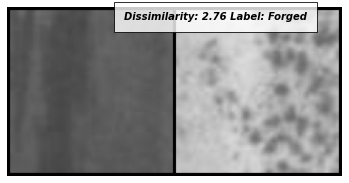

537 / 537
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',)]
/
/


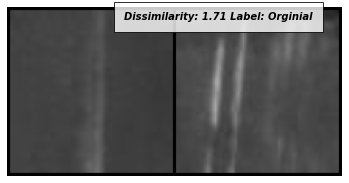

538 / 538
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',)]
/
/


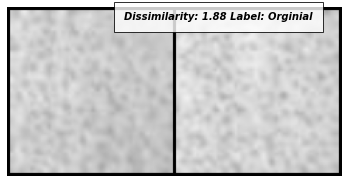

539 / 539
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_5.png',)]
/
_


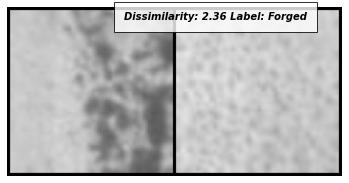

540 / 540
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_3.png',)]
/
_


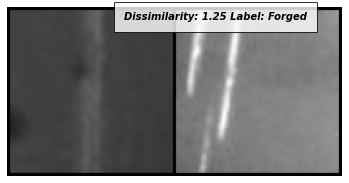

541 / 541
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_2.png',)]
/
_


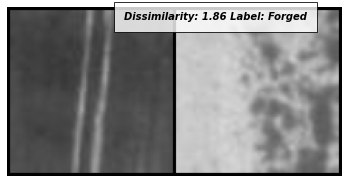

542 / 542
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_4.png',)]
/
_


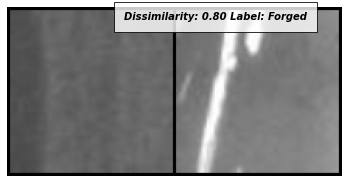

543 / 543
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_4.png',)]
/
_


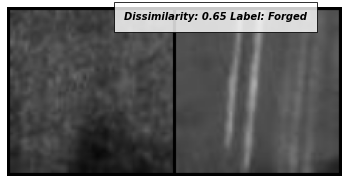

544 / 544
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_4.png',)]
/
_


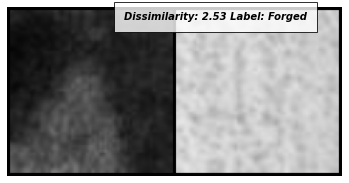

545 / 545
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_4.png',)]
/
_


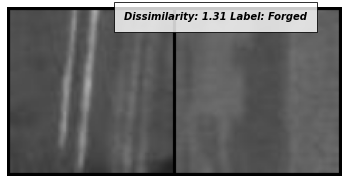

546 / 546
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',)]
/
/


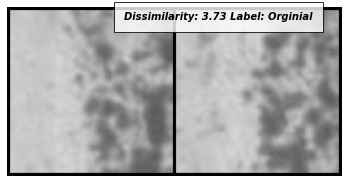

547 / 547
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_5.png',)]
/
_


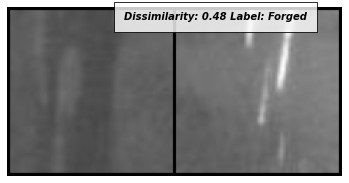

548 / 548
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_4.png',)]
/
_


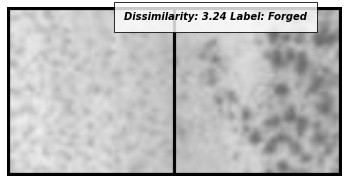

549 / 549
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_5.png',)]
/
_


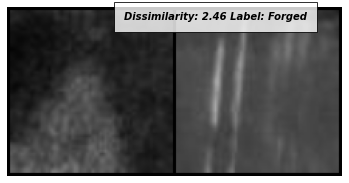

550 / 550
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_4.png',)]
/
_


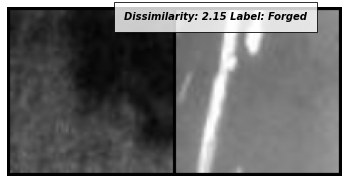

551 / 551
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_3.png',)]
/
_


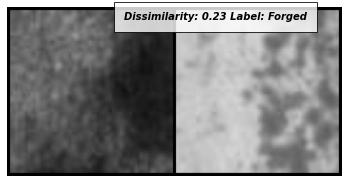

552 / 552
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_4.png',)]
/
_


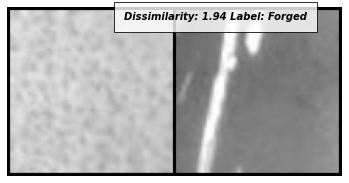

553 / 553
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_1.png',)]
/
_


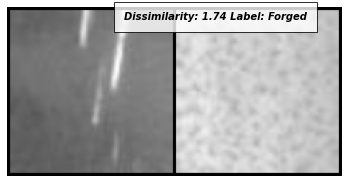

554 / 554
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_3.png',)]
/
_


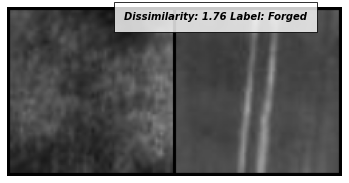

555 / 555
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_3.png',)]
/
_


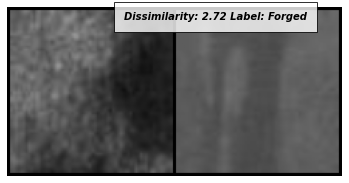

556 / 556
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',)]
/
/


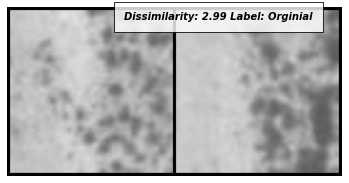

557 / 557
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_4.png',)]
/
_


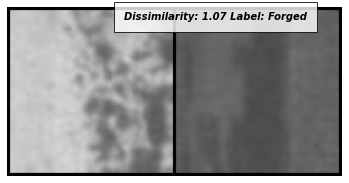

558 / 558
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_4.png',)]
/
_


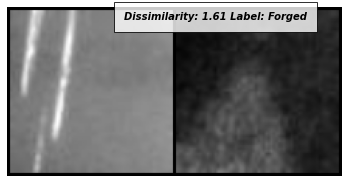

559 / 559
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_3.png',)]
/
_


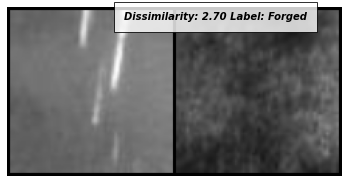

560 / 560
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_4.png',)]
/
_


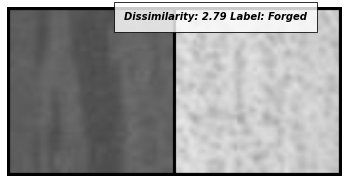

561 / 561
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_3.png',)]
/
_


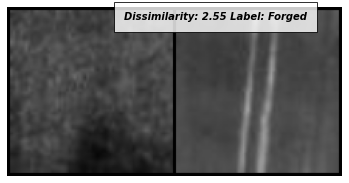

562 / 562
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_2.png',)]
/
_


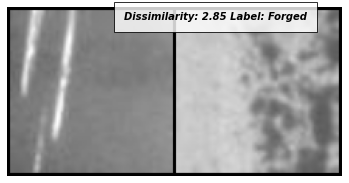

563 / 563
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_5.png',)]
/
_


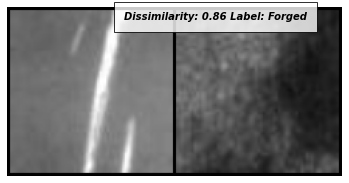

564 / 564
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_4.png',)]
/
_


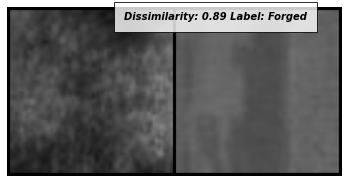

565 / 565
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_2.png',)]
/
_


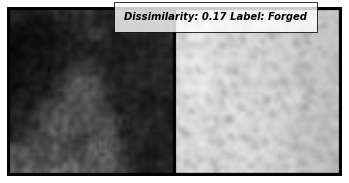

566 / 566
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_4.png',)]
/
_


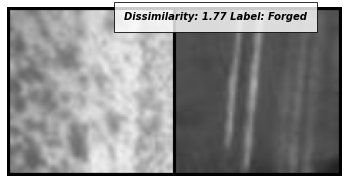

567 / 567
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_4.png',)]
/
_


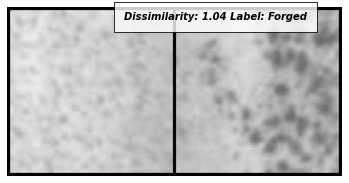

568 / 568
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_5.png',)]
/
_


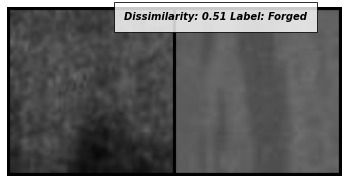

569 / 569
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_4.png',)]
/
_


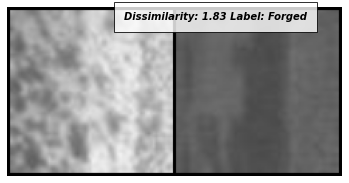

570 / 570
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_1.png',)]
/
_


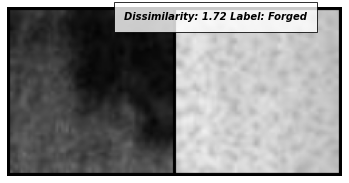

571 / 571
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_5.png',)]
/
_


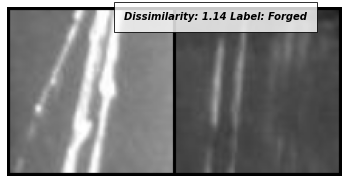

572 / 572
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_5.png',)]
/
_


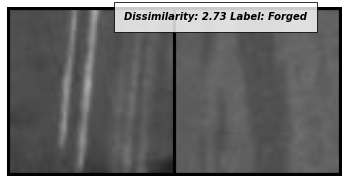

573 / 573
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_2.png',)]
/
_


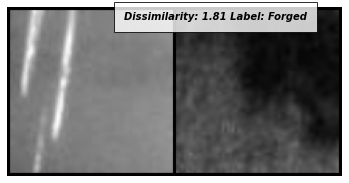

574 / 574
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',)]
/
/


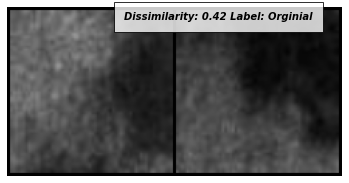

575 / 575
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_2.png',)]
/
_


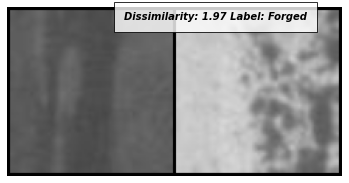

576 / 576
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_1.png',)]
/
_


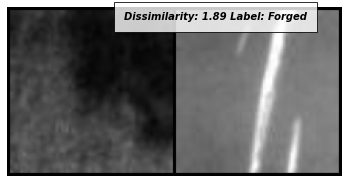

577 / 577
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_2.png',)]
/
_


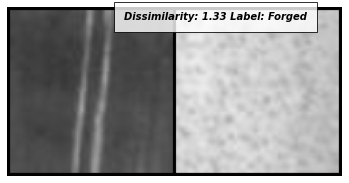

578 / 578
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_2.png',)]
/
_


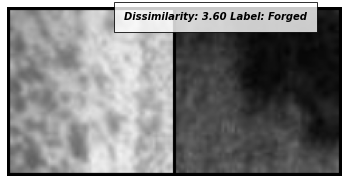

579 / 579
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_1.png',)]
/
_


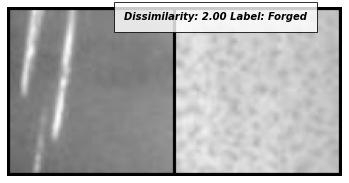

580 / 580
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_2.png',)]
/
_


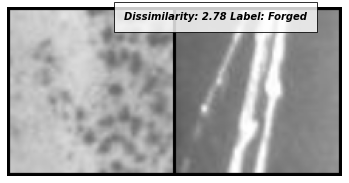

581 / 581
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_5.png',)]
/
_


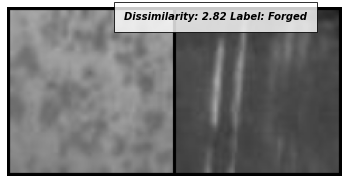

582 / 582
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_5.png',)]
/
_


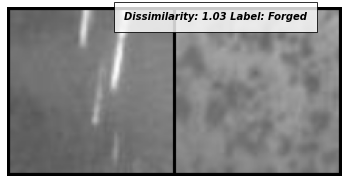

583 / 583
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_3.png',)]
/
_


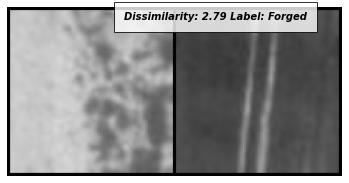

584 / 584
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_3.png',)]
/
_


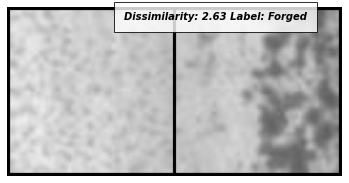

585 / 585
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_5.png',)]
/
_


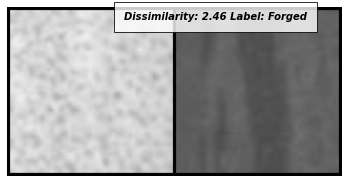

586 / 586
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_3.png',)]
/
_


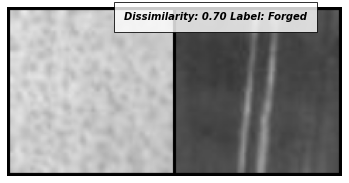

587 / 587
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',)]
/
/


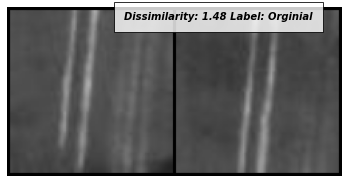

588 / 588
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_2.png',)]
/
_


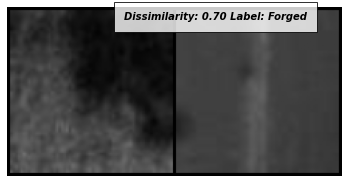

589 / 589
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_2.png',)]
/
_


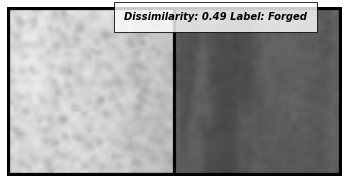

590 / 590
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_2.png',)]
/
_


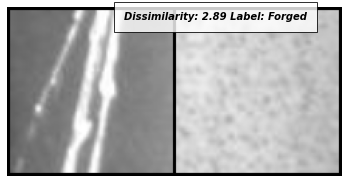

591 / 591
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_3.png',)]
/
_


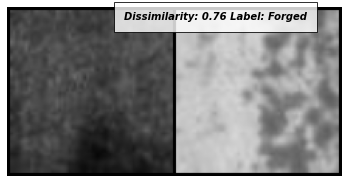

592 / 592
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_5.png',)]
/
_


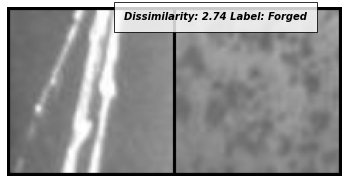

593 / 593
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_3.png',)]
/
_


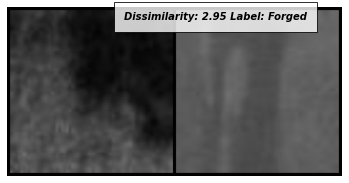

594 / 594
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_2.png',)]
/
_


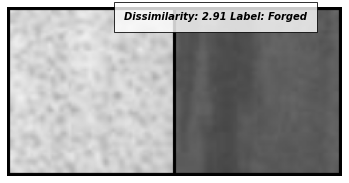

595 / 595
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_2.png',)]
/
_


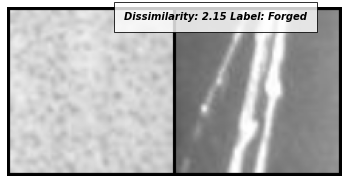

596 / 596
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_3.png',)]
/
_


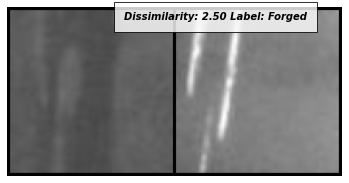

597 / 597
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',)]
/
/


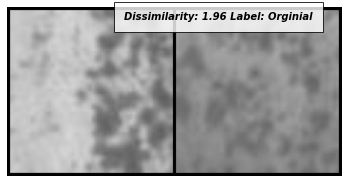

598 / 598
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_4.png',)]
/
_


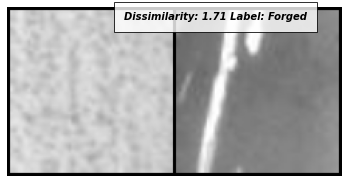

599 / 599
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_2.png',)]
/
_


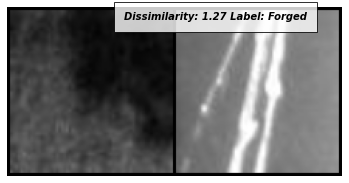

600 / 600
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_3.png',)]
/
_


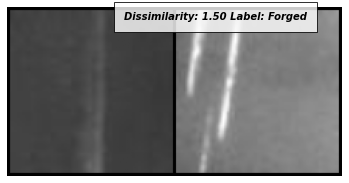

601 / 601
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_1.png',)]
/
_


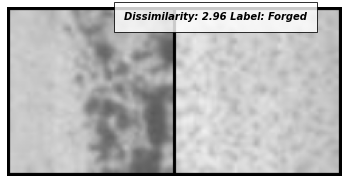

602 / 602
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_4.png',)]
/
_


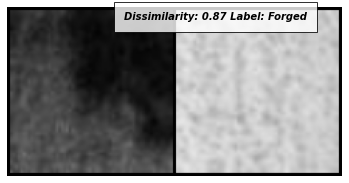

603 / 603
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',)]
/
/


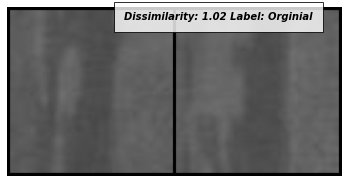

604 / 604
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_5.png',)]
/
_


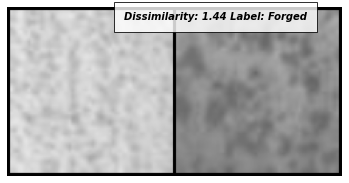

605 / 605
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_5.png',)]
/
_


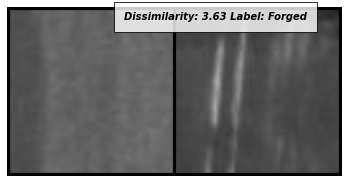

606 / 606
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_4.png',)]
/
_


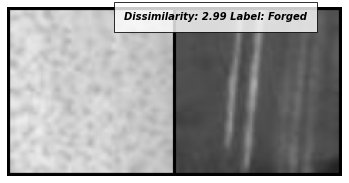

607 / 607
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',)]
/
/


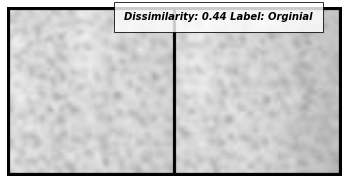

608 / 608
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_1.png',)]
/
_


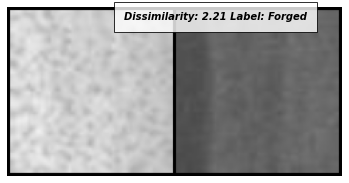

609 / 609
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_3.png',)]
/
_


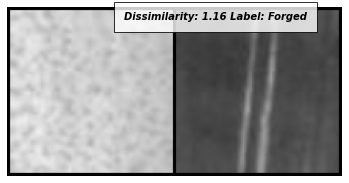

610 / 610
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_3.png',)]
/
_


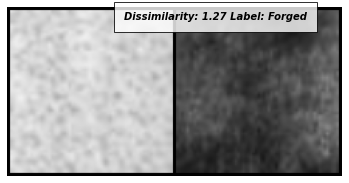

611 / 611
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_4.png',)]
/
_


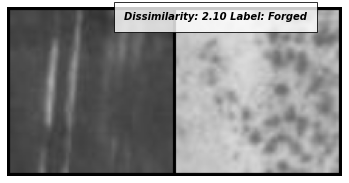

612 / 612
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_3.png',)]
/
_


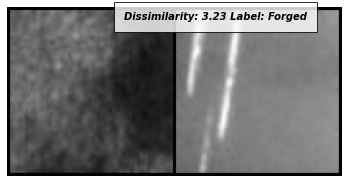

613 / 613
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_5.png',)]
/
_


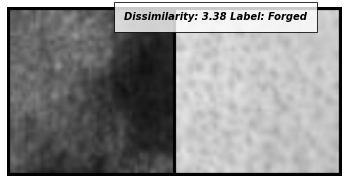

614 / 614
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_3.png',)]
/
_


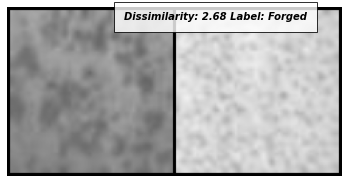

615 / 615
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_4.png',)]
/
_


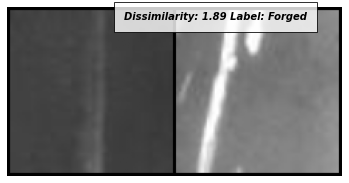

616 / 616
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_4.png',)]
/
_


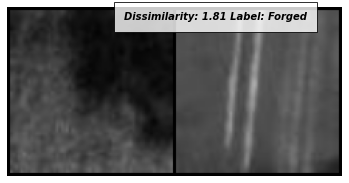

617 / 617
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',)]
/
/


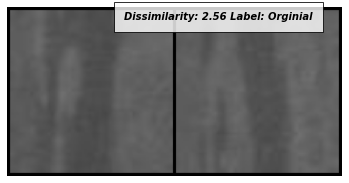

618 / 618
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_2.png',)]
/
_


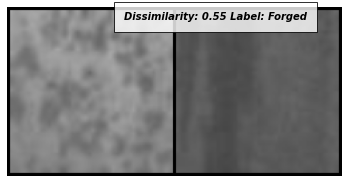

619 / 619
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_1.png',)]
/
_


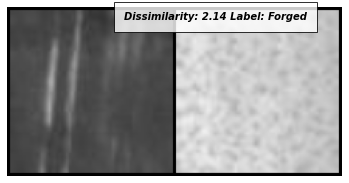

620 / 620
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_4.png',)]
/
_


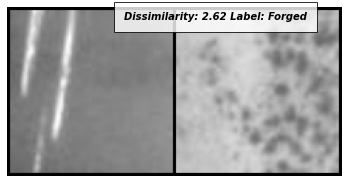

621 / 621
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_3.png',)]
/
_


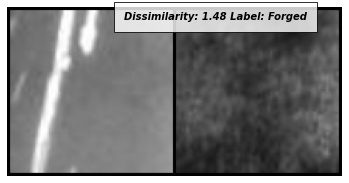

622 / 622
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_3.png',)]
/
_


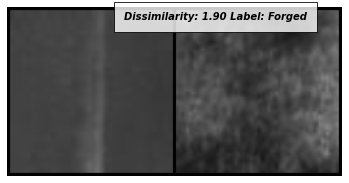

623 / 623
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_5.png',)]
/
_


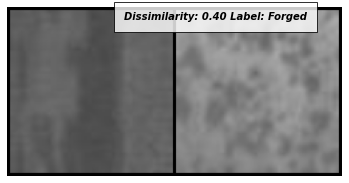

624 / 624
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_4.png',)]
/
_


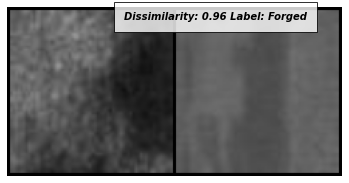

625 / 625
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',)]
/
/


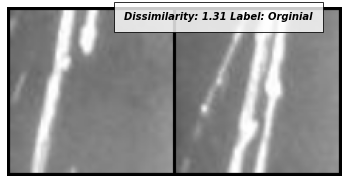

626 / 626
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_4.png',)]
/
_


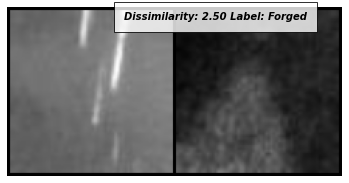

627 / 627
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_4.png',)]
/
_


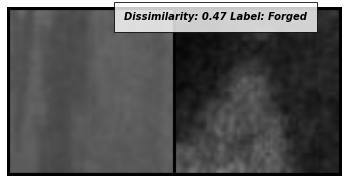

628 / 628
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_5.png',)]
/
_


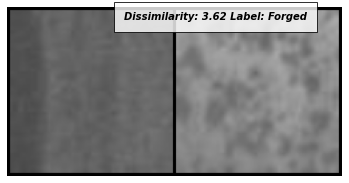

629 / 629
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_4.png',)]
/
_


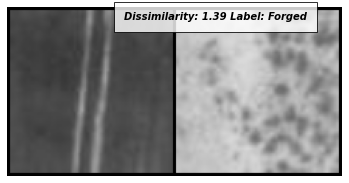

630 / 630
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_3.png',)]
/
_


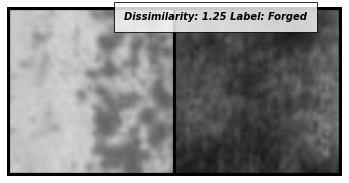

631 / 631
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_2.png',)]
/
_


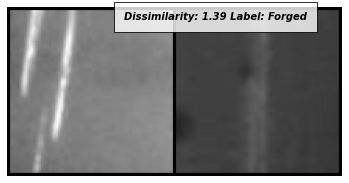

632 / 632
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_1.png',)]
/
_


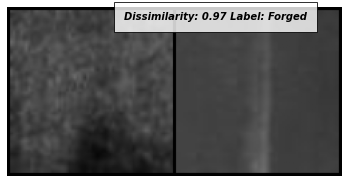

633 / 633
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_1.png',)]
/
_


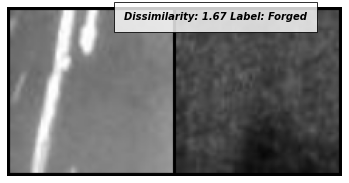

634 / 634
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_5.png',)]
/
_


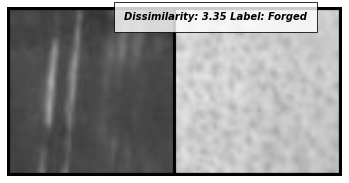

635 / 635
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_2.png',)]
/
_


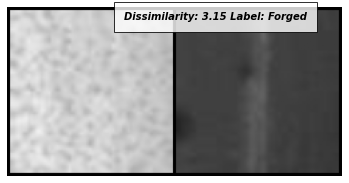

636 / 636
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_5.png',)]
/
_


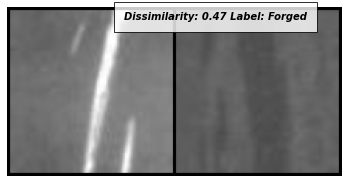

637 / 637
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_4.png',)]
/
_


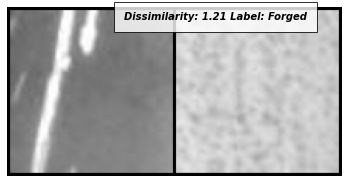

638 / 638
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_2.png',)]
/
_


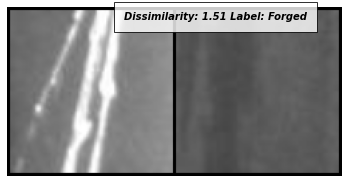

639 / 639
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_5.png',)]
/
_


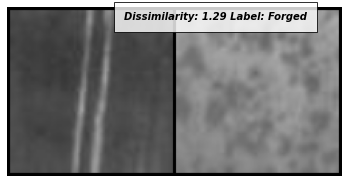

640 / 640
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_5.png',)]
/
_


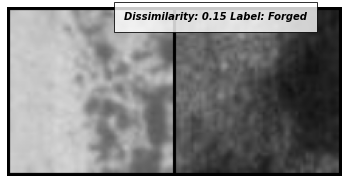

641 / 641
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_2.png',)]
/
_


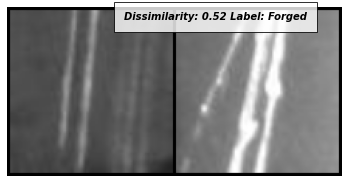

642 / 642
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_4.png',)]
/
_


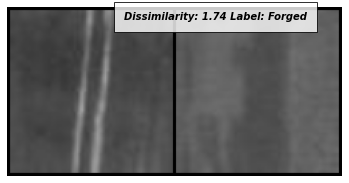

643 / 643
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',)]
/
/


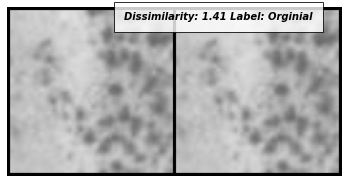

644 / 644
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',)]
/
/


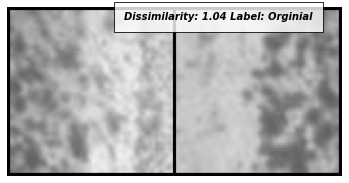

645 / 645
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_2.png',)]
/
_


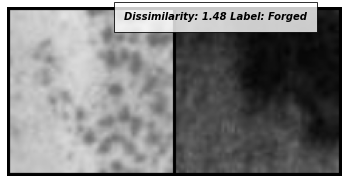

646 / 646
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_2.png',)]
/
_


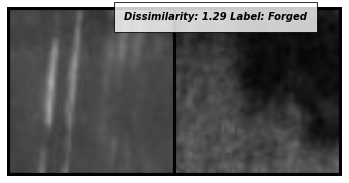

647 / 647
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',)]
/
/


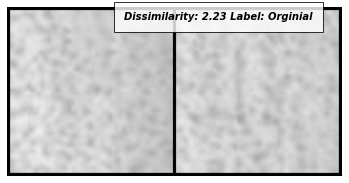

648 / 648
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_5.png',)]
/
_


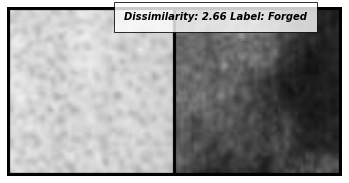

649 / 649
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_2.png',)]
/
_


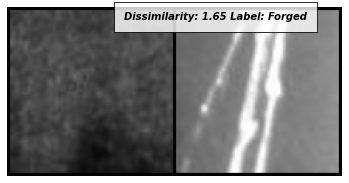

650 / 650
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_3.png',)]
/
_


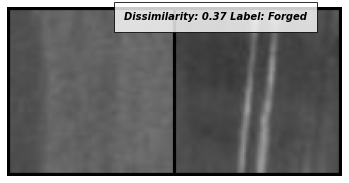

651 / 651
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_2.png',)]
/
_


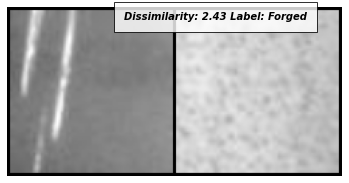

652 / 652
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_5.png',)]
/
_


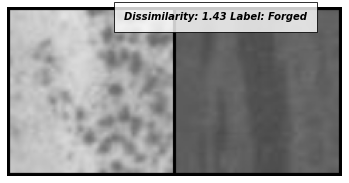

653 / 653
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',)]
/
/


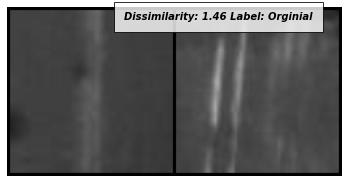

654 / 654
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_3.png',)]
/
_


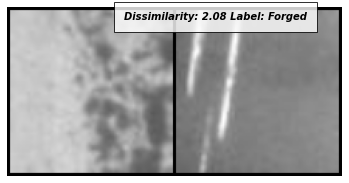

655 / 655
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',)]
/
/


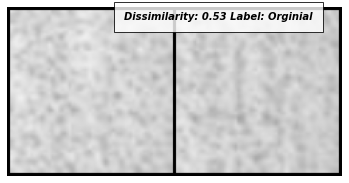

656 / 656
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_5.png',)]
/
_


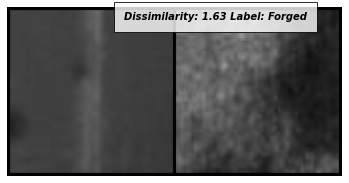

657 / 657
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_3.png',)]
/
_


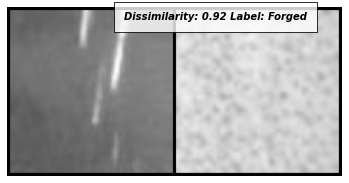

658 / 658
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_1.png',)]
/
_


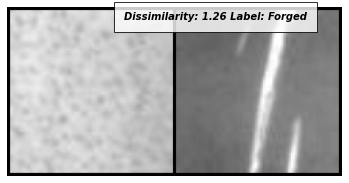

659 / 659
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_3.png',)]
/
_


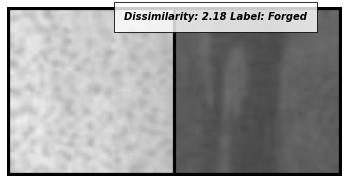

660 / 660
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_2.png',)]
/
_


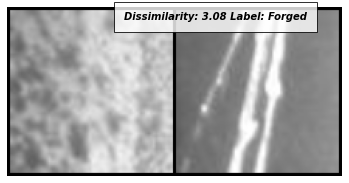

661 / 661
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_5.png',)]
/
_


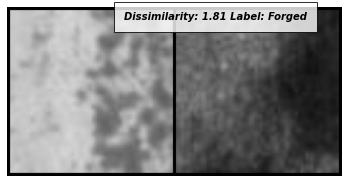

662 / 662
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',)]
/
/


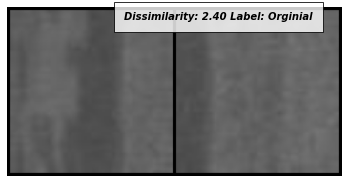

663 / 663
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_4.png',)]
/
_


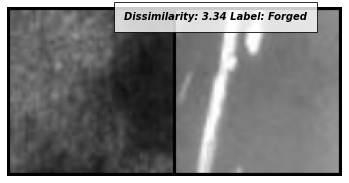

664 / 664
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',)]
/
/


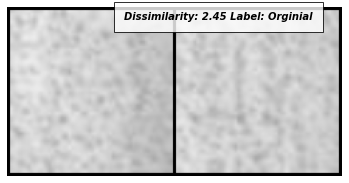

665 / 665
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_3.png',)]
/
_


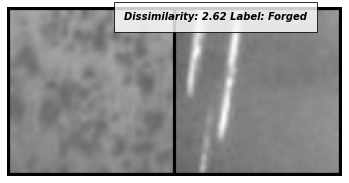

666 / 666
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',)]
/
/


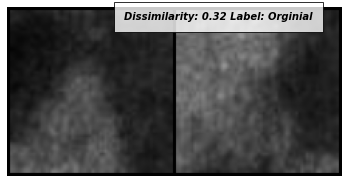

667 / 667
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_3.png',)]
/
_


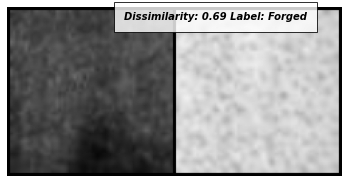

668 / 668
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_3.png',)]
/
_


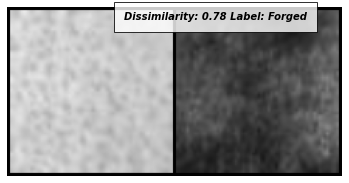

669 / 669
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_4.png',)]
/
_


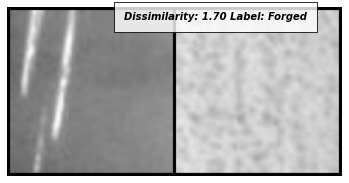

670 / 670
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_4.png',)]
/
_


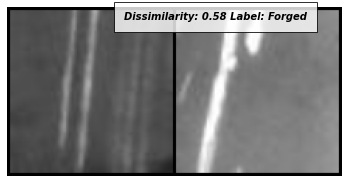

671 / 671
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_2.png',)]
/
_


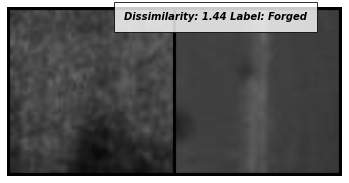

672 / 672
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_4.png',)]
/
_


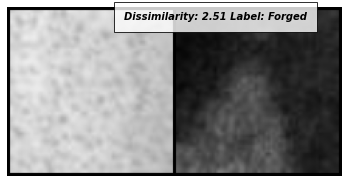

673 / 673
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_3.png',)]
/
_


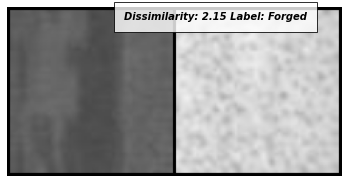

674 / 674
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_4.png',)]
/
_


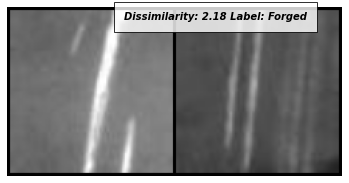

675 / 675
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',)]
/
/


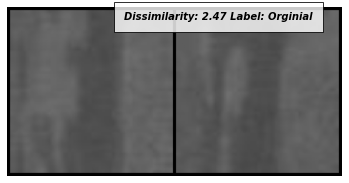

676 / 676
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',)]
/
/


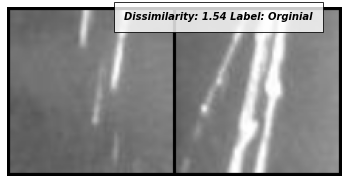

677 / 677
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_5.png',)]
/
_


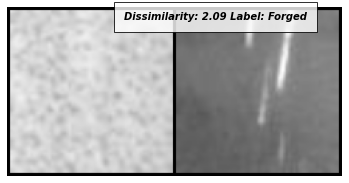

678 / 678
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_5.png',)]
/
_


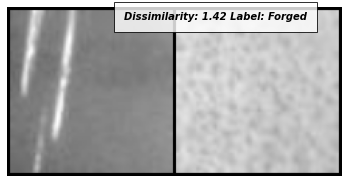

679 / 679
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_1.png',)]
/
_


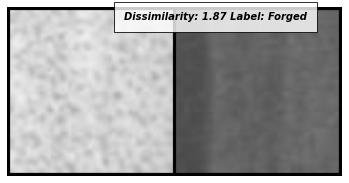

680 / 680
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_4.png',)]
/
_


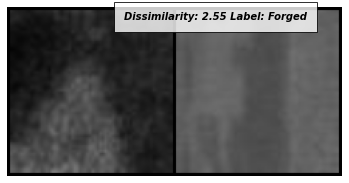

681 / 681
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_3.png',)]
/
_


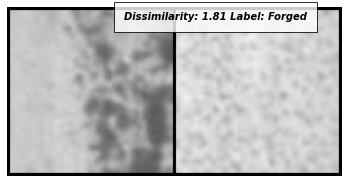

682 / 682
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_3.png',)]
/
_


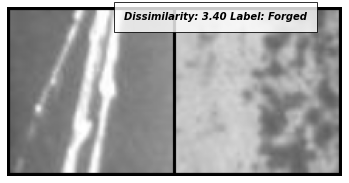

683 / 683
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_4.png',)]
/
_


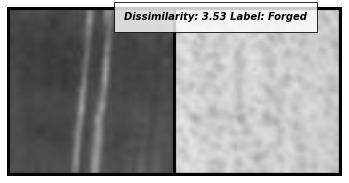

684 / 684
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_3.png',)]
/
_


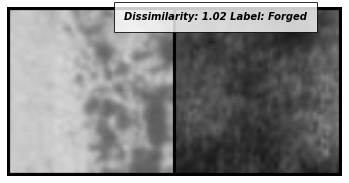

685 / 685
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_2.png',)]
/
_


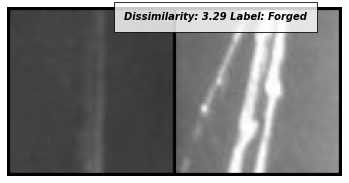

686 / 686
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_5.png',)]
/
_


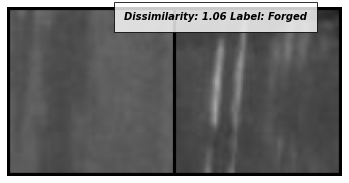

687 / 687
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_2.png',)]
/
_


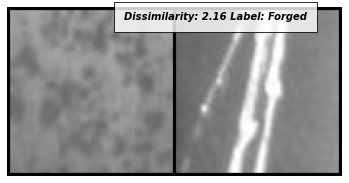

688 / 688
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_5.png',)]
/
_


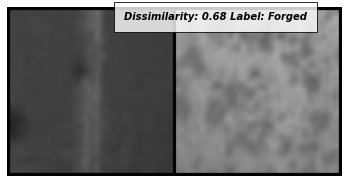

689 / 689
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',)]
/
/


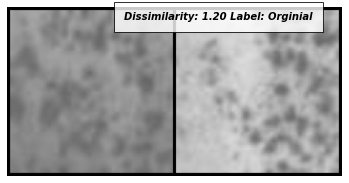

690 / 690
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_2.png',)]
/
_


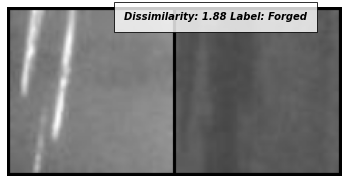

691 / 691
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_5.png',)]
/
_


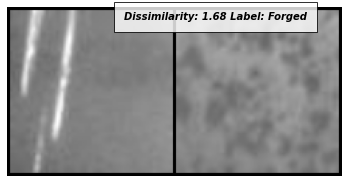

692 / 692
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_2.png',)]
/
_


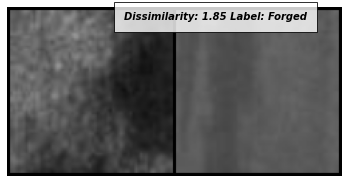

693 / 693
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_1.png',)]
/
_


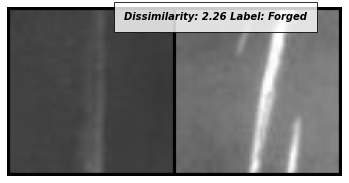

694 / 694
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',)]
/
/


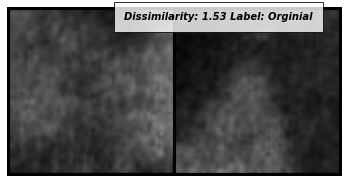

695 / 695
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',)]
/
/


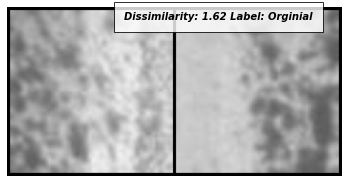

696 / 696
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_1.png',)]
/
_


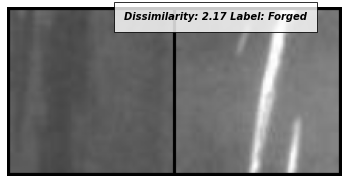

697 / 697
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_4.png',)]
/
_


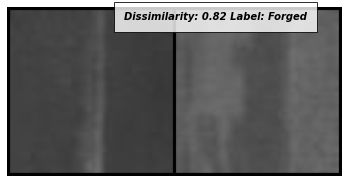

698 / 698
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_2.png',)]
/
_


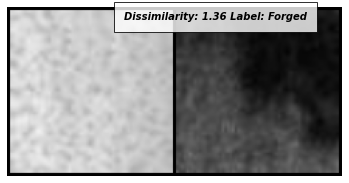

699 / 699
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_4.png',)]
/
_


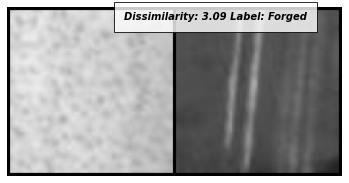

700 / 700
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_5.png',)]
/
_


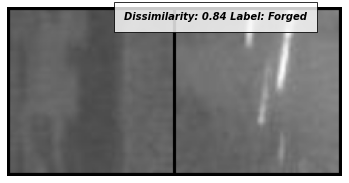

701 / 701
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_2.png',)]
/
_


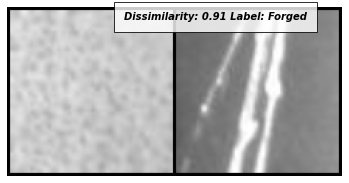

702 / 702
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_5.png',)]
/
_


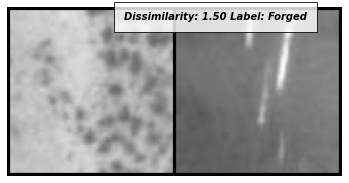

703 / 703
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_2.png',)]
/
_


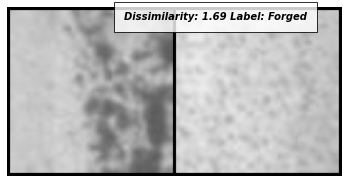

704 / 704
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_2.png',)]
/
_


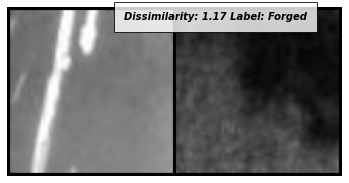

705 / 705
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sc_2.png',)]
/
_


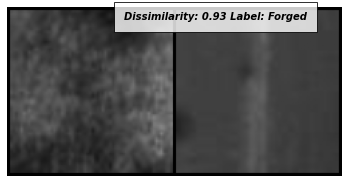

706 / 706
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_2.png',)]
/
_


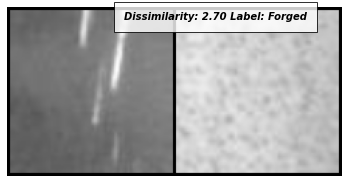

707 / 707
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_2.png',)]
/
_


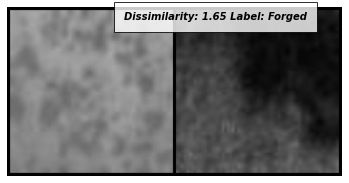

708 / 708
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_4.png',)]
/
_


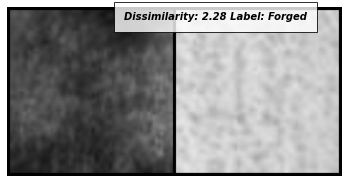

709 / 709
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_5.png',)]
/
_


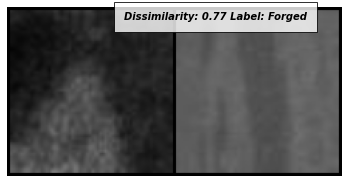

710 / 710
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_5.png',)]
/
_


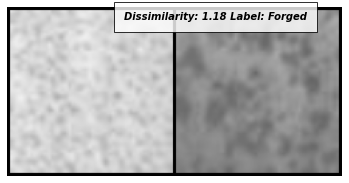

711 / 711
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_4.png',)]
/
_


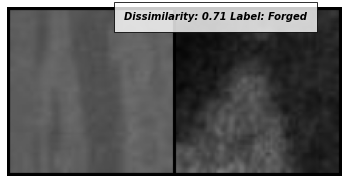

712 / 712
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_5.png',)]
/
_


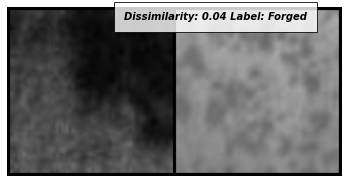

713 / 713
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_2.png',)]
/
_


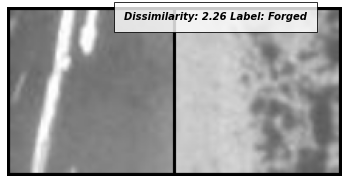

714 / 714
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_3.png',)]
/
_


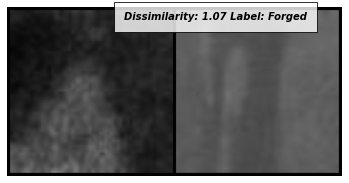

715 / 715
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_1.png',)]
/
_


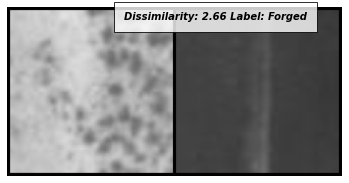

716 / 716
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',)]
/
/


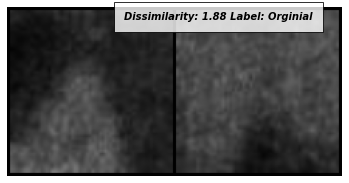

717 / 717
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_4.png',)]
/
_


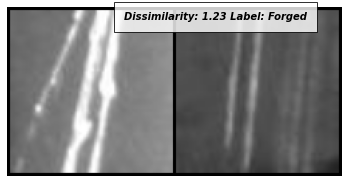

718 / 718
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_2.png',)]
/
_


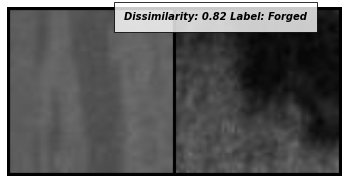

719 / 719
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_2.png',)]
/
_


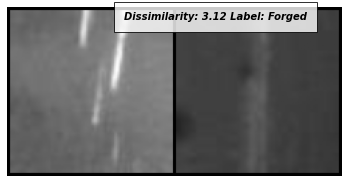

720 / 720
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_4.png',)]
/
_


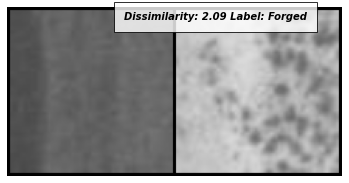

721 / 721
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_4.png',)]
/
_


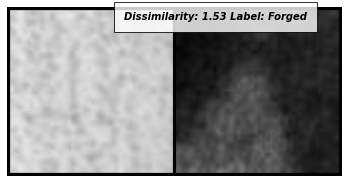

722 / 722
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_1.png',)]
/
_


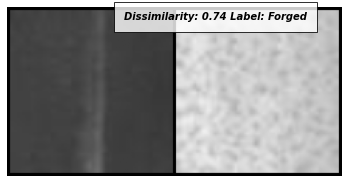

723 / 723
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_4.png',)]
/
_


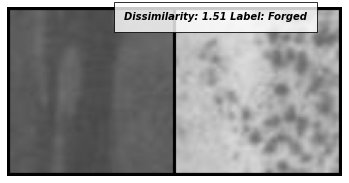

724 / 724
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_2.png',)]
/
_


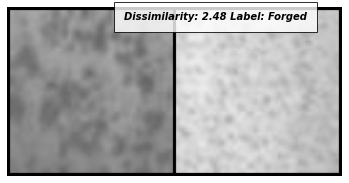

725 / 725
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_1.png',)]
/
_


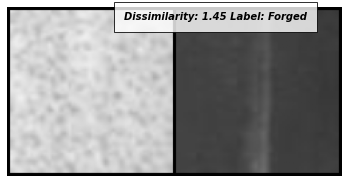

726 / 726
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_3.png',)]
/
_


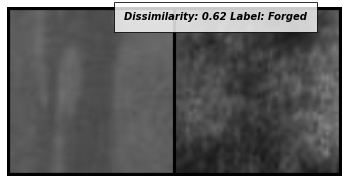

727 / 727
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_4.png',)]
/
_


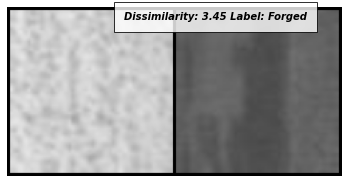

728 / 728
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_2.png',)]
/
_


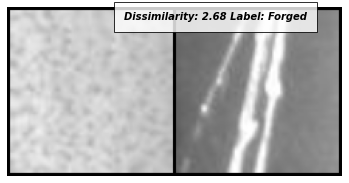

729 / 729
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_2.png',)]
/
_


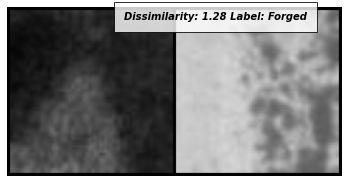

730 / 730
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',)]
/
/


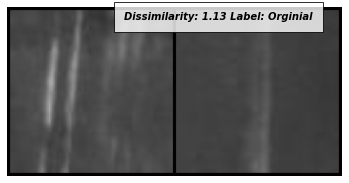

731 / 731
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_5.png',)]
/
_


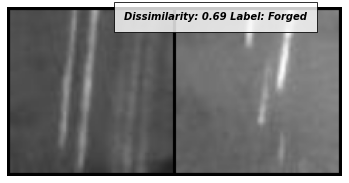

732 / 732
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',)]
/
/


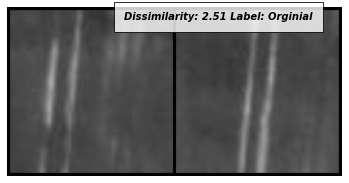

733 / 733
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_1.png',)]
/
_


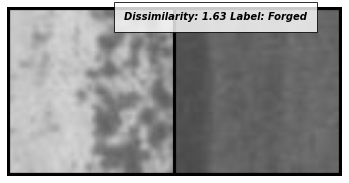

734 / 734
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_5.png',)]
/
_


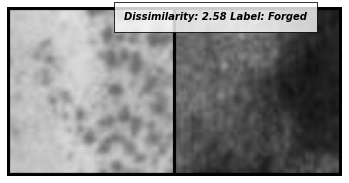

735 / 735
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',)]
/
/


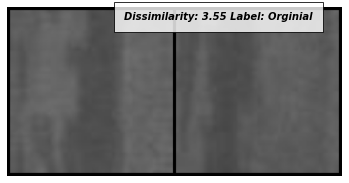

736 / 736
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_2.png',)]
/
_


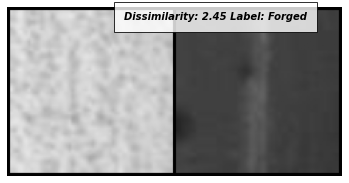

737 / 737
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_2.png',)]
/
_


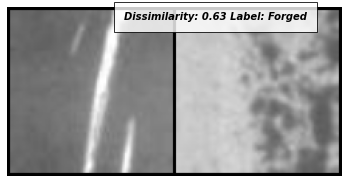

738 / 738
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_2.png',)]
/
_


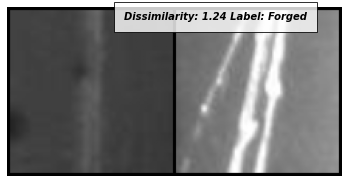

739 / 739
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_5.png',)]
/
_


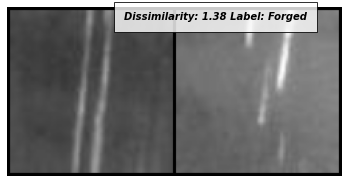

740 / 740
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_3.png',)]
/
_


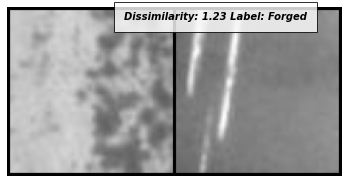

741 / 741
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_1.png',)]
/
_


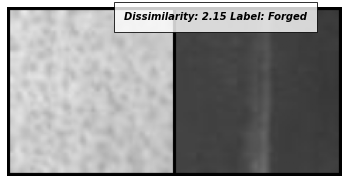

742 / 742
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_4.png',)]
/
_


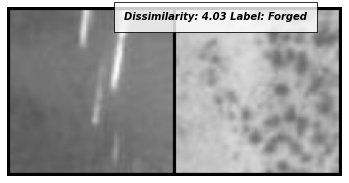

743 / 743
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_2.png',)]
/
_


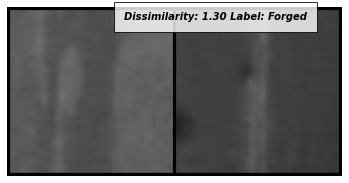

744 / 744
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_3.png',)]
/
_


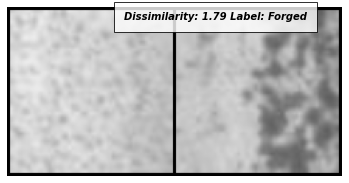

745 / 745
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_2.png',)]
/
_


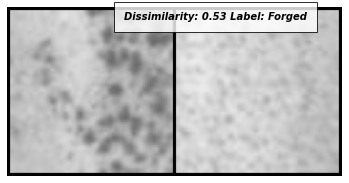

746 / 746
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_3.png',)]
/
_


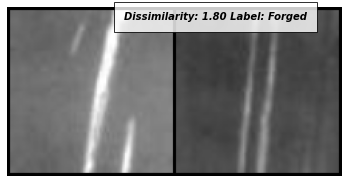

747 / 747
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_2.png',)]
/
_


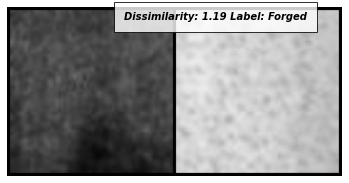

748 / 748
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_1.png',)]
/
_


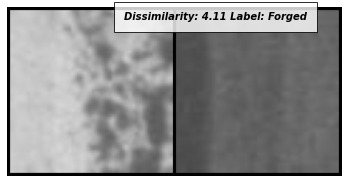

749 / 749
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_2.png',)]
/
_


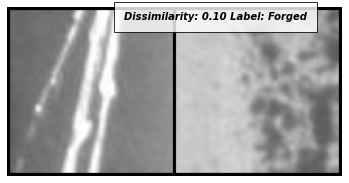

750 / 750
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_2.png',)]
/
_


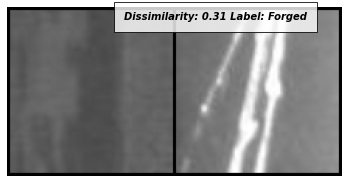

751 / 751
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_3.png',)]
/
_


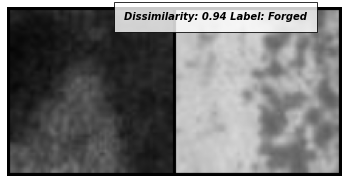

752 / 752
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_1.png',)]
/
_


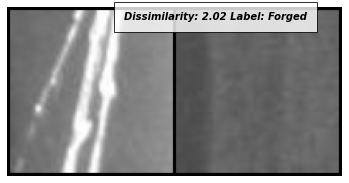

753 / 753
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_5.png',)]
/
_


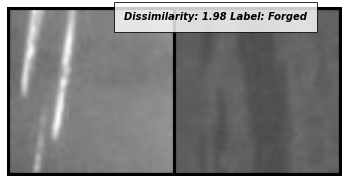

754 / 754
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_4.png',)]
/
_


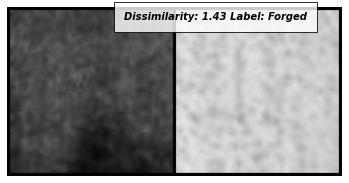

755 / 755
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_1.png',)]
/
_


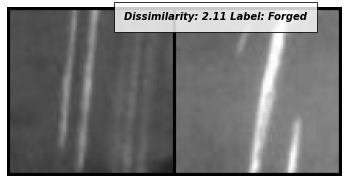

756 / 756
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_2.png',)]
/
_


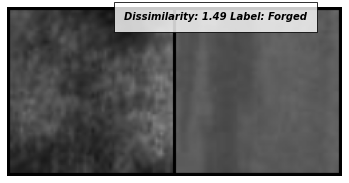

757 / 757
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_1.png',)]
/
_


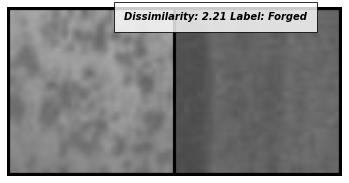

758 / 758
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_4.png',)]
/
_


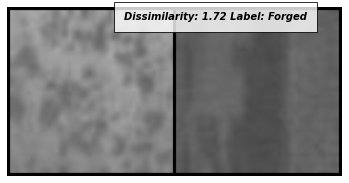

759 / 759
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_3.png',)]
/
_


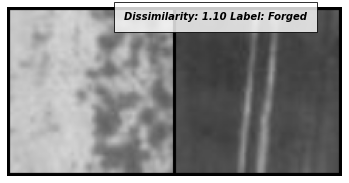

760 / 760
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_3.png',)]
/
_


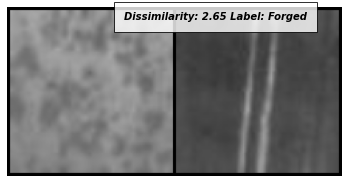

761 / 761
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',)]
/
/


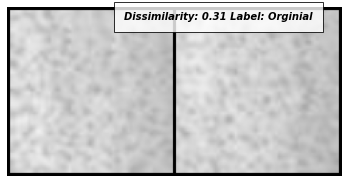

762 / 762
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_1.png',)]
/
_


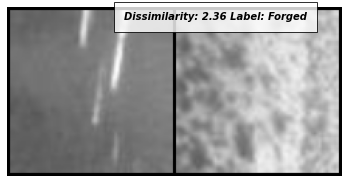

763 / 763
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_3.png',)]
/
_


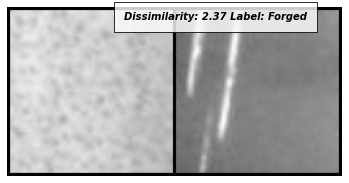

764 / 764
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_5.png',)]
/
_


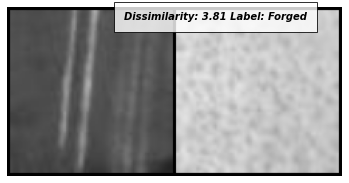

765 / 765
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_3.png',)]
/
_


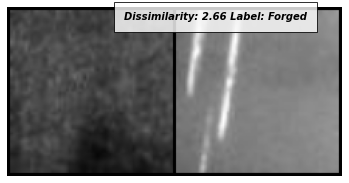

766 / 766
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_3.png',)]
/
_


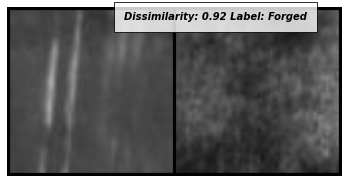

767 / 767
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',)]
/
/


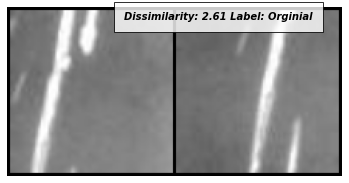

768 / 768
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_1.png',)]
/
_


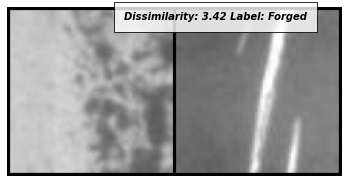

769 / 769
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_3.png',)]
/
_


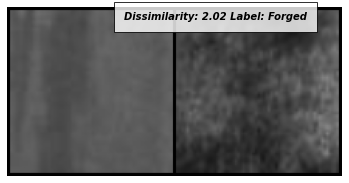

770 / 770
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_3.png',)]
/
_


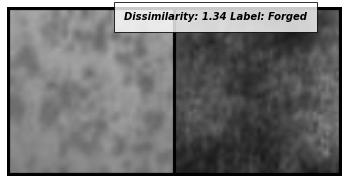

771 / 771
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_1.png',)]
/
_


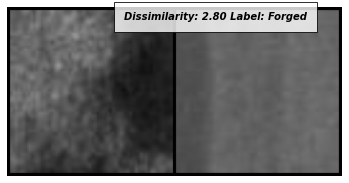

772 / 772
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_5.png',)]
/
_


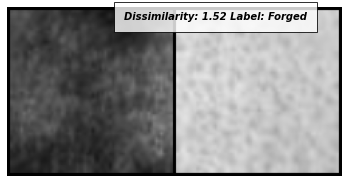

773 / 773
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_5.png',)]
/
_


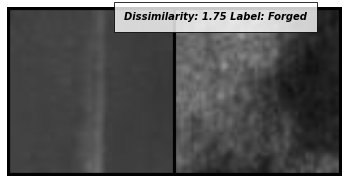

774 / 774
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_5.png',)]
/
_


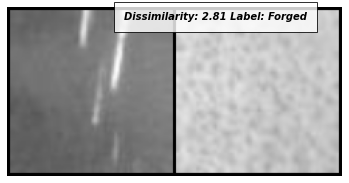

775 / 775
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_4.png',)]
/
_


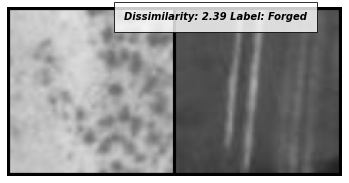

776 / 776
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_5.png',)]
/
_


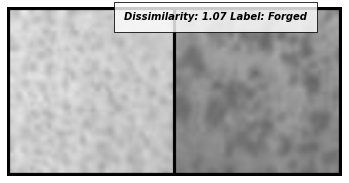

777 / 777
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_4.png',)]
/
_


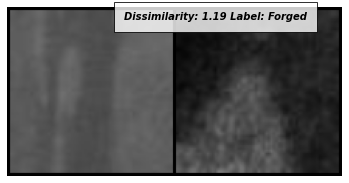

778 / 778
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_1.png',)]
/
_


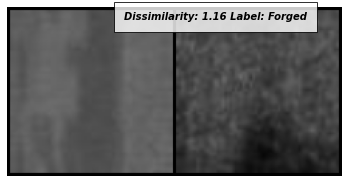

779 / 779
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_2.png',)]
/
/


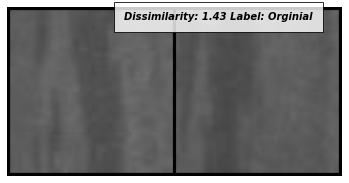

780 / 780
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_5.png',)]
/
_


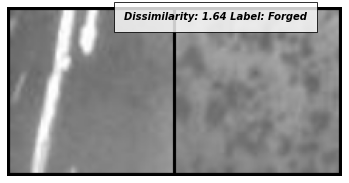

781 / 781
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_1.png',)]
/
_


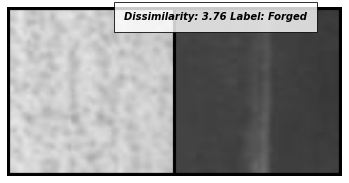

782 / 782
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',)]
/
/


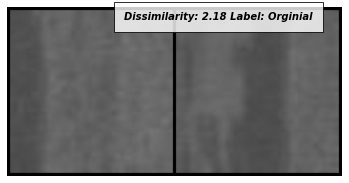

783 / 783
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_1.png',)]
/
_


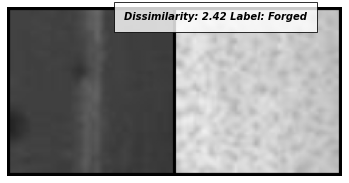

784 / 784
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_3.png',)]
/
_


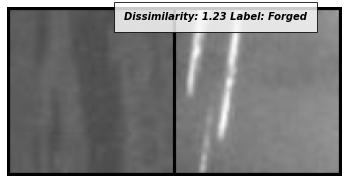

785 / 785
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/sp_2.png',)]
/
_


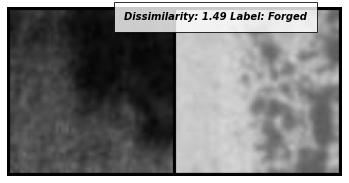

786 / 786
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_4.png',)]
/
_


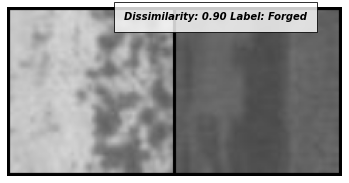

787 / 787
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_1.png',)]
/
_


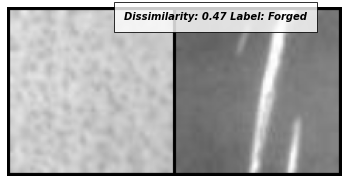

788 / 788
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_2.png',)]
/
_


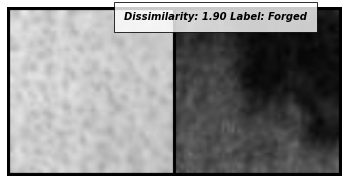

789 / 789
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_5.png',)]
/
_


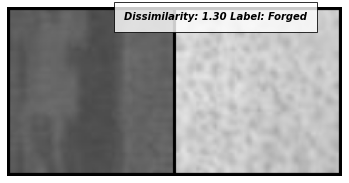

790 / 790
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_5.png',)]
/
_


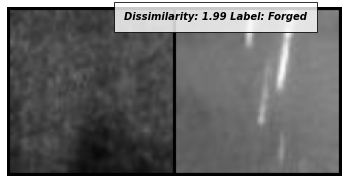

791 / 791
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',)]
/
/


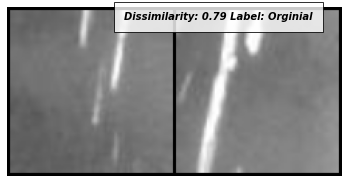

792 / 792
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',)]
/
/


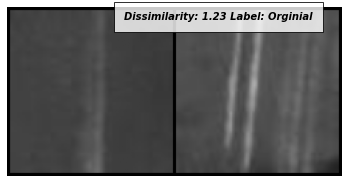

793 / 793
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',)]
/
/


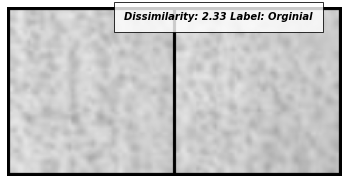

794 / 794
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_2.png',)]
/
_


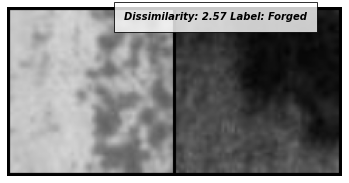

795 / 795
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_2.png',)]
/
_


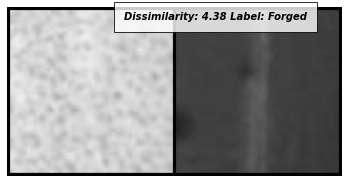

796 / 796
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/in_5.png',)]
/
_


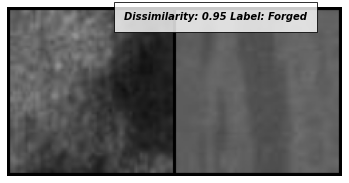

797 / 797
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_3.png',)]
/
_


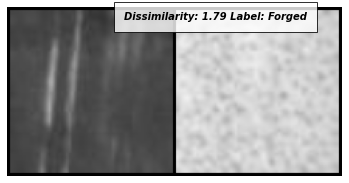

798 / 798
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_2.png',)]
/
_


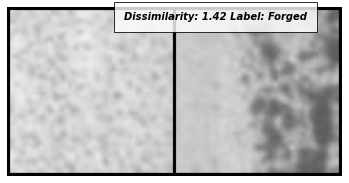

799 / 799
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_3.png',)]
/
_


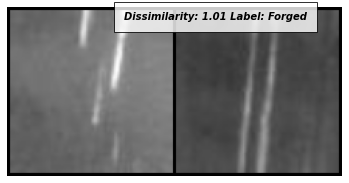

800 / 800
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_1.png',)]
/
_


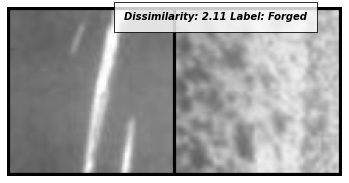

801 / 801
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_3.png',)]
/
_


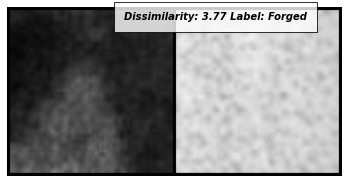

802 / 802
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_2.png',)]
/
_


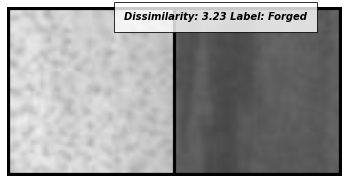

803 / 803
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_4.png',)]
/
_


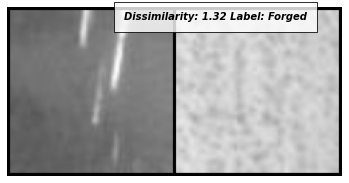

804 / 804
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_3.png',)]
/
_


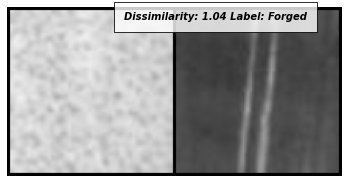

805 / 805
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_5.png',)]
/
_


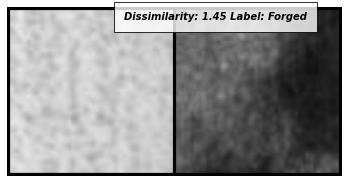

806 / 806
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_2.png',)]
/
_


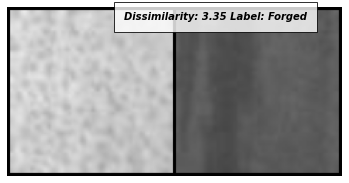

807 / 807
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_2.png',)]
/
_


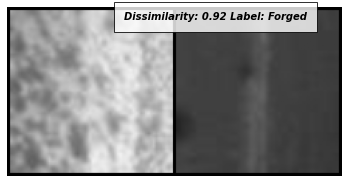

808 / 808
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_4.png',)]
/
_


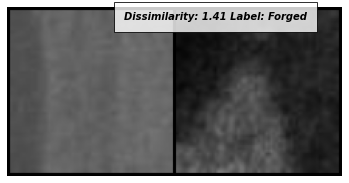

809 / 809
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_5.png',)]
/
_


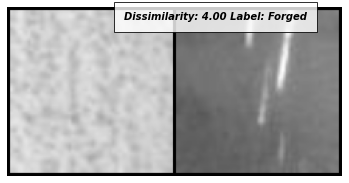

810 / 810
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_5.png',)]
/
_


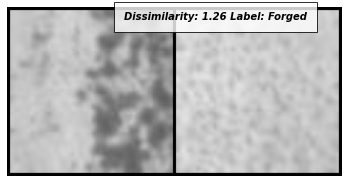

811 / 811
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/gg_2.png',)]
/
_


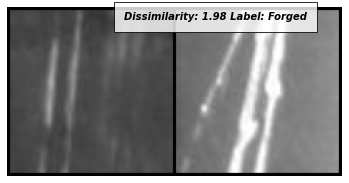

812 / 812
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',)]
/
/


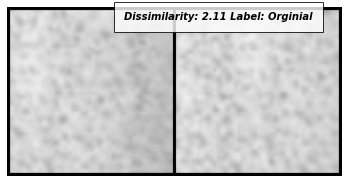

813 / 813
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/pa_5.png',)]
/
_


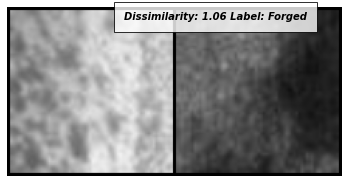

814 / 814
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/in_5.png',)]
/
_


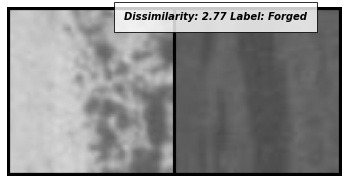

815 / 815
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/gg_5.png',)]
/
_


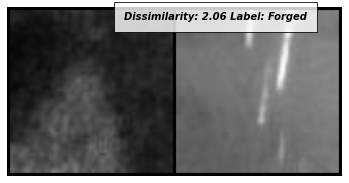

816 / 816
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_4.png',)]
/
_


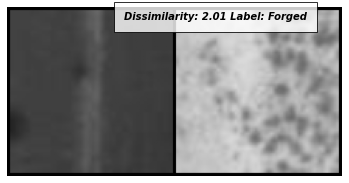

817 / 817
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_2.png',)]
/
_


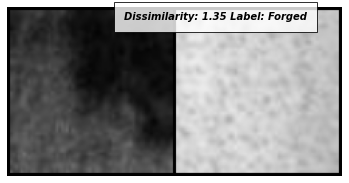

818 / 818
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_4.png',)]
/
_


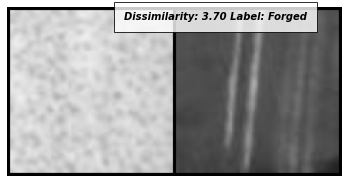

819 / 819
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_2.png',)]
/
_


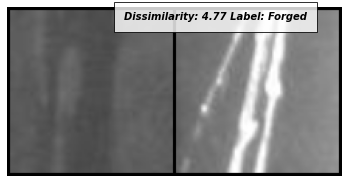

820 / 820
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_4.png',)]
/
_


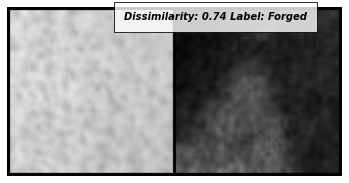

821 / 821
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_1.png',)]
/
_


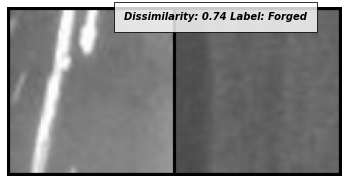

822 / 822
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_2.png',)]
/
_


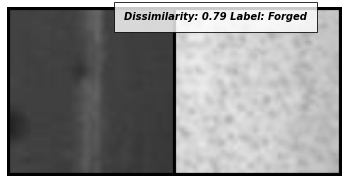

823 / 823
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',)]
/
/


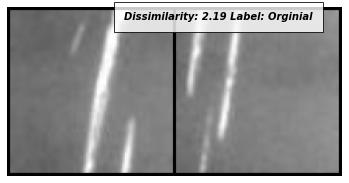

824 / 824
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_2.png',)]
/
_


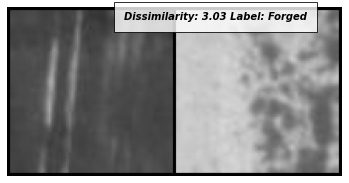

825 / 825
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/pa_2.png',)]
/
_


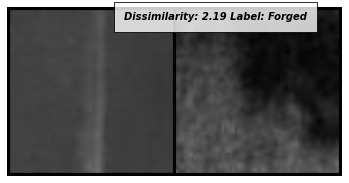

826 / 826
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_1.png',)]
/
_


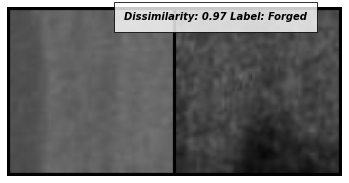

827 / 827
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',)]
/
/


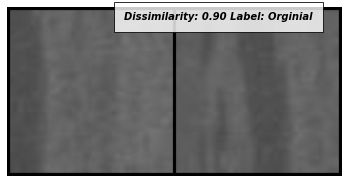

828 / 828
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_4.png',)]
/
_


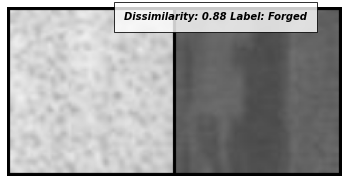

829 / 829
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_1.png',)]
/
_


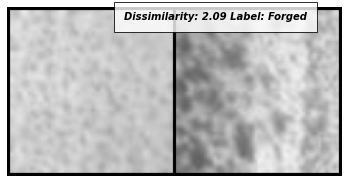

830 / 830
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_5.png',)]
/
_


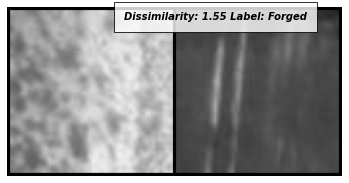

831 / 831
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_5.png',)]
/
_


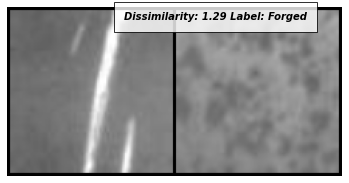

832 / 832
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_5.png',)]
/
_


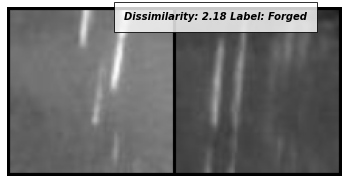

833 / 833
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/ps_5.png',)]
/
_


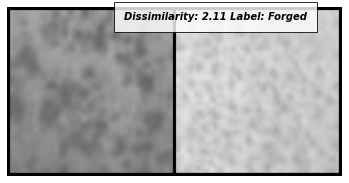

834 / 834
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_4.png',)]
/
_


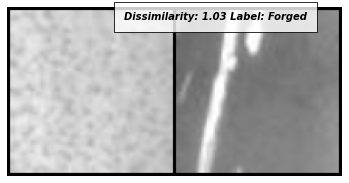

835 / 835
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_1.png',)]
/
_


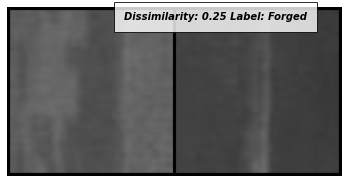

836 / 836
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_4.png',)]
/
_


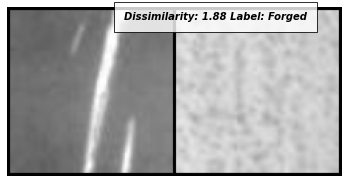

837 / 837
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa_forg/ps_1.png',)]
/
_


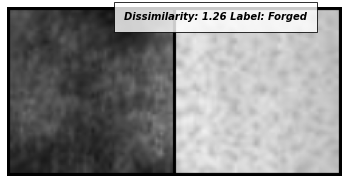

838 / 838
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sc_5.png',)]
/
_


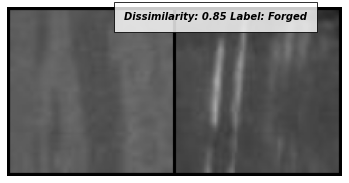

839 / 839
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/ps_3.png',)]
/
_


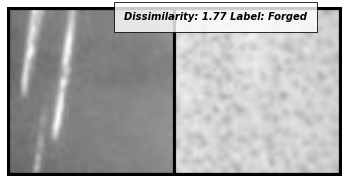

840 / 840
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/gg_5.png',)]
/
_


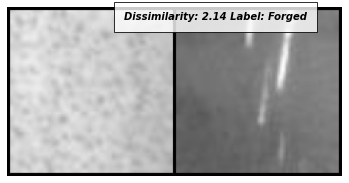

841 / 841
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/in_2.png',)]
/
_


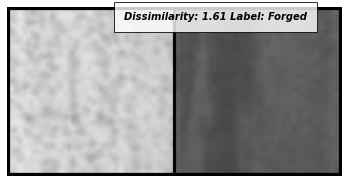

842 / 842
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_3.png',)]
/
_


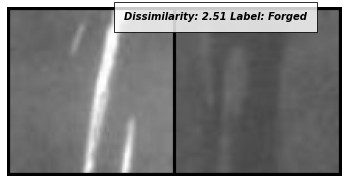

843 / 843
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',)]
/
/


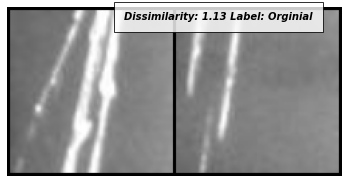

844 / 844
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sc_3.png',)]
/
_


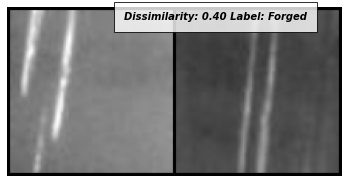

845 / 845
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',)]
/
/


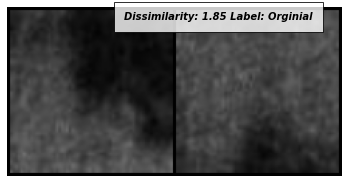

846 / 846
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/sp_1.png',)]
/
_


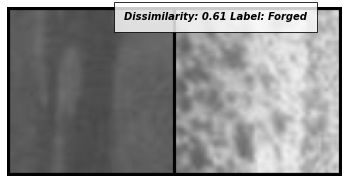

847 / 847
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/gg_4.png',)]
/
_


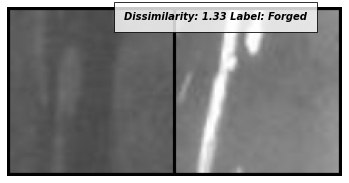

848 / 848
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_1.png',)]
/
_


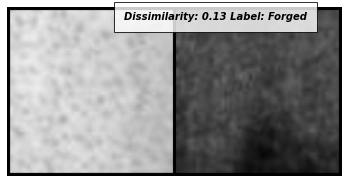

849 / 849
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_1.png',)]
/
_


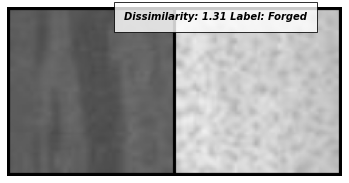

850 / 850
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_3.png',)]
/
/


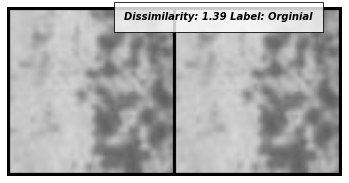

851 / 851
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/pa_1.png',)]
/
_


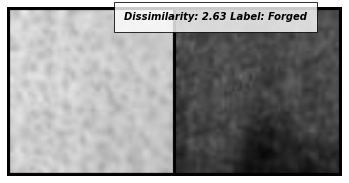

852 / 852
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_3.png',)]
/
_


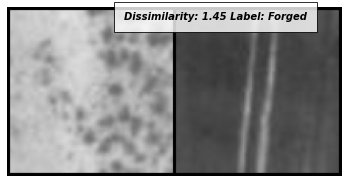

853 / 853
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/pa_3.png',)]
/
_


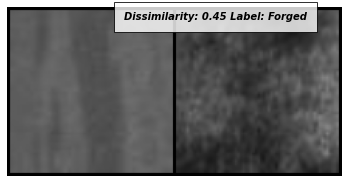

854 / 854
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/ps_5.png',)]
/
_


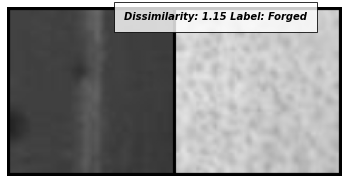

855 / 855
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/in_3.png',)]
/
_


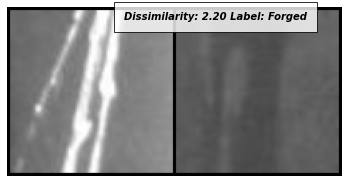

856 / 856
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/gg_4.png',)]
/
_


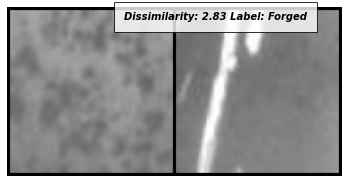

857 / 857
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_4.png',)]
/
/


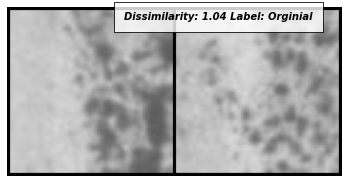

858 / 858
[('/content/drive/MyDrive/bu_son_olsun/test/sp/sp_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sp_forg/sc_2.png',)]
/
_


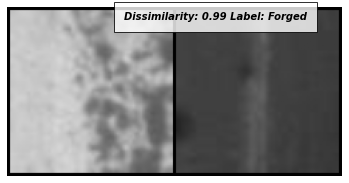

859 / 859
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sc_5.png',)]
/
_


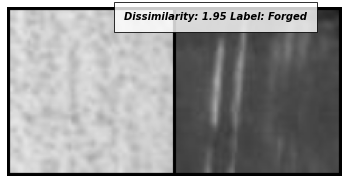

860 / 860
[('/content/drive/MyDrive/bu_son_olsun/test/in/in_1.png',), ('/content/drive/MyDrive/bu_son_olsun/test/in_forg/ps_5.png',)]
/
_


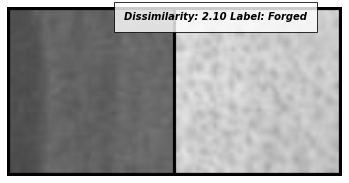

861 / 861
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/in_3.png',)]
/
_


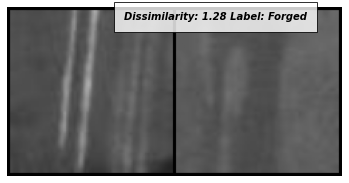

862 / 862
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/pa_5.png',)]
/
_


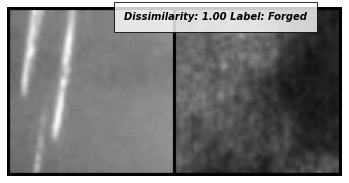

863 / 863
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_4.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',)]
/
/


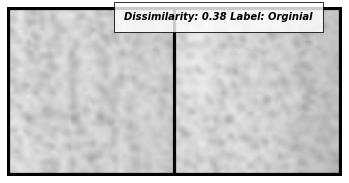

864 / 864
[('/content/drive/MyDrive/bu_son_olsun/test/sc/sc_5.png',), ('/content/drive/MyDrive/bu_son_olsun/test/sc_forg/sp_1.png',)]
/
_


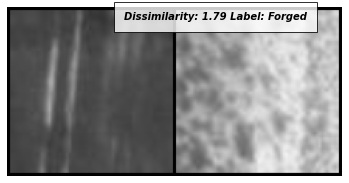

865 / 865
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_5.png',)]
/
/


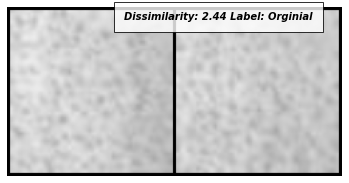

866 / 866
[('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/pa/pa_1.png',)]
/
/


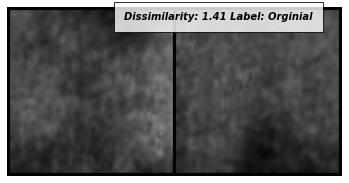

867 / 867
[('/content/drive/MyDrive/bu_son_olsun/test/ps/ps_3.png',), ('/content/drive/MyDrive/bu_son_olsun/test/ps_forg/sp_3.png',)]
/
_


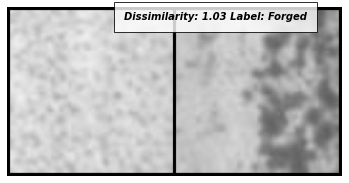

868 / 868
[('/content/drive/MyDrive/bu_son_olsun/test/gg/gg_2.png',), ('/content/drive/MyDrive/bu_son_olsun/test/gg_forg/sp_4.png',)]
/
_


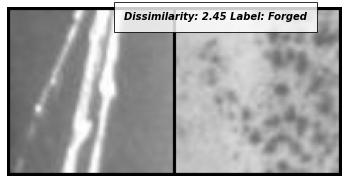

869 / 869


In [23]:
# Print the sample outputs to view its dissimilarity
counter=0
counter2=0
ttl=0
list_0 = torch.FloatTensor([[0]])
list_1 = torch.FloatTensor([[1]])
for i, data in enumerate(test_dataloader,0): 
  #print (i)
  #print (data)
  x0, x1 , label, directory = data
  print (directory)
  print (directory[0][0][43])
  print (directory[1][0][43])
  concatenated = torch.cat((x0,x1),0)
  output1,output2 = model(x0.to(device),x1.to(device))
  eucledian_distance = F.pairwise_distance(output1, output2)
  if label==list_0:
    label="Orginial"
    ttl=ttl+1
    if (directory[0][0][43])==(directory[1][0][43]):
      counter2=counter2+1
  else:
    label="Forged"
    ttl=ttl+1
    if (directory[0][0][43])!=(directory[1][0][43]):
      counter2=counter2+1
  imshow(torchvision.utils.make_grid(concatenated),'Dissimilarity: {:.2f} Label: {}'.format(eucledian_distance.item(),label))
  counter=counter+1
  #print (concatenated)
  #print(os.path.basename(test_dataset[0]))
  #from PIL import Image
  # Getting the filename of image
  #print("Filename : ",test_dataset[0].filename)
  #print (test_dataset)
  print (counter2,'/',ttl)

  #if counter ==50:
  #   break

In [24]:
print ('prediction score:',counter2/ttl)

prediction score: 1.0


In [25]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim


In [26]:
torch.cuda.device_count()

1

In [27]:
import socket
socket.gethostname()

'884bd8fa8534'

In [28]:
#correct = 0
#total = 0
# since we're not training, we don't need to calculate the gradients for our outputs
#with torch.no_grad():
#    for data in test_dataloader:
#        x0, x1 , label = data
        #device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        # calculate outputs by running images through the network
        
#        output1,output2 = model(x0.to('cuda'),x1.to('cuda'))
        # the class with the highest energy is what we choose as prediction
#        _, predicted = torch.max(output1.data, 1)
#        total += label.size(0)
#        correct += (predicted == label).sum().item()

#print('Accuracy of the network on the 10000 test images: %d %%' % (
#    100 * correct / total))